# Style Transfer CycleGAN

---
Author: Alex Navarro

Base: SIMPLE GAN colab 
Author: Albert Pumarola

DataSet Loader and Optimization step loop: Cycle GAN Horse2Zebra 
Author: Ramon Planas

In [0]:
%load_ext autoreload
%matplotlib inline
%autoreload 2

import os
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets, utils
from torch.utils.data import Dataset, DataLoader
from IPython.display import display
from PIL import Image
import numpy as np
import math

## Utils
Some utils with minor importance

In [0]:
def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1 or classname.find('BatchNorm') != -1:
        m.weight.data.normal_(0.00, 0.02)
  
def display_batch_images(img, imtype=np.uint8, unnormalize=True, nrows=None, mean=0.5, std=0.5):
    # select a sample or create grid if img is a batch
    if len(img.shape) == 4:
        nrows = nrows if nrows is not None else int(math.sqrt(img.size(0)))
        img = utils.make_grid(img, nrow=nrows)

    # unnormalize
    img = img.cpu().float()
    img = (img*std+mean)*255

    # to numpy
    image_numpy = img.numpy()
    image_numpy = np.transpose(image_numpy, (1, 2, 0))
    display(Image.fromarray(image_numpy.astype(imtype))) 

## Dataset
Download and prepare dataset


In [3]:
# Download horse2zebra
!mkdir -p ./datasets
!wget -N https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip -O ./datasets/horse2zebra.zip

# Unzip dataset
!unzip ./datasets/horse2zebra.zip -d ./datasets/

for details.

--2020-03-08 19:10:15--  https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.189.73
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.189.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 116867962 (111M) [application/zip]
Saving to: ‘./datasets/horse2zebra.zip’

./datasets/horse2ze 100%[===================>] 111.45M  20.7MB/s    in 6.3s    

2020-03-08 19:10:22 (17.6 MB/s) - ‘./datasets/horse2zebra.zip’ saved [116867962/116867962]

Archive:  ./datasets/horse2zebra.zip
replace ./datasets/horse2zebra/trainA/n02381460_6223.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: ./datasets/horse2zebra/trainA/n02381460_6223.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_1567.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_3354.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_299.jpg  
  inflat

**Generate Dataset class**

In [0]:
class Horse2ZebraDataset(Dataset):
  """
  Dataset class to load images
  """
  def __init__(self, root_dir, transform=None):
    """
    Args:
        root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
        on a sample.
    """
    self.root_dir = root_dir
    self.transform = transform
    self.list_images = os.listdir(self.root_dir)

  def __len__(self):
    return len(self.list_images)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
      idx = idx.tolist()

    img_name = os.path.join(self.root_dir, self.list_images[idx])
    image = Image.open(img_name)

    if self.transform:
      image = self.transform(image)

    return image

class TwoDatasets(Dataset):
  """
  Dataset class to get samples from two different image collections
  """
  def __init__(self, root_dirA, root_dirB, transform= None):
    self.root_dirA = root_dirA
    self.root_dirB = root_dirB
    self.filelistA = os.listdir(self.root_dirA)
    self.filelistB = os.listdir(self.root_dirB)
    self.transform=transform

  def __len__(self):
    return min(len(self.filelistA),len(self.filelistB))

  def __getitem__(self,idx):
    if torch.is_tensor(idx):
      idx = idx.tolist()

    img_nameA = os.path.join(self.root_dirA, self.filelistA[idx])
    img_nameB = os.path.join(self.root_dirB, self.filelistB[idx])

    imageA = Image.open(img_nameA).convert('RGB')
    imageB = Image.open(img_nameB).convert('RGB')

    if self.transform:
      imageA = self.transform(imageA)
      imageB = self.transform(imageB)

    return imageA, imageB


In [0]:
image_size = 128
tf = transforms.Compose(
    [transforms.Resize(image_size, interpolation=0),
     transforms.ToTensor(),
     transforms.Normalize((0.5,), (0.5,))]
    )

#horse2zebra_trainA = Horse2ZebraDataset(root_dir='./datasets/horse2zebra/trainA', transform=tf)
#horse2zebra_testA  = Horse2ZebraDataset(root_dir='./datasets/horse2zebra/testA', transform=tf)

#horse2zebra_trainB = Horse2ZebraDataset(root_dir='./datasets/horse2zebra/trainB', transform=tf)
#horse2zebra_testB  = Horse2ZebraDataset(root_dir='./datasets/horse2zebra/testB', transform=tf)

horse2zebra_train = TwoDatasets(root_dirA='./datasets/horse2zebra/trainA',root_dirB='./datasets/horse2zebra/trainB', transform=tf)
horse2zebra_test  = TwoDatasets(root_dirA='./datasets/horse2zebra/testA', root_dirB='./datasets/horse2zebra/testB',  transform=tf)

## Data Loader
Create data loaders for the horse2zebra dataset

In [0]:
batch_size = 1
#data_loader_trainA = torch.utils.data.DataLoader(horse2zebra_trainA, batch_size=batch_size, shuffle=True)
#data_loader_testA  = torch.utils.data.DataLoader(horse2zebra_testA,  batch_size=batch_size, shuffle=True)
#data_loader_trainB = torch.utils.data.DataLoader(horse2zebra_trainB, batch_size=batch_size, shuffle=True)
#data_loader_testB  = torch.utils.data.DataLoader(horse2zebra_testB,  batch_size=batch_size, shuffle=True)

data_loader_train = torch.utils.data.DataLoader(horse2zebra_train, batch_size=batch_size, shuffle=True)
data_loader_test  = torch.utils.data.DataLoader(horse2zebra_test,  batch_size=batch_size, shuffle=True)


Show some examples

1067
120


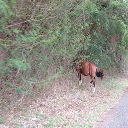

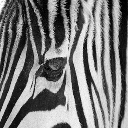

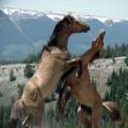

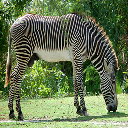

In [7]:
print(len(horse2zebra_train))
print(len(horse2zebra_test))

display_batch_images(horse2zebra_train[0][0])
display_batch_images(horse2zebra_train[0][1])
#
display_batch_images(horse2zebra_test[0][0])
display_batch_images(horse2zebra_test[0][1])

## Networks
First, lets define our simple generator

In [0]:
class Generator(torch.nn.Module):
    
    def __init__(self):
        super(Generator, self).__init__()

        # Encoder
        self._encoder1 = self.encoder(3, 64, 4)
        self._encoder2 = self.encoder(64, 128, 4)
        self._encoder3 = self.encoder(128, 256, 4)

        # Residual net
        self._res1 = self.residual(256, 256, 3)
        self._res2 = self.residual(256, 256, 3)
        self._res3 = self.residual(256, 256, 3)
        
        # Decoder
        self._decoder1 = self.decoder(256, 128, 4)
        self._decoder2 = self.decoder(128, 64, 4)
        self._decoder3 = self.decoder2(64, 3, 4)

    def encoder(self, i, o, dim):
        x = nn.Sequential(
            nn.Conv2d(i, o, dim, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(o),
            nn.LeakyReLU(0.2)
        )
        return x

    def residual(self, i, o, dim):
        x = nn.Sequential(
            nn.Conv2d(i, o, dim, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(o),
            nn.LeakyReLU(0.2),
            nn.Conv2d(i, o, dim, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(o),
            nn.LeakyReLU(0.2)
        )
        return x

    def decoder(self, i, o, dim):
        x = nn.Sequential(
            nn.ConvTranspose2d(i, o, dim, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(o),
            nn.ReLU()
        )
        return x

    def decoder2(self, i, o, dim): #Same as previous without normalization and changing Relu by Tanh
        x = nn.Sequential(
            nn.ConvTranspose2d(i, o, dim, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        return x   

    def forward(self, x):
        # Encode
        x = self._encoder1(x)
        x = self._encoder2(x)
        x = self._encoder3(x)

        # Resnet (the copy of the input take place here)
        a = self._res1(x)
        b = x + a
        c = self._res2(b)
        d = b + a 
        e = self._res3(d)
        x = d+ e
    
        # Decode
        x = self._decoder1(x)
        x = self._decoder2(x)
        x = self._decoder3(x)

        return x

Similarly lets define a simple discriminator

In [0]:
class Discriminator(torch.nn.Module):
    
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self._conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2)
        )
        self._conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2)
        )
        self._conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2)
        )
        
        self._fc = nn.Sequential(
            nn.Linear(int(512*image_size*image_size/(8*8)), 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Classify image as fake or real
        x = self._conv1(x)
        x = self._conv2(x)
        x = self._conv3(x)
        output = self._fc(x.view(-1, int(512*image_size*image_size/(8*8))))

        return output

## Model
Now lets create the core of our task, the model.

In [0]:
class Model:
    # --------------------------
    # -- PREPARE MODEL
    # --------------------------
    
    def __init__(self, batch_size):
        self._create_networks()
        self._create_optimizers()
        self._init_criterion(batch_size)
        
    def _create_networks(self):
        # create networks
        self._generatorA2B = Generator()
        self._generatorB2A = Generator()
        self._discriminatorA = Discriminator()
        self._discriminatorB = Discriminator()

        # init weights
        self._generatorA2B.apply(init_weights)
        self._generatorB2A.apply(init_weights)
        self._discriminatorA.apply(init_weights)
        self._discriminatorB.apply(init_weights)

        # move to cuda
        self._generatorA2B.cuda()
        self._generatorB2A.cuda()
        self._discriminatorA.cuda()
        self._discriminatorB.cuda()
        
    def _create_optimizers(self):
        # generators optimizers
        self._opt_genA2B = torch.optim.Adam(self._generatorA2B.parameters(), lr=0.0002, betas=(0.5, 0.999))
        self._opt_genB2A = torch.optim.Adam(self._generatorB2A.parameters(), lr=0.0002, betas=(0.5, 0.999))
        
        # discriminators optimizers
        self._opt_discrA = torch.optim.Adam(self._discriminatorA.parameters(), lr=0.0002, betas=(0.5, 0.999))
        self._opt_discrB = torch.optim.Adam(self._discriminatorB.parameters(), lr=0.0002, betas=(0.5, 0.999))
        
    def _init_criterion(self, batch_size):
        self._criterionGAN = nn.MSELoss()# To fight vanisshing gradients better MSELoss than BCELoss
        self._criterionCYC = nn.L1Loss()# L1 for Cycle Consistency Loss
        self._label_real = Variable(torch.ones(batch_size, 1)).cuda()
        self._label_fake = Variable(torch.zeros(batch_size, 1)).cuda()
        
    # --------------------------
    # -- Optimize Model
    # --------------------------
        
    def step_optimization(self, real_samplesA, real_samplesB, lambda_cyc):

        # Reset gradients
        self._opt_genA2B.zero_grad()
        self._opt_genB2A.zero_grad()
        self._opt_discrA.zero_grad()
        self._opt_discrB.zero_grad()

        # generate fake_samples
        fake_samplesA2B = self._generatorA2B(real_samplesA)
        fake_samplesB2A = self._generatorB2A(real_samplesB)

        cyc_samplesA = self._generatorB2A(fake_samplesA2B)
        cyc_samplesB = self._generatorA2B(fake_samplesB2A)

        #
        # optimize generator A2B & B2A
        #
        # discriminators are not updated
        for params in self._discriminatorA.parameters():
          params.requires_grad = False
        for params in self._discriminatorB.parameters():
          params.requires_grad = False

        estim_fakeA = self._discriminatorB(fake_samplesA2B)
        loss_gA = self._criterionGAN(estim_fakeA, self._label_real)
        estim_fakeB = self._discriminatorA(fake_samplesB2A)
        loss_gB = self._criterionGAN(estim_fakeB, self._label_real)
        #
        # Cycle loss
        #
        loss_cycA = self._criterionCYC(real_samplesA, cyc_samplesA)
        loss_cycB = self._criterionCYC(real_samplesB, cyc_samplesB)
        loss_cyc = loss_cycA + loss_cycB
        #
        loss_gA2B = loss_gA + lambda_cyc*loss_cyc
        loss_gB2A = loss_gB + lambda_cyc*loss_cyc
        #
        loss_gA2B.backward(retain_graph=True)
        loss_gB2A.backward(retain_graph=True)
        self._opt_genA2B.step()
        self._opt_genB2A.step()

        #
        # optimize discriminator A
        #
        for params in self._discriminatorA.parameters():
          params.requires_grad = True

        # Calculate discriminator A loss for real samples A
        estim_realA = self._discriminatorA(real_samplesA)
        loss_realA = self._criterionGAN(estim_realA, self._label_real)

        # Calculate discriminator A loss for fake samples B2A
        estim_fakeA = self._discriminatorA(fake_samplesB2A.detach())
        loss_fakeA = self._criterionGAN(estim_fakeA, self._label_fake)

        # Total discriminator loss
        loss_dA = (loss_realA + loss_fakeA) / 2
        loss_dA.backward()
        self._opt_discrA.step()
        
        #
        # optimize discriminator B
        #
        for params in self._discriminatorB.parameters():
          params.requires_grad = True

        # Calculate discriminator B loss for real samples B
        estim_realB = self._discriminatorB(real_samplesB)
        loss_realB = self._criterionGAN(estim_realB, self._label_real)

        # Calculate discriminator B loss for fake samples A2B
        estim_fakeB = self._discriminatorB(fake_samplesA2B.detach())
        loss_fakeB = self._criterionGAN(estim_fakeB, self._label_fake)

        # Total discriminator loss
        loss_dB = (loss_realB + loss_fakeB) / 2
        loss_dB.backward()
        self._opt_discrB.step()

        return loss_gA2B.item(), loss_gB2A.item(), loss_dA.item(), loss_dB.item(), loss_cyc.item()
             

## Train

In [0]:
num_epochs = 5000 #100
lambda_cyc = 5# 10
model = Model(batch_size)

epoch: 1/5000, batch: 0/1067, GA2B_loss: 5.444464206695557, GB2A_loss: 5.443569660186768
                             DA_loss: 0.2509729862213135, DB_loss: 0.25025656819343567, CYC_loss: 1.038702130317688


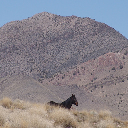

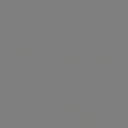

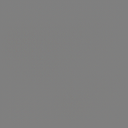

epoch: 1/5000, batch: 100/1067, GA2B_loss: 4.06092643737793, GB2A_loss: 3.957368850708008
                             DA_loss: 0.015230297110974789, DB_loss: 0.08992264419794083, CYC_loss: 0.651817798614502
epoch: 1/5000, batch: 200/1067, GA2B_loss: 4.258740425109863, GB2A_loss: 4.073789596557617
                             DA_loss: 0.040924180299043655, DB_loss: 0.008719312958419323, CYC_loss: 0.7009644508361816
epoch: 1/5000, batch: 300/1067, GA2B_loss: 4.214361190795898, GB2A_loss: 3.351289987564087
                             DA_loss: 0.29339534044265747, DB_loss: 0.037728168070316315, CYC_loss: 0.6578751802444458
epoch: 1/5000, batch: 400/1067, GA2B_loss: 4.465615272521973, GB2A_loss: 3.7039780616760254
                             DA_loss: 0.14372694492340088, DB_loss: 0.00023051115567795932, CYC_loss: 0.6977566480636597
epoch: 1/5000, batch: 500/1067, GA2B_loss: 4.197835922241211, GB2A_loss: 4.819382667541504
                             DA_loss: 0.03080003894865513, DB_loss:

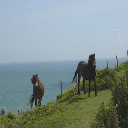

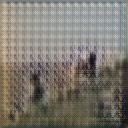

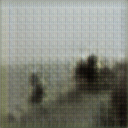

epoch: 2/5000, batch: 100/1067, GA2B_loss: 3.3805887699127197, GB2A_loss: 2.701767683029175
                             DA_loss: 0.18447595834732056, DB_loss: 0.004437967203557491, CYC_loss: 0.5084222555160522
epoch: 2/5000, batch: 200/1067, GA2B_loss: 2.7188429832458496, GB2A_loss: 3.1257901191711426
                             DA_loss: 0.12175145745277405, DB_loss: 0.1038440614938736, CYC_loss: 0.45976096391677856
epoch: 2/5000, batch: 300/1067, GA2B_loss: 3.5097596645355225, GB2A_loss: 2.847561836242676
                             DA_loss: 0.14835521578788757, DB_loss: 0.19733168184757233, CYC_loss: 0.5280399322509766
epoch: 2/5000, batch: 400/1067, GA2B_loss: 3.2437379360198975, GB2A_loss: 3.380268096923828
                             DA_loss: 0.4061388671398163, DB_loss: 0.008344341069459915, CYC_loss: 0.4970819056034088
epoch: 2/5000, batch: 500/1067, GA2B_loss: 3.6657767295837402, GB2A_loss: 3.4776463508605957
                             DA_loss: 0.3113481402397156, DB_loss

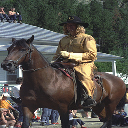

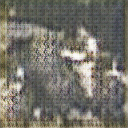

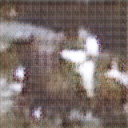

epoch: 3/5000, batch: 100/1067, GA2B_loss: 2.2910454273223877, GB2A_loss: 2.6430039405822754
                             DA_loss: 0.2551165521144867, DB_loss: 0.17928165197372437, CYC_loss: 0.4069485664367676
epoch: 3/5000, batch: 200/1067, GA2B_loss: 3.5536046028137207, GB2A_loss: 3.2813704013824463
                             DA_loss: 0.20299126207828522, DB_loss: 0.3217866122722626, CYC_loss: 0.5230340957641602
epoch: 3/5000, batch: 300/1067, GA2B_loss: 3.1489155292510986, GB2A_loss: 3.233804702758789
                             DA_loss: 0.014168414287269115, DB_loss: 0.007216168567538261, CYC_loss: 0.47389110922813416
epoch: 3/5000, batch: 400/1067, GA2B_loss: 4.184125900268555, GB2A_loss: 3.5792994499206543
                             DA_loss: 0.10820865631103516, DB_loss: 0.006944948807358742, CYC_loss: 0.6586569547653198
epoch: 3/5000, batch: 500/1067, GA2B_loss: 2.9455626010894775, GB2A_loss: 2.8724517822265625
                             DA_loss: 0.06314609944820404, DB_l

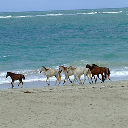

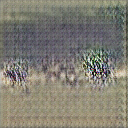

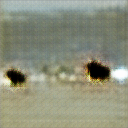

epoch: 4/5000, batch: 100/1067, GA2B_loss: 3.5752995014190674, GB2A_loss: 3.580049991607666
                             DA_loss: 0.033507056534290314, DB_loss: 0.016102513298392296, CYC_loss: 0.5409553050994873
epoch: 4/5000, batch: 200/1067, GA2B_loss: 3.2103939056396484, GB2A_loss: 3.3756368160247803
                             DA_loss: 0.005951390136033297, DB_loss: 0.008128159679472446, CYC_loss: 0.4887086749076843
epoch: 4/5000, batch: 300/1067, GA2B_loss: 3.0291733741760254, GB2A_loss: 2.44427490234375
                             DA_loss: 0.31307220458984375, DB_loss: 0.02436937391757965, CYC_loss: 0.4673658609390259
epoch: 4/5000, batch: 400/1067, GA2B_loss: 3.840841293334961, GB2A_loss: 3.880335569381714
                             DA_loss: 0.013083911500871181, DB_loss: 0.039425380527973175, CYC_loss: 0.588495671749115
epoch: 4/5000, batch: 500/1067, GA2B_loss: 5.390941619873047, GB2A_loss: 4.842905044555664
                             DA_loss: 0.0691441148519516, DB_loss

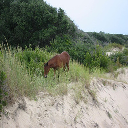

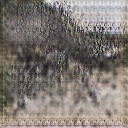

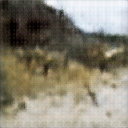

epoch: 5/5000, batch: 100/1067, GA2B_loss: 2.9561820030212402, GB2A_loss: 2.404327392578125
                             DA_loss: 0.14267824590206146, DB_loss: 0.0015047676861286163, CYC_loss: 0.41257333755493164
epoch: 5/5000, batch: 200/1067, GA2B_loss: 2.9564313888549805, GB2A_loss: 3.0664587020874023
                             DA_loss: 0.14085571467876434, DB_loss: 0.0383133627474308, CYC_loss: 0.45109498500823975
epoch: 5/5000, batch: 300/1067, GA2B_loss: 4.49365758895874, GB2A_loss: 4.007330894470215
                             DA_loss: 0.0525718629360199, DB_loss: 0.26343095302581787, CYC_loss: 0.7064359784126282
epoch: 5/5000, batch: 400/1067, GA2B_loss: 3.083425283432007, GB2A_loss: 2.997220516204834
                             DA_loss: 0.040205519646406174, DB_loss: 0.009322699159383774, CYC_loss: 0.44777411222457886
epoch: 5/5000, batch: 500/1067, GA2B_loss: 3.4188876152038574, GB2A_loss: 2.9795680046081543
                             DA_loss: 0.184218168258667, DB_loss

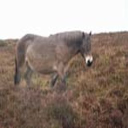

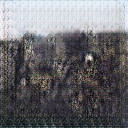

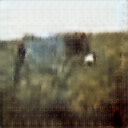

epoch: 6/5000, batch: 100/1067, GA2B_loss: 2.7810733318328857, GB2A_loss: 2.8458733558654785
                             DA_loss: 0.04007207229733467, DB_loss: 0.011658553034067154, CYC_loss: 0.4095403552055359
epoch: 6/5000, batch: 200/1067, GA2B_loss: 3.360888957977295, GB2A_loss: 2.7732646465301514
                             DA_loss: 0.07233534753322601, DB_loss: 0.0015186413656920195, CYC_loss: 0.4768877625465393
epoch: 6/5000, batch: 300/1067, GA2B_loss: 3.0690665245056152, GB2A_loss: 2.484074115753174
                             DA_loss: 0.06843756884336472, DB_loss: 0.11775407195091248, CYC_loss: 0.41715073585510254
epoch: 6/5000, batch: 400/1067, GA2B_loss: 3.6441924571990967, GB2A_loss: 3.5575613975524902
                             DA_loss: 0.019056275486946106, DB_loss: 0.011923469603061676, CYC_loss: 0.5715880393981934
epoch: 6/5000, batch: 500/1067, GA2B_loss: 3.273674964904785, GB2A_loss: 2.5276706218719482
                             DA_loss: 0.449993759393692, DB_

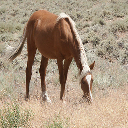

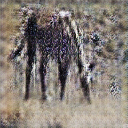

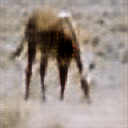

epoch: 7/5000, batch: 100/1067, GA2B_loss: 2.7006359100341797, GB2A_loss: 2.8012516498565674
                             DA_loss: 0.01562671549618244, DB_loss: 0.10788605362176895, CYC_loss: 0.37141746282577515
epoch: 7/5000, batch: 200/1067, GA2B_loss: 3.7300937175750732, GB2A_loss: 3.302441120147705
                             DA_loss: 0.04482067748904228, DB_loss: 0.0012509179068729281, CYC_loss: 0.5496600866317749
epoch: 7/5000, batch: 300/1067, GA2B_loss: 2.6889374256134033, GB2A_loss: 3.300159215927124
                             DA_loss: 0.009071710519492626, DB_loss: 0.09464748948812485, CYC_loss: 0.47390446066856384
epoch: 7/5000, batch: 400/1067, GA2B_loss: 2.6058149337768555, GB2A_loss: 1.9618970155715942
                             DA_loss: 0.2418203055858612, DB_loss: 0.020541492849588394, CYC_loss: 0.3738273084163666
epoch: 7/5000, batch: 500/1067, GA2B_loss: 3.3666296005249023, GB2A_loss: 3.339179515838623
                             DA_loss: 0.014092955738306046, D

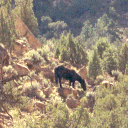

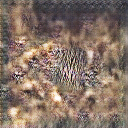

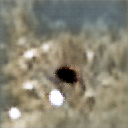

epoch: 8/5000, batch: 100/1067, GA2B_loss: 3.2248709201812744, GB2A_loss: 3.3007376194000244
                             DA_loss: 0.02134518325328827, DB_loss: 0.034261416643857956, CYC_loss: 0.5342392325401306
epoch: 8/5000, batch: 200/1067, GA2B_loss: 2.5413997173309326, GB2A_loss: 2.475440502166748
                             DA_loss: 0.009011211805045605, DB_loss: 0.006248445715755224, CYC_loss: 0.34365543723106384
epoch: 8/5000, batch: 300/1067, GA2B_loss: 3.06182599067688, GB2A_loss: 3.3055970668792725
                             DA_loss: 0.06924634426832199, DB_loss: 0.034067220985889435, CYC_loss: 0.5031200051307678
epoch: 8/5000, batch: 400/1067, GA2B_loss: 2.8891725540161133, GB2A_loss: 2.9666357040405273
                             DA_loss: 0.06677122414112091, DB_loss: 0.07677753269672394, CYC_loss: 0.49929511547088623
epoch: 8/5000, batch: 500/1067, GA2B_loss: 3.112485885620117, GB2A_loss: 3.3137969970703125
                             DA_loss: 0.1723312884569168, DB_

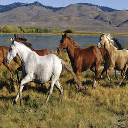

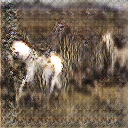

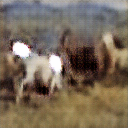

epoch: 9/5000, batch: 100/1067, GA2B_loss: 3.0543036460876465, GB2A_loss: 2.4639246463775635
                             DA_loss: 0.08482803404331207, DB_loss: 0.03378118574619293, CYC_loss: 0.4210323691368103
epoch: 9/5000, batch: 200/1067, GA2B_loss: 3.2529232501983643, GB2A_loss: 3.2062907218933105
                             DA_loss: 0.07512076199054718, DB_loss: 0.01294119842350483, CYC_loss: 0.5057148337364197
epoch: 9/5000, batch: 300/1067, GA2B_loss: 2.835444688796997, GB2A_loss: 2.6794111728668213
                             DA_loss: 0.09825751185417175, DB_loss: 0.050816670060157776, CYC_loss: 0.4738314747810364
epoch: 9/5000, batch: 400/1067, GA2B_loss: 2.415482997894287, GB2A_loss: 2.0329532623291016
                             DA_loss: 0.21067942678928375, DB_loss: 0.041737012565135956, CYC_loss: 0.38195422291755676
epoch: 9/5000, batch: 500/1067, GA2B_loss: 3.5665667057037354, GB2A_loss: 3.552307605743408
                             DA_loss: 0.002269393065944314, DB_

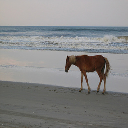

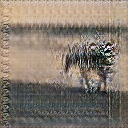

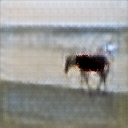

epoch: 10/5000, batch: 100/1067, GA2B_loss: 2.9463164806365967, GB2A_loss: 2.1317052841186523
                             DA_loss: 0.3301774859428406, DB_loss: 0.022245414555072784, CYC_loss: 0.39479807019233704
epoch: 10/5000, batch: 200/1067, GA2B_loss: 4.032960414886475, GB2A_loss: 3.784963369369507
                             DA_loss: 0.009358932264149189, DB_loss: 0.002708572195842862, CYC_loss: 0.607685387134552
epoch: 10/5000, batch: 300/1067, GA2B_loss: 2.970804452896118, GB2A_loss: 2.9218106269836426
                             DA_loss: 0.013059795834124088, DB_loss: 0.00642981706187129, CYC_loss: 0.39845603704452515
epoch: 10/5000, batch: 400/1067, GA2B_loss: 2.8937976360321045, GB2A_loss: 2.844503879547119
                             DA_loss: 0.15408998727798462, DB_loss: 9.85700316959992e-05, CYC_loss: 0.3839963972568512
epoch: 10/5000, batch: 500/1067, GA2B_loss: 3.6417601108551025, GB2A_loss: 3.639052629470825
                             DA_loss: 0.003415424842387438

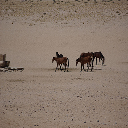

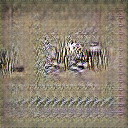

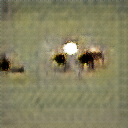

epoch: 11/5000, batch: 100/1067, GA2B_loss: 3.034702777862549, GB2A_loss: 2.128664970397949
                             DA_loss: 0.2662436366081238, DB_loss: 0.008905581198632717, CYC_loss: 0.4111044108867645
epoch: 11/5000, batch: 200/1067, GA2B_loss: 1.8301026821136475, GB2A_loss: 2.342460870742798
                             DA_loss: 0.010589874349534512, DB_loss: 0.12826234102249146, CYC_loss: 0.31727173924446106
epoch: 11/5000, batch: 300/1067, GA2B_loss: 3.7094058990478516, GB2A_loss: 3.6211376190185547
                             DA_loss: 0.03121444210410118, DB_loss: 0.15355418622493744, CYC_loss: 0.5501856803894043
epoch: 11/5000, batch: 400/1067, GA2B_loss: 2.9417412281036377, GB2A_loss: 2.864109992980957
                             DA_loss: 0.19766514003276825, DB_loss: 0.0005721479537896812, CYC_loss: 0.39204877614974976
epoch: 11/5000, batch: 500/1067, GA2B_loss: 3.5435988903045654, GB2A_loss: 2.744450807571411
                             DA_loss: 0.15492334961891174,

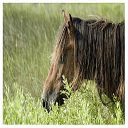

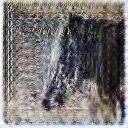

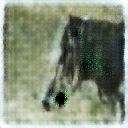

epoch: 12/5000, batch: 100/1067, GA2B_loss: 2.589444160461426, GB2A_loss: 2.0872926712036133
                             DA_loss: 0.057073984295129776, DB_loss: 0.012366103008389473, CYC_loss: 0.32871389389038086
epoch: 12/5000, batch: 200/1067, GA2B_loss: 3.091099977493286, GB2A_loss: 2.2176191806793213
                             DA_loss: 0.2710835635662079, DB_loss: 0.0004830826073884964, CYC_loss: 0.42961782217025757
epoch: 12/5000, batch: 300/1067, GA2B_loss: 3.1140737533569336, GB2A_loss: 2.6821184158325195
                             DA_loss: 0.05036585405468941, DB_loss: 0.021310240030288696, CYC_loss: 0.43843328952789307
epoch: 12/5000, batch: 400/1067, GA2B_loss: 2.4671905040740967, GB2A_loss: 2.855699062347412
                             DA_loss: 0.3702932894229889, DB_loss: 0.03183013200759888, CYC_loss: 0.3813808262348175
epoch: 12/5000, batch: 500/1067, GA2B_loss: 2.909189224243164, GB2A_loss: 2.7297422885894775
                             DA_loss: 0.0125357378274202

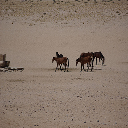

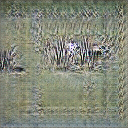

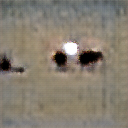

epoch: 13/5000, batch: 100/1067, GA2B_loss: 3.1037940979003906, GB2A_loss: 3.550381898880005
                             DA_loss: 0.008705796673893929, DB_loss: 0.04191586747765541, CYC_loss: 0.5196177363395691
epoch: 13/5000, batch: 200/1067, GA2B_loss: 2.4256222248077393, GB2A_loss: 2.009917736053467
                             DA_loss: 0.2008403092622757, DB_loss: 0.03250570967793465, CYC_loss: 0.374025821685791
epoch: 13/5000, batch: 300/1067, GA2B_loss: 2.743333339691162, GB2A_loss: 2.7142202854156494
                             DA_loss: 0.0012026194017380476, DB_loss: 0.0016332914819940925, CYC_loss: 0.3578408360481262
epoch: 13/5000, batch: 400/1067, GA2B_loss: 2.488211154937744, GB2A_loss: 2.527320384979248
                             DA_loss: 0.00011720405746018514, DB_loss: 0.023396942764520645, CYC_loss: 0.3115169405937195
epoch: 13/5000, batch: 500/1067, GA2B_loss: 2.6689717769622803, GB2A_loss: 3.1049611568450928
                             DA_loss: 0.0074729928746819

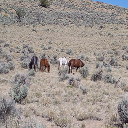

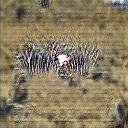

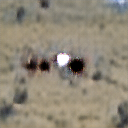

epoch: 14/5000, batch: 100/1067, GA2B_loss: 2.7518539428710938, GB2A_loss: 2.9150383472442627
                             DA_loss: 0.0006411034846678376, DB_loss: 0.007551135495305061, CYC_loss: 0.39650678634643555
epoch: 14/5000, batch: 200/1067, GA2B_loss: 3.098944902420044, GB2A_loss: 3.2114219665527344
                             DA_loss: 0.00260689714923501, DB_loss: 0.003298737108707428, CYC_loss: 0.45095932483673096
epoch: 14/5000, batch: 300/1067, GA2B_loss: 2.947195291519165, GB2A_loss: 2.951212167739868
                             DA_loss: 0.0033938942942768335, DB_loss: 0.01610860973596573, CYC_loss: 0.3936648964881897
epoch: 14/5000, batch: 400/1067, GA2B_loss: 2.971217632293701, GB2A_loss: 2.488471746444702
                             DA_loss: 0.07045625150203705, DB_loss: 0.00016037907334975898, CYC_loss: 0.4006562829017639
epoch: 14/5000, batch: 500/1067, GA2B_loss: 2.8889319896698, GB2A_loss: 2.622499942779541
                             DA_loss: 0.137051522731781,

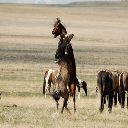

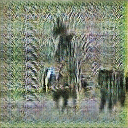

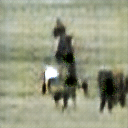

epoch: 15/5000, batch: 100/1067, GA2B_loss: 2.7830746173858643, GB2A_loss: 2.681281328201294
                             DA_loss: 0.0016597795765846968, DB_loss: 2.701495759538375e-05, CYC_loss: 0.358623743057251
epoch: 15/5000, batch: 200/1067, GA2B_loss: 2.780933141708374, GB2A_loss: 2.7288360595703125
                             DA_loss: 0.053164683282375336, DB_loss: 6.27835834166035e-05, CYC_loss: 0.3595088720321655
epoch: 15/5000, batch: 300/1067, GA2B_loss: 2.730592966079712, GB2A_loss: 2.7005553245544434
                             DA_loss: 0.0008221928728744388, DB_loss: 1.2665821031987434e-06, CYC_loss: 0.34643226861953735
epoch: 15/5000, batch: 400/1067, GA2B_loss: 3.011117458343506, GB2A_loss: 2.996983289718628
                             DA_loss: 0.028759602457284927, DB_loss: 0.005853841546922922, CYC_loss: 0.40298721194267273
epoch: 15/5000, batch: 500/1067, GA2B_loss: 2.9573066234588623, GB2A_loss: 2.9532103538513184
                             DA_loss: 0.095804207

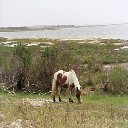

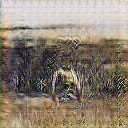

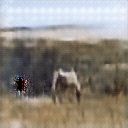

epoch: 16/5000, batch: 100/1067, GA2B_loss: 3.1959986686706543, GB2A_loss: 3.255094528198242
                             DA_loss: 1.4573925909644458e-05, DB_loss: 0.019538555294275284, CYC_loss: 0.45316946506500244
epoch: 16/5000, batch: 200/1067, GA2B_loss: 3.5966908931732178, GB2A_loss: 2.9372870922088623
                             DA_loss: 0.11556283384561539, DB_loss: 0.10225848108530045, CYC_loss: 0.533504843711853
epoch: 16/5000, batch: 300/1067, GA2B_loss: 2.6469759941101074, GB2A_loss: 2.1289167404174805
                             DA_loss: 0.08210630714893341, DB_loss: 0.004454793408513069, CYC_loss: 0.35292544960975647
epoch: 16/5000, batch: 400/1067, GA2B_loss: 2.8514742851257324, GB2A_loss: 2.7620058059692383
                             DA_loss: 0.0023466881830245256, DB_loss: 0.00016646937001496553, CYC_loss: 0.3749716877937317
epoch: 16/5000, batch: 500/1067, GA2B_loss: 3.1239206790924072, GB2A_loss: 3.0732269287109375
                             DA_loss: 0.00075152

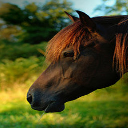

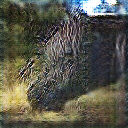

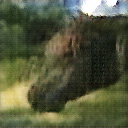

epoch: 17/5000, batch: 100/1067, GA2B_loss: 2.671886444091797, GB2A_loss: 2.7693042755126953
                             DA_loss: 0.00012726277054753155, DB_loss: 0.0013969020219519734, CYC_loss: 0.3548450767993927
epoch: 17/5000, batch: 200/1067, GA2B_loss: 2.5970077514648438, GB2A_loss: 2.539154529571533
                             DA_loss: 0.008261565119028091, DB_loss: 0.0036931168287992477, CYC_loss: 0.31945323944091797
epoch: 17/5000, batch: 300/1067, GA2B_loss: 2.932018995285034, GB2A_loss: 2.8595004081726074
                             DA_loss: 0.015606925822794437, DB_loss: 0.0051462966948747635, CYC_loss: 0.38830459117889404
epoch: 17/5000, batch: 400/1067, GA2B_loss: 2.6661205291748047, GB2A_loss: 2.806474208831787
                             DA_loss: 1.5715922927483916e-05, DB_loss: 0.003500801045447588, CYC_loss: 0.36346685886383057
epoch: 17/5000, batch: 500/1067, GA2B_loss: 2.8473711013793945, GB2A_loss: 2.9169626235961914
                             DA_loss: 0.0091

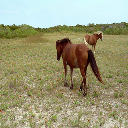

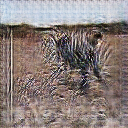

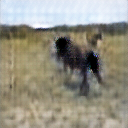

epoch: 18/5000, batch: 100/1067, GA2B_loss: 3.459616184234619, GB2A_loss: 3.3808395862579346
                             DA_loss: 0.0008594000828452408, DB_loss: 0.11565932631492615, CYC_loss: 0.49228358268737793
epoch: 18/5000, batch: 200/1067, GA2B_loss: 2.137176990509033, GB2A_loss: 2.0116350650787354
                             DA_loss: 0.027450991794466972, DB_loss: 0.013121937401592731, CYC_loss: 0.28507110476493835
epoch: 18/5000, batch: 300/1067, GA2B_loss: 2.9627397060394287, GB2A_loss: 2.9667816162109375
                             DA_loss: 0.20619188249111176, DB_loss: 6.497139111161232e-06, CYC_loss: 0.3935178816318512
epoch: 18/5000, batch: 400/1067, GA2B_loss: 2.5628786087036133, GB2A_loss: 2.6369991302490234
                             DA_loss: 0.002327490132302046, DB_loss: 0.0016098447376862168, CYC_loss: 0.33462217450141907
epoch: 18/5000, batch: 500/1067, GA2B_loss: 2.4370625019073486, GB2A_loss: 2.535125494003296
                             DA_loss: 0.093547925

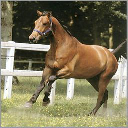

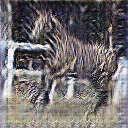

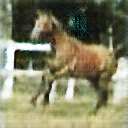

epoch: 19/5000, batch: 100/1067, GA2B_loss: 3.0819244384765625, GB2A_loss: 2.8153562545776367
                             DA_loss: 0.018253006041049957, DB_loss: 0.000832627818454057, CYC_loss: 0.4321227967739105
epoch: 19/5000, batch: 200/1067, GA2B_loss: 2.723127603530884, GB2A_loss: 2.718250036239624
                             DA_loss: 1.4811012079007924e-05, DB_loss: 0.0008118440746329725, CYC_loss: 0.3458166718482971
epoch: 19/5000, batch: 300/1067, GA2B_loss: 2.6089706420898438, GB2A_loss: 2.430124521255493
                             DA_loss: 0.23401379585266113, DB_loss: 0.004901062697172165, CYC_loss: 0.33092033863067627
epoch: 19/5000, batch: 400/1067, GA2B_loss: 2.8487935066223145, GB2A_loss: 1.9735913276672363
                             DA_loss: 0.2300984412431717, DB_loss: 0.15746673941612244, CYC_loss: 0.3740239441394806
epoch: 19/5000, batch: 500/1067, GA2B_loss: 3.072442054748535, GB2A_loss: 3.101320505142212
                             DA_loss: 0.114856392145156

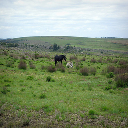

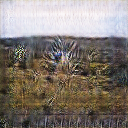

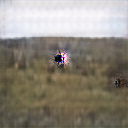

epoch: 20/5000, batch: 100/1067, GA2B_loss: 2.733203411102295, GB2A_loss: 2.064344882965088
                             DA_loss: 0.15567442774772644, DB_loss: 0.0026664508040994406, CYC_loss: 0.37376242876052856
epoch: 20/5000, batch: 200/1067, GA2B_loss: 2.997934341430664, GB2A_loss: 2.88222074508667
                             DA_loss: 0.008628062903881073, DB_loss: 1.690970384515822e-05, CYC_loss: 0.4006460905075073
epoch: 20/5000, batch: 300/1067, GA2B_loss: 2.5527868270874023, GB2A_loss: 2.4988584518432617
                             DA_loss: 0.032436080276966095, DB_loss: 0.0002482391137164086, CYC_loss: 0.3115915060043335
epoch: 20/5000, batch: 400/1067, GA2B_loss: 2.9321115016937256, GB2A_loss: 2.956099510192871
                             DA_loss: 0.002076070988550782, DB_loss: 0.017516199499368668, CYC_loss: 0.4044000506401062
epoch: 20/5000, batch: 500/1067, GA2B_loss: 2.869901180267334, GB2A_loss: 2.3711886405944824
                             DA_loss: 0.06880787760019

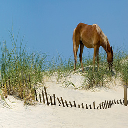

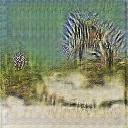

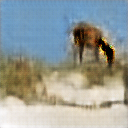

epoch: 21/5000, batch: 100/1067, GA2B_loss: 3.0815443992614746, GB2A_loss: 2.405637264251709
                             DA_loss: 0.10494589805603027, DB_loss: 0.017863936722278595, CYC_loss: 0.42096900939941406
epoch: 21/5000, batch: 200/1067, GA2B_loss: 2.5556576251983643, GB2A_loss: 3.200286626815796
                             DA_loss: 0.021251212805509567, DB_loss: 0.08351514488458633, CYC_loss: 0.44119542837142944
epoch: 21/5000, batch: 300/1067, GA2B_loss: 3.220069408416748, GB2A_loss: 3.2081496715545654
                             DA_loss: 4.646099841920659e-05, DB_loss: 5.307484570948873e-06, CYC_loss: 0.4449755549430847
epoch: 21/5000, batch: 400/1067, GA2B_loss: 2.6527822017669678, GB2A_loss: 2.6376543045043945
                             DA_loss: 0.00010708672925829887, DB_loss: 1.8072187231155112e-05, CYC_loss: 0.3329169750213623
epoch: 21/5000, batch: 500/1067, GA2B_loss: 2.844522476196289, GB2A_loss: 2.2113497257232666
                             DA_loss: 0.17874196

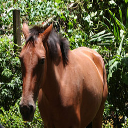

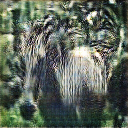

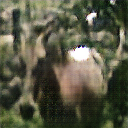

epoch: 22/5000, batch: 100/1067, GA2B_loss: 2.7341182231903076, GB2A_loss: 2.194279909133911
                             DA_loss: 0.11277619004249573, DB_loss: 4.095668828085763e-06, CYC_loss: 0.3474622964859009
epoch: 22/5000, batch: 200/1067, GA2B_loss: 2.5448782444000244, GB2A_loss: 2.5378193855285645
                             DA_loss: 1.2046491974615492e-05, DB_loss: 3.586822276702151e-05, CYC_loss: 0.30952173471450806
epoch: 22/5000, batch: 300/1067, GA2B_loss: 2.455199956893921, GB2A_loss: 2.6105265617370605
                             DA_loss: 0.06908111274242401, DB_loss: 0.01838374137878418, CYC_loss: 0.3267739415168762
epoch: 22/5000, batch: 400/1067, GA2B_loss: 2.727184295654297, GB2A_loss: 2.7127487659454346
                             DA_loss: 0.002951364265754819, DB_loss: 0.002387277316302061, CYC_loss: 0.3721008896827698
epoch: 22/5000, batch: 500/1067, GA2B_loss: 3.05385422706604, GB2A_loss: 2.9389538764953613
                             DA_loss: 0.0220250468701

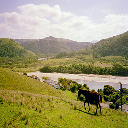

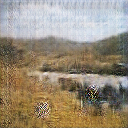

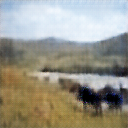

epoch: 23/5000, batch: 100/1067, GA2B_loss: 2.6577413082122803, GB2A_loss: 2.5048892498016357
                             DA_loss: 0.009533578529953957, DB_loss: 6.45076870569028e-05, CYC_loss: 0.3316217064857483
epoch: 23/5000, batch: 200/1067, GA2B_loss: 3.119288921356201, GB2A_loss: 3.3773465156555176
                             DA_loss: 0.13223721086978912, DB_loss: 0.010410846211016178, CYC_loss: 0.47723621129989624
epoch: 23/5000, batch: 300/1067, GA2B_loss: 2.390780448913574, GB2A_loss: 2.3237483501434326
                             DA_loss: 0.0037046177312731743, DB_loss: 0.0008375626057386398, CYC_loss: 0.29041796922683716
epoch: 23/5000, batch: 400/1067, GA2B_loss: 3.217507839202881, GB2A_loss: 3.062130928039551
                             DA_loss: 0.003334535751491785, DB_loss: 1.9582281311159022e-05, CYC_loss: 0.44355225563049316
epoch: 23/5000, batch: 500/1067, GA2B_loss: 3.037600517272949, GB2A_loss: 3.063725233078003
                             DA_loss: 0.0371795035

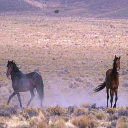

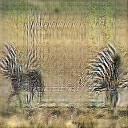

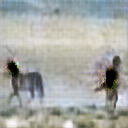

epoch: 24/5000, batch: 100/1067, GA2B_loss: 2.7683026790618896, GB2A_loss: 2.9568142890930176
                             DA_loss: 3.7714729842264205e-05, DB_loss: 0.005664704367518425, CYC_loss: 0.3939695954322815
epoch: 24/5000, batch: 200/1067, GA2B_loss: 2.5467376708984375, GB2A_loss: 2.512850046157837
                             DA_loss: 0.0001549609296489507, DB_loss: 0.010279803536832333, CYC_loss: 0.3094128966331482
epoch: 24/5000, batch: 300/1067, GA2B_loss: 2.7436187267303467, GB2A_loss: 2.650003671646118
                             DA_loss: 0.001579933101311326, DB_loss: 0.01966460980474949, CYC_loss: 0.3516278862953186
epoch: 24/5000, batch: 400/1067, GA2B_loss: 2.525063991546631, GB2A_loss: 2.4737606048583984
                             DA_loss: 0.0008387213456444442, DB_loss: 0.043724603950977325, CYC_loss: 0.3106297254562378
epoch: 24/5000, batch: 500/1067, GA2B_loss: 2.3238539695739746, GB2A_loss: 1.9373652935028076
                             DA_loss: 0.0287674777

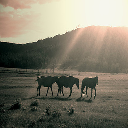

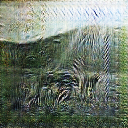

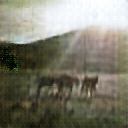

epoch: 25/5000, batch: 100/1067, GA2B_loss: 2.611523389816284, GB2A_loss: 2.534592866897583
                             DA_loss: 0.0014063211856409907, DB_loss: 9.855539974523708e-05, CYC_loss: 0.3275689482688904
epoch: 25/5000, batch: 200/1067, GA2B_loss: 2.6978886127471924, GB2A_loss: 2.9281904697418213
                             DA_loss: 0.0025005070492625237, DB_loss: 0.10829707235097885, CYC_loss: 0.41214630007743835
epoch: 25/5000, batch: 300/1067, GA2B_loss: 3.4056637287139893, GB2A_loss: 3.222189426422119
                             DA_loss: 0.004680207464843988, DB_loss: 0.0003418815031182021, CYC_loss: 0.4812277853488922
epoch: 25/5000, batch: 400/1067, GA2B_loss: 3.0137014389038086, GB2A_loss: 2.061048746109009
                             DA_loss: 0.42205291986465454, DB_loss: 0.00019830935343634337, CYC_loss: 0.40422481298446655
epoch: 25/5000, batch: 500/1067, GA2B_loss: 2.754483699798584, GB2A_loss: 2.71046781539917
                             DA_loss: 0.00048201653

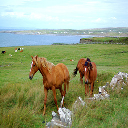

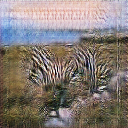

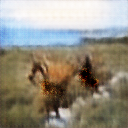

epoch: 26/5000, batch: 100/1067, GA2B_loss: 2.643834352493286, GB2A_loss: 2.558770179748535
                             DA_loss: 0.2460622638463974, DB_loss: 1.104935805074092e-07, CYC_loss: 0.3289451599121094
epoch: 26/5000, batch: 200/1067, GA2B_loss: 3.3682658672332764, GB2A_loss: 3.2782087326049805
                             DA_loss: 0.0018537436844781041, DB_loss: 0.0063321636989712715, CYC_loss: 0.47481977939605713
epoch: 26/5000, batch: 300/1067, GA2B_loss: 2.933185577392578, GB2A_loss: 2.958279609680176
                             DA_loss: 4.48029168182984e-05, DB_loss: 0.0002650865353643894, CYC_loss: 0.3953348994255066
epoch: 26/5000, batch: 400/1067, GA2B_loss: 2.702469825744629, GB2A_loss: 2.4835822582244873
                             DA_loss: 0.029299557209014893, DB_loss: 0.0002480807015672326, CYC_loss: 0.34294912219047546
epoch: 26/5000, batch: 500/1067, GA2B_loss: 2.782382011413574, GB2A_loss: 2.5274014472961426
                             DA_loss: 0.00957236625

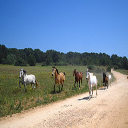

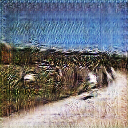

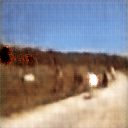

epoch: 27/5000, batch: 100/1067, GA2B_loss: 3.103288173675537, GB2A_loss: 3.173494577407837
                             DA_loss: 3.3774442272260785e-05, DB_loss: 0.003575560636818409, CYC_loss: 0.43797290325164795
epoch: 27/5000, batch: 200/1067, GA2B_loss: 2.7308261394500732, GB2A_loss: 2.694946765899658
                             DA_loss: 0.00017950065375771374, DB_loss: 0.0025249700993299484, CYC_loss: 0.3464883863925934
epoch: 27/5000, batch: 300/1067, GA2B_loss: 1.9428874254226685, GB2A_loss: 2.931971788406372
                             DA_loss: 0.00018150378309655935, DB_loss: 0.4478225111961365, CYC_loss: 0.3880024552345276
epoch: 27/5000, batch: 400/1067, GA2B_loss: 2.4753637313842773, GB2A_loss: 1.6475346088409424
                             DA_loss: 0.17704692482948303, DB_loss: 0.0009108389494940639, CYC_loss: 0.2967112958431244
epoch: 27/5000, batch: 500/1067, GA2B_loss: 1.8396885395050049, GB2A_loss: 2.351285696029663
                             DA_loss: 0.133745133

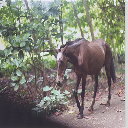

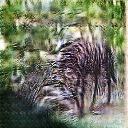

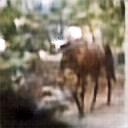

epoch: 28/5000, batch: 100/1067, GA2B_loss: 2.890500545501709, GB2A_loss: 2.56479549407959
                             DA_loss: 0.017779868096113205, DB_loss: 1.3705462151847314e-05, CYC_loss: 0.38017138838768005
epoch: 28/5000, batch: 200/1067, GA2B_loss: 2.824836254119873, GB2A_loss: 2.996211528778076
                             DA_loss: 0.002358728786930442, DB_loss: 0.004149498883634806, CYC_loss: 0.3992946147918701
epoch: 28/5000, batch: 300/1067, GA2B_loss: 3.0020503997802734, GB2A_loss: 3.0604076385498047
                             DA_loss: 0.004849393852055073, DB_loss: 0.0004930423456244171, CYC_loss: 0.41275227069854736
epoch: 28/5000, batch: 400/1067, GA2B_loss: 2.3505735397338867, GB2A_loss: 2.790837287902832
                             DA_loss: 0.004186999052762985, DB_loss: 0.03241651505231857, CYC_loss: 0.3589974343776703
epoch: 28/5000, batch: 500/1067, GA2B_loss: 2.2865335941314697, GB2A_loss: 2.433349132537842
                             DA_loss: 0.0037298430688

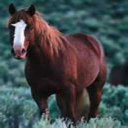

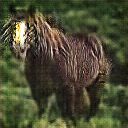

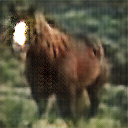

epoch: 29/5000, batch: 100/1067, GA2B_loss: 2.7992639541625977, GB2A_loss: 2.86513090133667
                             DA_loss: 0.00031626527197659016, DB_loss: 0.000995701877400279, CYC_loss: 0.3758601248264313
epoch: 29/5000, batch: 200/1067, GA2B_loss: 2.832679033279419, GB2A_loss: 2.464132785797119
                             DA_loss: 0.08000919967889786, DB_loss: 0.10549946874380112, CYC_loss: 0.3672449588775635
epoch: 29/5000, batch: 300/1067, GA2B_loss: 2.0760550498962402, GB2A_loss: 3.0558247566223145
                             DA_loss: 3.337119778734632e-06, DB_loss: 0.38081809878349304, CYC_loss: 0.4119699001312256
epoch: 29/5000, batch: 400/1067, GA2B_loss: 3.4332780838012695, GB2A_loss: 2.439396381378174
                             DA_loss: 0.4284704029560089, DB_loss: 2.826342279149685e-05, CYC_loss: 0.4867743253707886
epoch: 29/5000, batch: 500/1067, GA2B_loss: 2.811591625213623, GB2A_loss: 2.7271969318389893
                             DA_loss: 0.00110359652899205

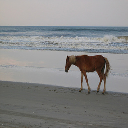

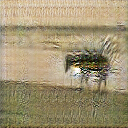

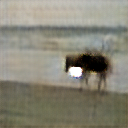

epoch: 30/5000, batch: 100/1067, GA2B_loss: 2.554360866546631, GB2A_loss: 2.5223782062530518
                             DA_loss: 0.0343211330473423, DB_loss: 3.15333551270669e-07, CYC_loss: 0.31089869141578674
epoch: 30/5000, batch: 200/1067, GA2B_loss: 3.129993438720703, GB2A_loss: 3.041902780532837
                             DA_loss: 0.001113896258175373, DB_loss: 7.605582140968181e-06, CYC_loss: 0.42681458592414856
epoch: 30/5000, batch: 300/1067, GA2B_loss: 2.7682437896728516, GB2A_loss: 2.403127670288086
                             DA_loss: 0.020651649683713913, DB_loss: 0.12228783965110779, CYC_loss: 0.3536575436592102
epoch: 30/5000, batch: 400/1067, GA2B_loss: 2.3866453170776367, GB2A_loss: 2.390965461730957
                             DA_loss: 2.2608899598708376e-05, DB_loss: 0.00429689884185791, CYC_loss: 0.2788267135620117
epoch: 30/5000, batch: 500/1067, GA2B_loss: 2.9779036045074463, GB2A_loss: 2.837327003479004
                             DA_loss: 0.003784571774303

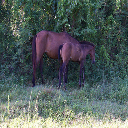

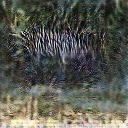

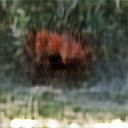

epoch: 31/5000, batch: 100/1067, GA2B_loss: 2.7383439540863037, GB2A_loss: 2.718491554260254
                             DA_loss: 6.557459710165858e-05, DB_loss: 0.012282848358154297, CYC_loss: 0.3481820821762085
epoch: 31/5000, batch: 200/1067, GA2B_loss: 2.7128140926361084, GB2A_loss: 2.7347841262817383
                             DA_loss: 0.004656578414142132, DB_loss: 0.025284791365265846, CYC_loss: 0.35078859329223633
epoch: 31/5000, batch: 300/1067, GA2B_loss: 2.656947612762451, GB2A_loss: 1.9720613956451416
                             DA_loss: 0.15485501289367676, DB_loss: 0.00025970779825001955, CYC_loss: 0.33489903807640076
epoch: 31/5000, batch: 400/1067, GA2B_loss: 2.937422513961792, GB2A_loss: 2.7920360565185547
                             DA_loss: 0.005331715568900108, DB_loss: 0.0002064679574687034, CYC_loss: 0.39553025364875793
epoch: 31/5000, batch: 500/1067, GA2B_loss: 2.36027455329895, GB2A_loss: 2.53816294670105
                             DA_loss: 1.83998636202

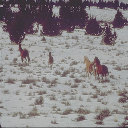

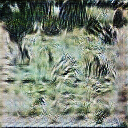

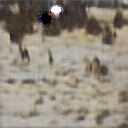

epoch: 32/5000, batch: 100/1067, GA2B_loss: 3.1494016647338867, GB2A_loss: 3.129518508911133
                             DA_loss: 0.00023366630193777382, DB_loss: 0.005546084605157375, CYC_loss: 0.4325804114341736
epoch: 32/5000, batch: 200/1067, GA2B_loss: 2.7985734939575195, GB2A_loss: 3.1320013999938965
                             DA_loss: 0.005134972743690014, DB_loss: 0.035331375896930695, CYC_loss: 0.45190349221229553
epoch: 32/5000, batch: 300/1067, GA2B_loss: 2.6788835525512695, GB2A_loss: 2.7284183502197266
                             DA_loss: 0.0005215629353187978, DB_loss: 0.09867789596319199, CYC_loss: 0.3473540246486664
epoch: 32/5000, batch: 400/1067, GA2B_loss: 2.391963005065918, GB2A_loss: 2.605771064758301
                             DA_loss: 0.0010588453151285648, DB_loss: 0.012823358178138733, CYC_loss: 0.3366881310939789
epoch: 32/5000, batch: 500/1067, GA2B_loss: 2.6679320335388184, GB2A_loss: 2.637582778930664
                             DA_loss: 0.0001468308

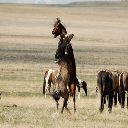

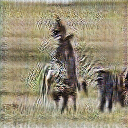

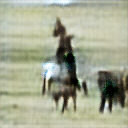

epoch: 33/5000, batch: 100/1067, GA2B_loss: 3.0692009925842285, GB2A_loss: 3.275747776031494
                             DA_loss: 2.7405742457631277e-06, DB_loss: 0.006257391534745693, CYC_loss: 0.4560849666595459
epoch: 33/5000, batch: 200/1067, GA2B_loss: 2.5575015544891357, GB2A_loss: 2.44818115234375
                             DA_loss: 0.0016889387043192983, DB_loss: 0.0035631381906569004, CYC_loss: 0.31220710277557373
epoch: 33/5000, batch: 300/1067, GA2B_loss: 2.3204030990600586, GB2A_loss: 2.2408015727996826
                             DA_loss: 0.0016102141235023737, DB_loss: 0.00043815674143843353, CYC_loss: 0.2641223967075348
epoch: 33/5000, batch: 400/1067, GA2B_loss: 2.5884900093078613, GB2A_loss: 1.7130279541015625
                             DA_loss: 0.26127198338508606, DB_loss: 0.0002899868995882571, CYC_loss: 0.32721495628356934
epoch: 33/5000, batch: 500/1067, GA2B_loss: 2.9781289100646973, GB2A_loss: 2.9411520957946777
                             DA_loss: 0.0001

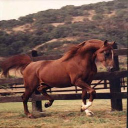

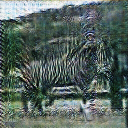

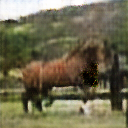

epoch: 34/5000, batch: 100/1067, GA2B_loss: 2.961662530899048, GB2A_loss: 2.9384894371032715
                             DA_loss: 0.00010159926023334265, DB_loss: 4.50689549325034e-06, CYC_loss: 0.39335906505584717
epoch: 34/5000, batch: 200/1067, GA2B_loss: 2.8262317180633545, GB2A_loss: 2.79897141456604
                             DA_loss: 0.0001163413398899138, DB_loss: 3.399173351681384e-07, CYC_loss: 0.3655421733856201
epoch: 34/5000, batch: 300/1067, GA2B_loss: 2.484038829803467, GB2A_loss: 2.275912284851074
                             DA_loss: 0.011188956908881664, DB_loss: 0.003489710157737136, CYC_loss: 0.3105437755584717
epoch: 34/5000, batch: 400/1067, GA2B_loss: 2.4632010459899902, GB2A_loss: 2.200352191925049
                             DA_loss: 0.024804193526506424, DB_loss: 0.39731863141059875, CYC_loss: 0.3192313313484192
epoch: 34/5000, batch: 500/1067, GA2B_loss: 3.510953426361084, GB2A_loss: 3.2437520027160645
                             DA_loss: 0.0125074945390

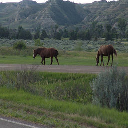

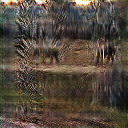

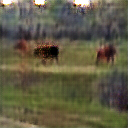

epoch: 35/5000, batch: 100/1067, GA2B_loss: 2.3697383403778076, GB2A_loss: 2.3506693840026855
                             DA_loss: 0.0014993043150752783, DB_loss: 0.059370700269937515, CYC_loss: 0.2740170955657959
epoch: 35/5000, batch: 200/1067, GA2B_loss: 3.431732416152954, GB2A_loss: 3.423921585083008
                             DA_loss: 0.05972051993012428, DB_loss: 0.00023380380298476666, CYC_loss: 0.4866815209388733
epoch: 35/5000, batch: 300/1067, GA2B_loss: 3.151811122894287, GB2A_loss: 2.2467055320739746
                             DA_loss: 0.23998036980628967, DB_loss: 0.045141033828258514, CYC_loss: 0.4304657280445099
epoch: 35/5000, batch: 400/1067, GA2B_loss: 2.649366855621338, GB2A_loss: 2.6802587509155273
                             DA_loss: 0.0004961324739269912, DB_loss: 0.0002094522351399064, CYC_loss: 0.3379758596420288
epoch: 35/5000, batch: 500/1067, GA2B_loss: 2.252920150756836, GB2A_loss: 2.3192594051361084
                             DA_loss: 6.863872840767

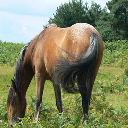

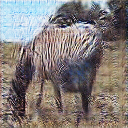

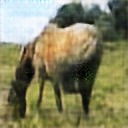

epoch: 36/5000, batch: 100/1067, GA2B_loss: 2.6037614345550537, GB2A_loss: 2.6007285118103027
                             DA_loss: 0.1528901755809784, DB_loss: 0.000323248008498922, CYC_loss: 0.32605570554733276
epoch: 36/5000, batch: 200/1067, GA2B_loss: 2.4617292881011963, GB2A_loss: 2.4967434406280518
                             DA_loss: 0.0014594182139262557, DB_loss: 0.0019518594490364194, CYC_loss: 0.3165566027164459
epoch: 36/5000, batch: 300/1067, GA2B_loss: 2.922079086303711, GB2A_loss: 2.3170981407165527
                             DA_loss: 0.12154778093099594, DB_loss: 0.0025692745111882687, CYC_loss: 0.41201919317245483
epoch: 36/5000, batch: 400/1067, GA2B_loss: 2.809049606323242, GB2A_loss: 2.720734119415283
                             DA_loss: 0.00875856727361679, DB_loss: 9.09547907212982e-06, CYC_loss: 0.36351001262664795
epoch: 36/5000, batch: 500/1067, GA2B_loss: 2.7035555839538574, GB2A_loss: 2.565584182739258
                             DA_loss: 0.007881145924

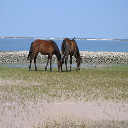

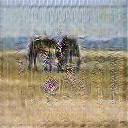

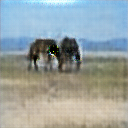

epoch: 37/5000, batch: 100/1067, GA2B_loss: 2.6840126514434814, GB2A_loss: 2.7193164825439453
                             DA_loss: 0.006882937625050545, DB_loss: 0.01007155328989029, CYC_loss: 0.3441988229751587
epoch: 37/5000, batch: 200/1067, GA2B_loss: 2.9338581562042236, GB2A_loss: 2.900264263153076
                             DA_loss: 0.4781668186187744, DB_loss: 1.0923502031801036e-06, CYC_loss: 0.3870352506637573
epoch: 37/5000, batch: 300/1067, GA2B_loss: 2.528942584991455, GB2A_loss: 2.3388426303863525
                             DA_loss: 0.006365376058965921, DB_loss: 0.0008244609925895929, CYC_loss: 0.31000691652297974
epoch: 37/5000, batch: 400/1067, GA2B_loss: 2.343583106994629, GB2A_loss: 2.3440730571746826
                             DA_loss: 0.00867670588195324, DB_loss: 8.736769086681306e-05, CYC_loss: 0.26890233159065247
epoch: 37/5000, batch: 500/1067, GA2B_loss: 2.6854100227355957, GB2A_loss: 2.5800106525421143
                             DA_loss: 0.00150186615

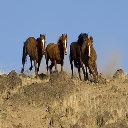

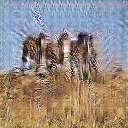

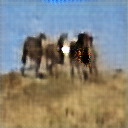

epoch: 38/5000, batch: 100/1067, GA2B_loss: 2.286587715148926, GB2A_loss: 2.2779898643493652
                             DA_loss: 7.127535354811698e-05, DB_loss: 0.00011834501492558047, CYC_loss: 0.25731831789016724
epoch: 38/5000, batch: 200/1067, GA2B_loss: 2.698981285095215, GB2A_loss: 3.273242950439453
                             DA_loss: 0.002512408187612891, DB_loss: 0.0661114826798439, CYC_loss: 0.45798954367637634
epoch: 38/5000, batch: 300/1067, GA2B_loss: 3.6650190353393555, GB2A_loss: 3.597696542739868
                             DA_loss: 0.3054847717285156, DB_loss: 9.424048766959459e-05, CYC_loss: 0.5338754653930664
epoch: 38/5000, batch: 400/1067, GA2B_loss: 3.0516631603240967, GB2A_loss: 2.6781363487243652
                             DA_loss: 0.02505027875304222, DB_loss: 7.309133798116818e-05, CYC_loss: 0.4151396155357361
epoch: 38/5000, batch: 500/1067, GA2B_loss: 2.615227222442627, GB2A_loss: 2.5463531017303467
                             DA_loss: 0.0022196024656

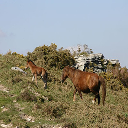

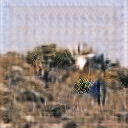

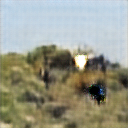

epoch: 39/5000, batch: 100/1067, GA2B_loss: 2.8557324409484863, GB2A_loss: 2.8538360595703125
                             DA_loss: 0.0013428208185359836, DB_loss: 8.563706614950206e-06, CYC_loss: 0.3717700242996216
epoch: 39/5000, batch: 200/1067, GA2B_loss: 2.356462240219116, GB2A_loss: 2.3543803691864014
                             DA_loss: 0.00013850047253072262, DB_loss: 0.0001219263140228577, CYC_loss: 0.2774777114391327
epoch: 39/5000, batch: 300/1067, GA2B_loss: 2.777949810028076, GB2A_loss: 2.764697790145874
                             DA_loss: 2.2616359274252318e-05, DB_loss: 0.002786389086395502, CYC_loss: 0.35562071204185486
epoch: 39/5000, batch: 400/1067, GA2B_loss: 2.8322243690490723, GB2A_loss: 2.8351693153381348
                             DA_loss: 0.015889909118413925, DB_loss: 4.34513412983506e-06, CYC_loss: 0.3676214814186096
epoch: 39/5000, batch: 500/1067, GA2B_loss: 2.265322208404541, GB2A_loss: 2.2669291496276855
                             DA_loss: 4.888922

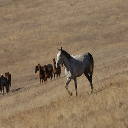

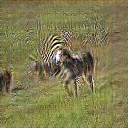

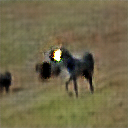

epoch: 40/5000, batch: 100/1067, GA2B_loss: 2.7056217193603516, GB2A_loss: 2.7026894092559814
                             DA_loss: 0.00269972812384367, DB_loss: 0.021255645900964737, CYC_loss: 0.3411905765533447
epoch: 40/5000, batch: 200/1067, GA2B_loss: 2.593930244445801, GB2A_loss: 2.5923960208892822
                             DA_loss: 0.04619462415575981, DB_loss: 3.2698362701921724e-06, CYC_loss: 0.3188058137893677
epoch: 40/5000, batch: 300/1067, GA2B_loss: 2.9116060733795166, GB2A_loss: 3.057593822479248
                             DA_loss: 1.0602089872691067e-08, DB_loss: 0.0029296469874680042, CYC_loss: 0.41152042150497437
epoch: 40/5000, batch: 400/1067, GA2B_loss: 2.6142706871032715, GB2A_loss: 2.463785171508789
                             DA_loss: 0.0031509629916399717, DB_loss: 3.5912111684410775e-07, CYC_loss: 0.3231464624404907
epoch: 40/5000, batch: 500/1067, GA2B_loss: 2.5891807079315186, GB2A_loss: 2.6856212615966797
                             DA_loss: 8.734496

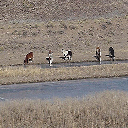

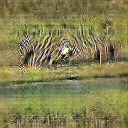

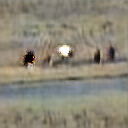

epoch: 41/5000, batch: 100/1067, GA2B_loss: 2.923645496368408, GB2A_loss: 2.943812370300293
                             DA_loss: 0.0005823572864755988, DB_loss: 8.585886826040223e-05, CYC_loss: 0.38993561267852783
epoch: 41/5000, batch: 200/1067, GA2B_loss: 2.7998440265655518, GB2A_loss: 2.7975497245788574
                             DA_loss: 8.467541192658246e-07, DB_loss: 2.748436418187339e-05, CYC_loss: 0.3600040674209595
epoch: 41/5000, batch: 300/1067, GA2B_loss: 2.273897886276245, GB2A_loss: 2.2758822441101074
                             DA_loss: 0.00017679747543297708, DB_loss: 0.021669650450348854, CYC_loss: 0.25521790981292725
epoch: 41/5000, batch: 400/1067, GA2B_loss: 2.5904297828674316, GB2A_loss: 2.588986396789551
                             DA_loss: 0.0011520914267748594, DB_loss: 1.8212984286947176e-05, CYC_loss: 0.3181656002998352
epoch: 41/5000, batch: 500/1067, GA2B_loss: 2.5730838775634766, GB2A_loss: 2.2410073280334473
                             DA_loss: 0.086

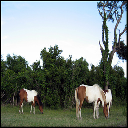

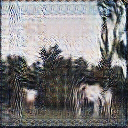

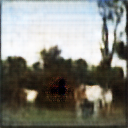

epoch: 42/5000, batch: 100/1067, GA2B_loss: 2.8920531272888184, GB2A_loss: 2.8901989459991455
                             DA_loss: 4.943079261465755e-07, DB_loss: 0.00038031296571716666, CYC_loss: 0.3784372806549072
epoch: 42/5000, batch: 200/1067, GA2B_loss: 2.270890712738037, GB2A_loss: 1.8990132808685303
                             DA_loss: 0.0228347796946764, DB_loss: 4.5578918417277237e-08, CYC_loss: 0.25419676303863525
epoch: 42/5000, batch: 300/1067, GA2B_loss: 2.936691999435425, GB2A_loss: 2.909735679626465
                             DA_loss: 0.00013555638724938035, DB_loss: 1.9613939002738334e-05, CYC_loss: 0.38783082365989685
epoch: 42/5000, batch: 400/1067, GA2B_loss: 2.173114061355591, GB2A_loss: 2.174531936645508
                             DA_loss: 1.5303240896713532e-09, DB_loss: 5.080555638414808e-07, CYC_loss: 0.23491118848323822
epoch: 42/5000, batch: 500/1067, GA2B_loss: 2.4980974197387695, GB2A_loss: 3.0082902908325195
                             DA_loss: 1.11

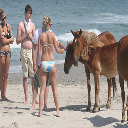

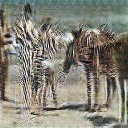

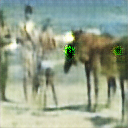

epoch: 43/5000, batch: 100/1067, GA2B_loss: 2.9485392570495605, GB2A_loss: 2.6520886421203613
                             DA_loss: 0.02682514116168022, DB_loss: 3.0136284294712823e-06, CYC_loss: 0.3904220461845398
epoch: 43/5000, batch: 200/1067, GA2B_loss: 2.2699437141418457, GB2A_loss: 1.7801529169082642
                             DA_loss: 0.04082639142870903, DB_loss: 0.008793744258582592, CYC_loss: 0.25399982929229736
epoch: 43/5000, batch: 300/1067, GA2B_loss: 2.755131721496582, GB2A_loss: 2.7500224113464355
                             DA_loss: 1.2789117135980632e-05, DB_loss: 0.27495455741882324, CYC_loss: 0.3520223796367645
epoch: 43/5000, batch: 400/1067, GA2B_loss: 2.5831103324890137, GB2A_loss: 2.5825719833374023
                             DA_loss: 0.003283007303252816, DB_loss: 0.00019826542120426893, CYC_loss: 0.31667017936706543
epoch: 43/5000, batch: 500/1067, GA2B_loss: 2.520009756088257, GB2A_loss: 2.516848087310791
                             DA_loss: 4.94354299

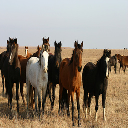

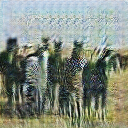

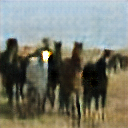

epoch: 44/5000, batch: 100/1067, GA2B_loss: 2.4998440742492676, GB2A_loss: 1.9789475202560425
                             DA_loss: 0.04744749143719673, DB_loss: 1.1929468080040806e-08, CYC_loss: 0.3000306189060211
epoch: 44/5000, batch: 200/1067, GA2B_loss: 2.7718300819396973, GB2A_loss: 2.6693615913391113
                             DA_loss: 0.0013872606214135885, DB_loss: 8.538326801499352e-05, CYC_loss: 0.3543868958950043
epoch: 44/5000, batch: 300/1067, GA2B_loss: 3.203251361846924, GB2A_loss: 3.212691307067871
                             DA_loss: 0.002045252127572894, DB_loss: 1.5145434190344531e-05, CYC_loss: 0.44262534379959106
epoch: 44/5000, batch: 400/1067, GA2B_loss: 2.190091133117676, GB2A_loss: 2.303473949432373
                             DA_loss: 0.0004227247554808855, DB_loss: 0.003990422934293747, CYC_loss: 0.2721562385559082
epoch: 44/5000, batch: 500/1067, GA2B_loss: 2.838552951812744, GB2A_loss: 2.881784439086914
                             DA_loss: 0.005343904

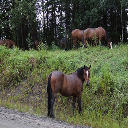

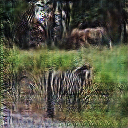

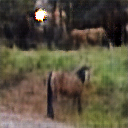

epoch: 45/5000, batch: 100/1067, GA2B_loss: 2.754312753677368, GB2A_loss: 2.7008285522460938
                             DA_loss: 0.0004512830055318773, DB_loss: 0.0005736931343562901, CYC_loss: 0.3514477610588074
epoch: 45/5000, batch: 200/1067, GA2B_loss: 3.266460418701172, GB2A_loss: 3.260213613510132
                             DA_loss: 0.0006035331753082573, DB_loss: 1.3863652270629245e-07, CYC_loss: 0.453317254781723
epoch: 45/5000, batch: 300/1067, GA2B_loss: 2.9142239093780518, GB2A_loss: 2.917088270187378
                             DA_loss: 6.821311870908175e-08, DB_loss: 2.517505208743387e-06, CYC_loss: 0.38356536626815796
epoch: 45/5000, batch: 400/1067, GA2B_loss: 2.5260043144226074, GB2A_loss: 2.524982452392578
                             DA_loss: 4.615035891220032e-07, DB_loss: 4.970842155671562e-07, CYC_loss: 0.3053539991378784
epoch: 45/5000, batch: 500/1067, GA2B_loss: 2.257246971130371, GB2A_loss: 2.2926719188690186
                             DA_loss: 0.0056488

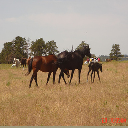

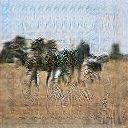

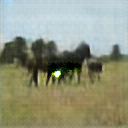

epoch: 46/5000, batch: 100/1067, GA2B_loss: 2.7603466510772705, GB2A_loss: 2.744257688522339
                             DA_loss: 3.752283373614773e-05, DB_loss: 0.00032186153111979365, CYC_loss: 0.35229727625846863
epoch: 46/5000, batch: 200/1067, GA2B_loss: 2.8426513671875, GB2A_loss: 2.8392012119293213
                             DA_loss: 1.4427905625780113e-05, DB_loss: 7.357997674262151e-05, CYC_loss: 0.3694661855697632
epoch: 46/5000, batch: 300/1067, GA2B_loss: 2.2800939083099365, GB2A_loss: 2.250101089477539
                             DA_loss: 0.0001318334834650159, DB_loss: 3.2835853147616945e-08, CYC_loss: 0.2561212182044983
epoch: 46/5000, batch: 400/1067, GA2B_loss: 2.4046854972839355, GB2A_loss: 2.4858663082122803
                             DA_loss: 8.139622877934016e-06, DB_loss: 0.001042742282152176, CYC_loss: 0.29878392815589905
epoch: 46/5000, batch: 500/1067, GA2B_loss: 2.5440781116485596, GB2A_loss: 2.4174561500549316
                             DA_loss: 0.002

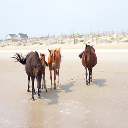

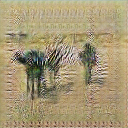

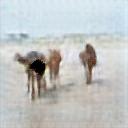

epoch: 47/5000, batch: 100/1067, GA2B_loss: 2.4886739253997803, GB2A_loss: 2.287677764892578
                             DA_loss: 0.005834466777741909, DB_loss: 4.33147324656602e-05, CYC_loss: 0.2984107434749603
epoch: 47/5000, batch: 200/1067, GA2B_loss: 2.2602267265319824, GB2A_loss: 2.2582247257232666
                             DA_loss: 0.00016345285985153168, DB_loss: 0.001011144369840622, CYC_loss: 0.2525317072868347
epoch: 47/5000, batch: 300/1067, GA2B_loss: 2.284562587738037, GB2A_loss: 2.2850985527038574
                             DA_loss: 7.803727442023956e-08, DB_loss: 2.489169219188625e-06, CYC_loss: 0.2571773827075958
epoch: 47/5000, batch: 400/1067, GA2B_loss: 3.094247341156006, GB2A_loss: 3.101667642593384
                             DA_loss: 7.479318497871645e-08, DB_loss: 0.0002559661224950105, CYC_loss: 0.4204874634742737
epoch: 47/5000, batch: 500/1067, GA2B_loss: 2.362797975540161, GB2A_loss: 2.2198660373687744
                             DA_loss: 0.002949674

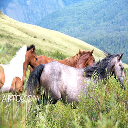

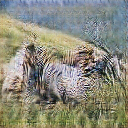

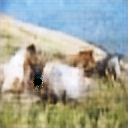

epoch: 48/5000, batch: 100/1067, GA2B_loss: 2.8476266860961914, GB2A_loss: 2.845367908477783
                             DA_loss: 0.0016620358219370246, DB_loss: 1.8704273315961473e-05, CYC_loss: 0.3699873983860016
epoch: 48/5000, batch: 200/1067, GA2B_loss: 2.6131534576416016, GB2A_loss: 2.7345423698425293
                             DA_loss: 0.00027884531300514936, DB_loss: 0.004445242695510387, CYC_loss: 0.35624074935913086
epoch: 48/5000, batch: 300/1067, GA2B_loss: 2.8568320274353027, GB2A_loss: 2.7186222076416016
                             DA_loss: 0.0031957884784787893, DB_loss: 9.407339530298486e-05, CYC_loss: 0.3744249939918518
epoch: 48/5000, batch: 400/1067, GA2B_loss: 2.4485926628112793, GB2A_loss: 2.435237407684326
                             DA_loss: 0.0387561209499836, DB_loss: 1.2928147953061853e-05, CYC_loss: 0.2902044653892517
epoch: 48/5000, batch: 500/1067, GA2B_loss: 2.5610623359680176, GB2A_loss: 2.559011459350586
                             DA_loss: 0.00012

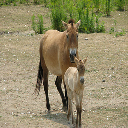

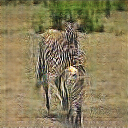

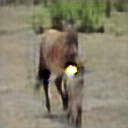

epoch: 49/5000, batch: 100/1067, GA2B_loss: 2.7352070808410645, GB2A_loss: 2.741746664047241
                             DA_loss: 0.0010403573978692293, DB_loss: 3.5619959817267954e-05, CYC_loss: 0.3485475778579712
epoch: 49/5000, batch: 200/1067, GA2B_loss: 3.229078769683838, GB2A_loss: 3.248349905014038
                             DA_loss: 3.1173340175882913e-06, DB_loss: 4.9917394790099934e-05, CYC_loss: 0.4497905969619751
epoch: 49/5000, batch: 300/1067, GA2B_loss: 2.440232276916504, GB2A_loss: 2.4516444206237793
                             DA_loss: 8.310115845233668e-06, DB_loss: 4.282388908904977e-05, CYC_loss: 0.2915998101234436
epoch: 49/5000, batch: 400/1067, GA2B_loss: 2.1449954509735107, GB2A_loss: 2.059878349304199
                             DA_loss: 0.001159612089395523, DB_loss: 1.5079420336405747e-05, CYC_loss: 0.23076245188713074
epoch: 49/5000, batch: 500/1067, GA2B_loss: 2.8450655937194824, GB2A_loss: 2.8413047790527344
                             DA_loss: 2.427

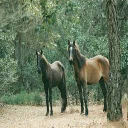

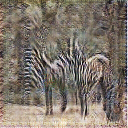

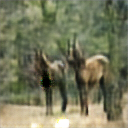

epoch: 50/5000, batch: 100/1067, GA2B_loss: 2.858823776245117, GB2A_loss: 2.5308070182800293
                             DA_loss: 0.01624608039855957, DB_loss: 3.500086677377112e-05, CYC_loss: 0.3717651963233948
epoch: 50/5000, batch: 200/1067, GA2B_loss: 2.391446828842163, GB2A_loss: 2.3728857040405273
                             DA_loss: 0.00014965972513891757, DB_loss: 3.466830548859434e-06, CYC_loss: 0.27902570366859436
epoch: 50/5000, batch: 300/1067, GA2B_loss: 2.3644466400146484, GB2A_loss: 2.5373876094818115
                             DA_loss: 0.0008966318564489484, DB_loss: 0.004650888964533806, CYC_loss: 0.30960434675216675
epoch: 50/5000, batch: 400/1067, GA2B_loss: 3.1597251892089844, GB2A_loss: 3.159625291824341
                             DA_loss: 1.2602390242477668e-09, DB_loss: 0.00013194432540331036, CYC_loss: 0.4319451153278351
epoch: 50/5000, batch: 500/1067, GA2B_loss: 3.2198328971862793, GB2A_loss: 3.2200870513916016
                             DA_loss: 2.049

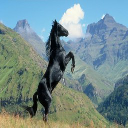

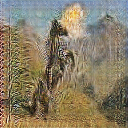

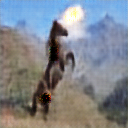

epoch: 51/5000, batch: 100/1067, GA2B_loss: 2.3948159217834473, GB2A_loss: 2.3815579414367676
                             DA_loss: 2.226007381977979e-05, DB_loss: 0.0004556640051305294, CYC_loss: 0.27897143363952637
epoch: 51/5000, batch: 200/1067, GA2B_loss: 2.5399200916290283, GB2A_loss: 2.5665364265441895
                             DA_loss: 0.06018417328596115, DB_loss: 9.053977555595338e-05, CYC_loss: 0.3133084177970886
epoch: 51/5000, batch: 300/1067, GA2B_loss: 2.385383367538452, GB2A_loss: 2.373812437057495
                             DA_loss: 0.00042488734470680356, DB_loss: 6.458089956140611e-07, CYC_loss: 0.2775101065635681
epoch: 51/5000, batch: 400/1067, GA2B_loss: 2.7910068035125732, GB2A_loss: 2.7716734409332275
                             DA_loss: 4.9518519517732784e-05, DB_loss: 4.285994670283344e-09, CYC_loss: 0.35823798179626465
epoch: 51/5000, batch: 500/1067, GA2B_loss: 2.4264020919799805, GB2A_loss: 2.423368453979492
                             DA_loss: 0.002

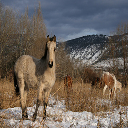

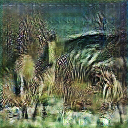

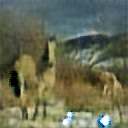

epoch: 52/5000, batch: 100/1067, GA2B_loss: 2.211681365966797, GB2A_loss: 2.7723073959350586
                             DA_loss: 0.0008265182841569185, DB_loss: 0.06924718618392944, CYC_loss: 0.36349669098854065
epoch: 52/5000, batch: 200/1067, GA2B_loss: 2.4959893226623535, GB2A_loss: 2.5125112533569336
                             DA_loss: 0.0011053361231461167, DB_loss: 4.364899359643459e-05, CYC_loss: 0.3029143214225769
epoch: 52/5000, batch: 300/1067, GA2B_loss: 2.8621368408203125, GB2A_loss: 2.911304473876953
                             DA_loss: 0.021043019369244576, DB_loss: 0.00047059860662557185, CYC_loss: 0.3822794556617737
epoch: 52/5000, batch: 400/1067, GA2B_loss: 2.3185482025146484, GB2A_loss: 2.3184711933135986
                             DA_loss: 3.348062449504141e-08, DB_loss: 0.0053465296514332294, CYC_loss: 0.2637958526611328
epoch: 52/5000, batch: 500/1067, GA2B_loss: 2.578068971633911, GB2A_loss: 2.5822176933288574
                             DA_loss: 0.027092

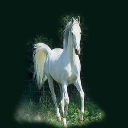

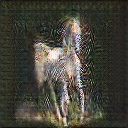

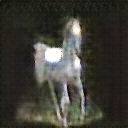

epoch: 53/5000, batch: 100/1067, GA2B_loss: 2.198063850402832, GB2A_loss: 2.376859664916992
                             DA_loss: 6.906464022904402e-06, DB_loss: 0.008684095926582813, CYC_loss: 0.2768557071685791
epoch: 53/5000, batch: 200/1067, GA2B_loss: 2.3974976539611816, GB2A_loss: 2.4139301776885986
                             DA_loss: 8.099274418782443e-05, DB_loss: 8.534441440133378e-05, CYC_loss: 0.28444188833236694
epoch: 53/5000, batch: 300/1067, GA2B_loss: 2.745985507965088, GB2A_loss: 2.746875047683716
                             DA_loss: 6.403378210961819e-05, DB_loss: 6.430855137296021e-05, CYC_loss: 0.349845290184021
epoch: 53/5000, batch: 400/1067, GA2B_loss: 2.4053616523742676, GB2A_loss: 2.407606601715088
                             DA_loss: 6.854928074062627e-07, DB_loss: 1.5922751117614098e-05, CYC_loss: 0.2815340459346771
epoch: 53/5000, batch: 500/1067, GA2B_loss: 2.3826706409454346, GB2A_loss: 2.3817591667175293
                             DA_loss: 6.3967207

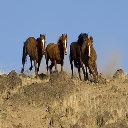

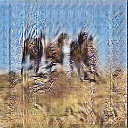

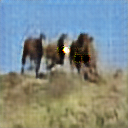

epoch: 54/5000, batch: 100/1067, GA2B_loss: 2.2714781761169434, GB2A_loss: 1.5275981426239014
                             DA_loss: 0.24553270637989044, DB_loss: 0.0037914004642516375, CYC_loss: 0.2876107692718506
epoch: 54/5000, batch: 200/1067, GA2B_loss: 2.698026180267334, GB2A_loss: 2.6755573749542236
                             DA_loss: 0.0008476300863549113, DB_loss: 5.429176781035494e-06, CYC_loss: 0.3402336537837982
epoch: 54/5000, batch: 300/1067, GA2B_loss: 2.810297966003418, GB2A_loss: 2.810769557952881
                             DA_loss: 0.002834401559084654, DB_loss: 3.735295450724152e-08, CYC_loss: 0.3621554970741272
epoch: 54/5000, batch: 400/1067, GA2B_loss: 2.370917320251465, GB2A_loss: 2.3489952087402344
                             DA_loss: 6.093534466344863e-05, DB_loss: 2.4461635348416166e-06, CYC_loss: 0.27418947219848633
epoch: 54/5000, batch: 500/1067, GA2B_loss: 2.6547651290893555, GB2A_loss: 2.575652599334717
                             DA_loss: 0.00141083

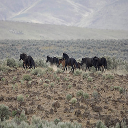

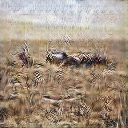

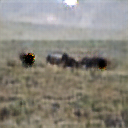

epoch: 55/5000, batch: 100/1067, GA2B_loss: 2.677849292755127, GB2A_loss: 2.6967267990112305
                             DA_loss: 1.0521603854840578e-07, DB_loss: 6.781306001357734e-05, CYC_loss: 0.33952879905700684
epoch: 55/5000, batch: 200/1067, GA2B_loss: 2.6748642921447754, GB2A_loss: 2.6784582138061523
                             DA_loss: 1.235648596775718e-05, DB_loss: 5.37678315595258e-05, CYC_loss: 0.3376730978488922
epoch: 55/5000, batch: 300/1067, GA2B_loss: 3.3438594341278076, GB2A_loss: 3.353472948074341
                             DA_loss: 0.0009077097056433558, DB_loss: 1.7714641217025928e-05, CYC_loss: 0.47078120708465576
epoch: 55/5000, batch: 400/1067, GA2B_loss: 2.5806820392608643, GB2A_loss: 2.5799427032470703
                             DA_loss: 9.803638079119992e-08, DB_loss: 0.0013545136898756027, CYC_loss: 0.3161655366420746
epoch: 55/5000, batch: 500/1067, GA2B_loss: 2.2661397457122803, GB2A_loss: 1.8581092357635498
                             DA_loss: 0.0

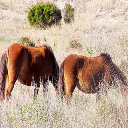

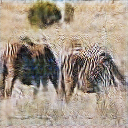

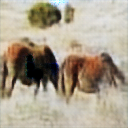

epoch: 56/5000, batch: 100/1067, GA2B_loss: 2.715130090713501, GB2A_loss: 2.715961217880249
                             DA_loss: 0.0011995796812698245, DB_loss: 1.180490585284133e-07, CYC_loss: 0.34321165084838867
epoch: 56/5000, batch: 200/1067, GA2B_loss: 2.3441834449768066, GB2A_loss: 2.2587108612060547
                             DA_loss: 0.0009619122138246894, DB_loss: 9.47773878579028e-06, CYC_loss: 0.2689020037651062
epoch: 56/5000, batch: 300/1067, GA2B_loss: 2.261552572250366, GB2A_loss: 2.2747554779052734
                             DA_loss: 3.1595683935847774e-07, DB_loss: 0.020642271265387535, CYC_loss: 0.25526896119117737
epoch: 56/5000, batch: 400/1067, GA2B_loss: 2.4190282821655273, GB2A_loss: 2.4228873252868652
                             DA_loss: 0.00033118142164312303, DB_loss: 8.236904250225052e-05, CYC_loss: 0.2888932228088379
epoch: 56/5000, batch: 500/1067, GA2B_loss: 2.146904945373535, GB2A_loss: 1.179076910018921
                             DA_loss: 0.43096

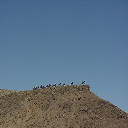

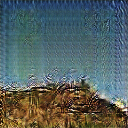

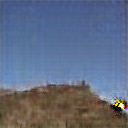

epoch: 57/5000, batch: 100/1067, GA2B_loss: 2.850923776626587, GB2A_loss: 2.8437445163726807
                             DA_loss: 1.0437439414090477e-05, DB_loss: 1.0174549203156857e-07, CYC_loss: 0.37036511301994324
epoch: 57/5000, batch: 200/1067, GA2B_loss: 2.795773983001709, GB2A_loss: 2.7906408309936523
                             DA_loss: 0.03022795170545578, DB_loss: 2.890402015509608e-07, CYC_loss: 0.35920149087905884
epoch: 57/5000, batch: 300/1067, GA2B_loss: 1.8391621112823486, GB2A_loss: 2.764352321624756
                             DA_loss: 0.00188120745588094, DB_loss: 0.2751076817512512, CYC_loss: 0.35447928309440613
epoch: 57/5000, batch: 400/1067, GA2B_loss: 2.4601128101348877, GB2A_loss: 2.4580042362213135
                             DA_loss: 0.03807620331645012, DB_loss: 8.765820894041099e-06, CYC_loss: 0.29326051473617554
epoch: 57/5000, batch: 500/1067, GA2B_loss: 2.1618151664733887, GB2A_loss: 2.16633939743042
                             DA_loss: 8.9918561485

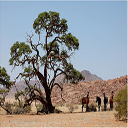

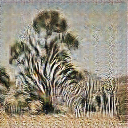

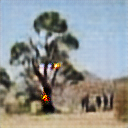

epoch: 58/5000, batch: 100/1067, GA2B_loss: 2.495635747909546, GB2A_loss: 2.509065628051758
                             DA_loss: 0.0016383177135139704, DB_loss: 2.8017497243126854e-05, CYC_loss: 0.3021099269390106
epoch: 58/5000, batch: 200/1067, GA2B_loss: 2.536663055419922, GB2A_loss: 2.20713210105896
                             DA_loss: 0.016442162916064262, DB_loss: 0.0004295928229112178, CYC_loss: 0.3073771595954895
epoch: 58/5000, batch: 300/1067, GA2B_loss: 2.2730889320373535, GB2A_loss: 2.2730014324188232
                             DA_loss: 2.117132709145153e-07, DB_loss: 5.11527105118148e-06, CYC_loss: 0.25462204217910767
epoch: 58/5000, batch: 400/1067, GA2B_loss: 2.4963090419769287, GB2A_loss: 2.518911361694336
                             DA_loss: 0.019227284938097, DB_loss: 6.603135989280418e-05, CYC_loss: 0.3038319945335388
epoch: 58/5000, batch: 500/1067, GA2B_loss: 2.4802486896514893, GB2A_loss: 2.481971263885498
                             DA_loss: 1.7953368569578

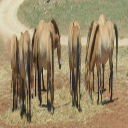

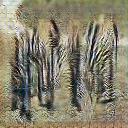

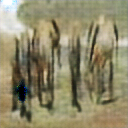

epoch: 59/5000, batch: 100/1067, GA2B_loss: 2.181530714035034, GB2A_loss: 2.18989896774292
                             DA_loss: 4.463140612642746e-06, DB_loss: 2.585323636594694e-05, CYC_loss: 0.239172101020813
epoch: 59/5000, batch: 200/1067, GA2B_loss: 1.362485647201538, GB2A_loss: 1.9035725593566895
                             DA_loss: 0.007405374199151993, DB_loss: 0.13524127006530762, CYC_loss: 0.22643214464187622
epoch: 59/5000, batch: 300/1067, GA2B_loss: 2.1042964458465576, GB2A_loss: 2.0551035404205322
                             DA_loss: 0.04708833619952202, DB_loss: 0.03734475374221802, CYC_loss: 0.3147810399532318
epoch: 59/5000, batch: 400/1067, GA2B_loss: 1.9267981052398682, GB2A_loss: 1.1926493644714355
                             DA_loss: 0.11820702999830246, DB_loss: 4.856574378209189e-07, CYC_loss: 0.1857367753982544
epoch: 59/5000, batch: 500/1067, GA2B_loss: 2.0268614292144775, GB2A_loss: 2.0730528831481934
                             DA_loss: 1.721568304580145

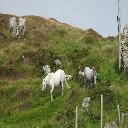

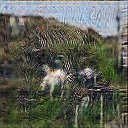

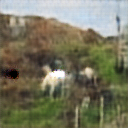

epoch: 60/5000, batch: 100/1067, GA2B_loss: 3.1092019081115723, GB2A_loss: 3.119166851043701
                             DA_loss: 0.015231998637318611, DB_loss: 1.2502807294367813e-05, CYC_loss: 0.4238356053829193
epoch: 60/5000, batch: 200/1067, GA2B_loss: 2.8821239471435547, GB2A_loss: 2.8816187381744385
                             DA_loss: 3.418972482904792e-08, DB_loss: 0.0001528922002762556, CYC_loss: 0.3764270544052124
epoch: 60/5000, batch: 300/1067, GA2B_loss: 2.9628419876098633, GB2A_loss: 3.159980535507202
                             DA_loss: 3.64816514775157e-07, DB_loss: 0.005486103240400553, CYC_loss: 0.4322547912597656
epoch: 60/5000, batch: 400/1067, GA2B_loss: 2.344465732574463, GB2A_loss: 2.344428777694702
                             DA_loss: 0.05175752565264702, DB_loss: 7.13908884790726e-05, CYC_loss: 0.26893359422683716
epoch: 60/5000, batch: 500/1067, GA2B_loss: 2.9006543159484863, GB2A_loss: 2.8955202102661133
                             DA_loss: 8.4248367784

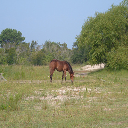

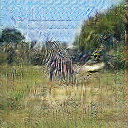

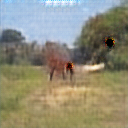

epoch: 61/5000, batch: 100/1067, GA2B_loss: 2.4335408210754395, GB2A_loss: 2.449841260910034
                             DA_loss: 0.03304537758231163, DB_loss: 0.001572564709931612, CYC_loss: 0.28999266028404236
epoch: 61/5000, batch: 200/1067, GA2B_loss: 1.7788512706756592, GB2A_loss: 2.4795479774475098
                             DA_loss: 0.00618410250172019, DB_loss: 0.10257726907730103, CYC_loss: 0.2959147095680237
epoch: 61/5000, batch: 300/1067, GA2B_loss: 2.0019443035125732, GB2A_loss: 2.001166820526123
                             DA_loss: 0.007822717539966106, DB_loss: 6.43817554824011e-10, CYC_loss: 0.20040148496627808
epoch: 61/5000, batch: 400/1067, GA2B_loss: 2.7041172981262207, GB2A_loss: 1.8574103116989136
                             DA_loss: 0.18896502256393433, DB_loss: 2.988197820741334e-06, CYC_loss: 0.34180012345314026
epoch: 61/5000, batch: 500/1067, GA2B_loss: 2.699658155441284, GB2A_loss: 2.6997408866882324
                             DA_loss: 5.1756170904582

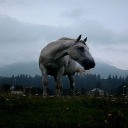

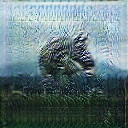

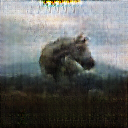

epoch: 62/5000, batch: 100/1067, GA2B_loss: 3.1354899406433105, GB2A_loss: 3.1267831325531006
                             DA_loss: 5.79500338062644e-05, DB_loss: 1.171597159554949e-05, CYC_loss: 0.42902871966362
epoch: 62/5000, batch: 200/1067, GA2B_loss: 2.7633509635925293, GB2A_loss: 2.7697815895080566
                             DA_loss: 1.7022788512122133e-08, DB_loss: 5.232396233623149e-06, CYC_loss: 0.35396113991737366
epoch: 62/5000, batch: 300/1067, GA2B_loss: 2.8503754138946533, GB2A_loss: 2.8536243438720703
                             DA_loss: 2.5246096768682946e-08, DB_loss: 1.6375043969674152e-06, CYC_loss: 0.3707983195781708
epoch: 62/5000, batch: 400/1067, GA2B_loss: 2.606093406677246, GB2A_loss: 2.5908169746398926
                             DA_loss: 3.690787707455456e-05, DB_loss: 2.558409164521436e-07, CYC_loss: 0.3212277889251709
epoch: 62/5000, batch: 500/1067, GA2B_loss: 1.7204248905181885, GB2A_loss: 1.8131788969039917
                             DA_loss: 0.00

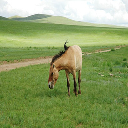

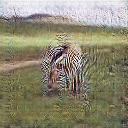

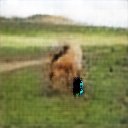

epoch: 63/5000, batch: 100/1067, GA2B_loss: 2.5866646766662598, GB2A_loss: 2.5865774154663086
                             DA_loss: 3.981599093094701e-06, DB_loss: 1.1904942311957711e-06, CYC_loss: 0.3173332214355469
epoch: 63/5000, batch: 200/1067, GA2B_loss: 2.9492621421813965, GB2A_loss: 2.949650526046753
                             DA_loss: 0.0003284561389591545, DB_loss: 4.841515988118772e-08, CYC_loss: 0.3899363577365875
epoch: 63/5000, batch: 300/1067, GA2B_loss: 2.7093491554260254, GB2A_loss: 2.705491781234741
                             DA_loss: 0.000247000134550035, DB_loss: 1.2673781668581796e-07, CYC_loss: 0.34197646379470825
epoch: 63/5000, batch: 400/1067, GA2B_loss: 2.8159375190734863, GB2A_loss: 2.808485269546509
                             DA_loss: 1.4358820408233441e-05, DB_loss: 0.0029203356243669987, CYC_loss: 0.36366668343544006
epoch: 63/5000, batch: 500/1067, GA2B_loss: 2.0916779041290283, GB2A_loss: 2.103135108947754
                             DA_loss: 3.72

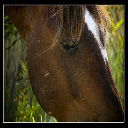

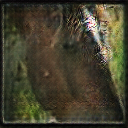

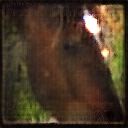

epoch: 64/5000, batch: 100/1067, GA2B_loss: 2.4773387908935547, GB2A_loss: 2.477384567260742
                             DA_loss: 4.689434263127623e-06, DB_loss: 0.00023351241543423384, CYC_loss: 0.29547956585884094
epoch: 64/5000, batch: 200/1067, GA2B_loss: 2.213186740875244, GB2A_loss: 2.21488356590271
                             DA_loss: 0.0005018920637667179, DB_loss: 0.00016768526984378695, CYC_loss: 0.24989524483680725
epoch: 64/5000, batch: 300/1067, GA2B_loss: 2.4743614196777344, GB2A_loss: 2.4666647911071777
                             DA_loss: 1.1316533345961943e-05, DB_loss: 1.8817341924659559e-06, CYC_loss: 0.2948751747608185
epoch: 64/5000, batch: 400/1067, GA2B_loss: 2.7753610610961914, GB2A_loss: 2.479076862335205
                             DA_loss: 0.01303594745695591, DB_loss: 0.0024224575608968735, CYC_loss: 0.3551832437515259
epoch: 64/5000, batch: 500/1067, GA2B_loss: 2.4216833114624023, GB2A_loss: 2.4212419986724854
                             DA_loss: 5.021

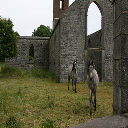

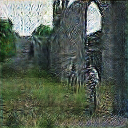

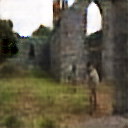

epoch: 65/5000, batch: 100/1067, GA2B_loss: 2.173966884613037, GB2A_loss: 2.1683411598205566
                             DA_loss: 0.00012127612717449665, DB_loss: 1.1006751776676538e-07, CYC_loss: 0.23498043417930603
epoch: 65/5000, batch: 200/1067, GA2B_loss: 2.4059910774230957, GB2A_loss: 2.405226469039917
                             DA_loss: 0.00082988670328632, DB_loss: 2.18951881834073e-05, CYC_loss: 0.28120067715644836
epoch: 65/5000, batch: 300/1067, GA2B_loss: 2.7303051948547363, GB2A_loss: 2.7309954166412354
                             DA_loss: 2.193178624820824e-11, DB_loss: 7.570518505417567e-07, CYC_loss: 0.34620171785354614
epoch: 65/5000, batch: 400/1067, GA2B_loss: 2.1502487659454346, GB2A_loss: 2.1377573013305664
                             DA_loss: 3.4073644201271236e-05, DB_loss: 2.8079250114387833e-05, CYC_loss: 0.23076078295707703
epoch: 65/5000, batch: 500/1067, GA2B_loss: 2.088249921798706, GB2A_loss: 2.1406002044677734
                             DA_loss: 0.

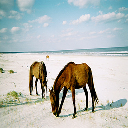

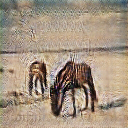

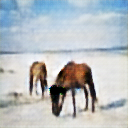

epoch: 66/5000, batch: 100/1067, GA2B_loss: 2.070786952972412, GB2A_loss: 2.063490152359009
                             DA_loss: 0.00014419770741369575, DB_loss: 1.520889298944894e-07, CYC_loss: 0.21415790915489197
epoch: 66/5000, batch: 200/1067, GA2B_loss: 3.12846302986145, GB2A_loss: 3.124115467071533
                             DA_loss: 1.408938715030672e-05, DB_loss: 4.869757049164036e-06, CYC_loss: 0.42693859338760376
epoch: 66/5000, batch: 300/1067, GA2B_loss: 2.4123830795288086, GB2A_loss: 2.4080710411071777
                             DA_loss: 0.0001024277662509121, DB_loss: 5.964597704632979e-09, CYC_loss: 0.2825202941894531
epoch: 66/5000, batch: 400/1067, GA2B_loss: 2.1397876739501953, GB2A_loss: 2.087296485900879
                             DA_loss: 0.00036819151137024164, DB_loss: 2.2283853468252346e-05, CYC_loss: 0.22796109318733215
epoch: 66/5000, batch: 500/1067, GA2B_loss: 2.404766798019409, GB2A_loss: 2.404722213745117
                             DA_loss: 1.5207

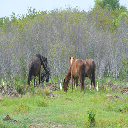

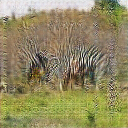

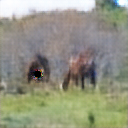

epoch: 67/5000, batch: 100/1067, GA2B_loss: 1.968414545059204, GB2A_loss: 2.668224334716797
                             DA_loss: 1.863708476435022e-08, DB_loss: 0.10220025479793549, CYC_loss: 0.33364546298980713
epoch: 67/5000, batch: 200/1067, GA2B_loss: 2.2646493911743164, GB2A_loss: 2.2426321506500244
                             DA_loss: 0.026771413162350655, DB_loss: 2.5259058020310476e-05, CYC_loss: 0.2551030218601227
epoch: 67/5000, batch: 300/1067, GA2B_loss: 2.3289692401885986, GB2A_loss: 2.3366892337799072
                             DA_loss: 4.935824563290225e-06, DB_loss: 0.0006455102120526135, CYC_loss: 0.26734402775764465
epoch: 67/5000, batch: 400/1067, GA2B_loss: 2.354617118835449, GB2A_loss: 2.3446805477142334
                             DA_loss: 3.788552567129955e-05, DB_loss: 6.862800091766985e-06, CYC_loss: 0.2724025845527649
epoch: 67/5000, batch: 500/1067, GA2B_loss: 2.4550857543945312, GB2A_loss: 2.539233446121216
                             DA_loss: 7.004153

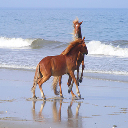

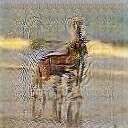

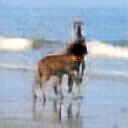

epoch: 68/5000, batch: 100/1067, GA2B_loss: 2.54453182220459, GB2A_loss: 2.324613094329834
                             DA_loss: 0.006818847265094519, DB_loss: 0.00014480447862297297, CYC_loss: 0.30890730023384094
epoch: 68/5000, batch: 200/1067, GA2B_loss: 2.250824451446533, GB2A_loss: 2.248197317123413
                             DA_loss: 2.039614992099814e-05, DB_loss: 7.897548170987534e-10, CYC_loss: 0.25018078088760376
epoch: 68/5000, batch: 300/1067, GA2B_loss: 2.077087163925171, GB2A_loss: 3.016108989715576
                             DA_loss: 1.8948624358472443e-07, DB_loss: 0.28369471430778503, CYC_loss: 0.4032405614852905
epoch: 68/5000, batch: 400/1067, GA2B_loss: 2.3138480186462402, GB2A_loss: 2.313296318054199
                             DA_loss: 0.003191697411239147, DB_loss: 5.178906636871261e-09, CYC_loss: 0.26281028985977173
epoch: 68/5000, batch: 500/1067, GA2B_loss: 2.535715103149414, GB2A_loss: 1.7977863550186157
                             DA_loss: 0.1192684248

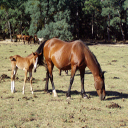

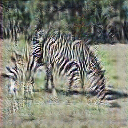

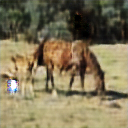

epoch: 69/5000, batch: 100/1067, GA2B_loss: 2.766577959060669, GB2A_loss: 2.765127182006836
                             DA_loss: 0.00066615134710446, DB_loss: 4.71141570201894e-10, CYC_loss: 0.3533278703689575
epoch: 69/5000, batch: 200/1067, GA2B_loss: 2.475572109222412, GB2A_loss: 2.4751033782958984
                             DA_loss: 0.0008340731146745384, DB_loss: 2.5661508971097646e-06, CYC_loss: 0.2951807677745819
epoch: 69/5000, batch: 300/1067, GA2B_loss: 2.573937177658081, GB2A_loss: 2.5738730430603027
                             DA_loss: 1.3164378920293984e-08, DB_loss: 0.06652689725160599, CYC_loss: 0.31480756402015686
epoch: 69/5000, batch: 400/1067, GA2B_loss: 2.1537187099456787, GB2A_loss: 1.7582826614379883
                             DA_loss: 0.02478257194161415, DB_loss: 3.742422194363826e-08, CYC_loss: 0.2307964414358139
epoch: 69/5000, batch: 500/1067, GA2B_loss: 2.4213104248046875, GB2A_loss: 2.4212324619293213
                             DA_loss: 2.9733158953

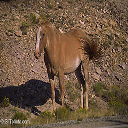

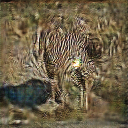

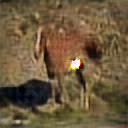

epoch: 70/5000, batch: 100/1067, GA2B_loss: 2.493417739868164, GB2A_loss: 2.4645724296569824
                             DA_loss: 0.000151551648741588, DB_loss: 0.00033837268711067736, CYC_loss: 0.2998178005218506
epoch: 70/5000, batch: 200/1067, GA2B_loss: 2.340877056121826, GB2A_loss: 2.338002920150757
                             DA_loss: 8.943838111008517e-06, DB_loss: 3.711496901814826e-06, CYC_loss: 0.26926374435424805
epoch: 70/5000, batch: 300/1067, GA2B_loss: 2.617260456085205, GB2A_loss: 2.616966485977173
                             DA_loss: 0.008061629720032215, DB_loss: 3.533396863986127e-08, CYC_loss: 0.3235575556755066
epoch: 70/5000, batch: 400/1067, GA2B_loss: 2.500168800354004, GB2A_loss: 2.499706983566284
                             DA_loss: 5.78248489091493e-07, DB_loss: 7.391804501821753e-06, CYC_loss: 0.30003976821899414
epoch: 70/5000, batch: 500/1067, GA2B_loss: 2.3525166511535645, GB2A_loss: 2.3511576652526855
                             DA_loss: 6.963907708

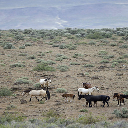

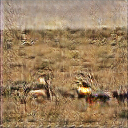

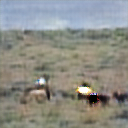

epoch: 71/5000, batch: 100/1067, GA2B_loss: 2.626288890838623, GB2A_loss: 2.532045841217041
                             DA_loss: 0.001183926360681653, DB_loss: 3.2656540582820526e-08, CYC_loss: 0.3253014087677002
epoch: 71/5000, batch: 200/1067, GA2B_loss: 2.2746589183807373, GB2A_loss: 2.273977279663086
                             DA_loss: 0.037466567009687424, DB_loss: 0.0005268295062705874, CYC_loss: 0.2550036311149597
epoch: 71/5000, batch: 300/1067, GA2B_loss: 2.470066785812378, GB2A_loss: 2.4700417518615723
                             DA_loss: 4.7731742824908e-07, DB_loss: 0.00035417338949628174, CYC_loss: 0.2940523624420166
epoch: 71/5000, batch: 400/1067, GA2B_loss: 2.0345020294189453, GB2A_loss: 2.031362771987915
                             DA_loss: 4.067978352395585e-06, DB_loss: 8.173262244781654e-07, CYC_loss: 0.20741146802902222
epoch: 71/5000, batch: 500/1067, GA2B_loss: 2.3830208778381348, GB2A_loss: 2.3832616806030273
                             DA_loss: 0.00131740

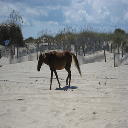

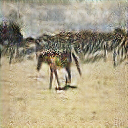

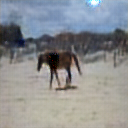

epoch: 72/5000, batch: 100/1067, GA2B_loss: 2.5520429611206055, GB2A_loss: 2.539499044418335
                             DA_loss: 5.660895476466976e-05, DB_loss: 2.6892007554124575e-06, CYC_loss: 0.3113083243370056
epoch: 72/5000, batch: 200/1067, GA2B_loss: 2.3514111042022705, GB2A_loss: 2.344479560852051
                             DA_loss: 6.355179266392952e-06, DB_loss: 5.010057975596283e-06, CYC_loss: 0.2703191041946411
epoch: 72/5000, batch: 300/1067, GA2B_loss: 2.47328519821167, GB2A_loss: 2.472740650177002
                             DA_loss: 8.257653405507881e-08, DB_loss: 1.2649323366531462e-08, CYC_loss: 0.29471057653427124
epoch: 72/5000, batch: 400/1067, GA2B_loss: 2.5174643993377686, GB2A_loss: 2.5169379711151123
                             DA_loss: 3.501930768834427e-05, DB_loss: 0.00017097567615564913, CYC_loss: 0.30349698662757874
epoch: 72/5000, batch: 500/1067, GA2B_loss: 1.9392597675323486, GB2A_loss: 1.8885658979415894
                             DA_loss: 0.00

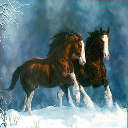

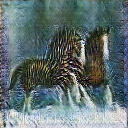

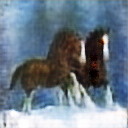

epoch: 73/5000, batch: 100/1067, GA2B_loss: 2.61362624168396, GB2A_loss: 2.6172242164611816
                             DA_loss: 6.910448324681795e-10, DB_loss: 1.6484441403008532e-06, CYC_loss: 0.3234459161758423
epoch: 73/5000, batch: 200/1067, GA2B_loss: 2.233586311340332, GB2A_loss: 2.233614921569824
                             DA_loss: 3.2025279779190896e-06, DB_loss: 1.257938890830701e-07, CYC_loss: 0.24672552943229675
epoch: 73/5000, batch: 300/1067, GA2B_loss: 2.7363393306732178, GB2A_loss: 2.7361245155334473
                             DA_loss: 1.292290335186408e-06, DB_loss: 2.8935977525179624e-07, CYC_loss: 0.34734493494033813
epoch: 73/5000, batch: 400/1067, GA2B_loss: 2.4368038177490234, GB2A_loss: 2.4379401206970215
                             DA_loss: 4.680839396642433e-11, DB_loss: 0.0002117119583999738, CYC_loss: 0.2875918745994568
epoch: 73/5000, batch: 500/1067, GA2B_loss: 2.619762897491455, GB2A_loss: 2.6201605796813965
                             DA_loss: 1.16

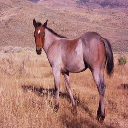

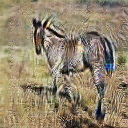

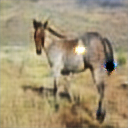

epoch: 74/5000, batch: 100/1067, GA2B_loss: 2.397235870361328, GB2A_loss: 2.3990211486816406
                             DA_loss: 9.315772597773275e-10, DB_loss: 0.00018750726303551346, CYC_loss: 0.27982085943222046
epoch: 74/5000, batch: 200/1067, GA2B_loss: 2.3013715744018555, GB2A_loss: 2.3242034912109375
                             DA_loss: 2.422653366807026e-08, DB_loss: 6.601738277822733e-05, CYC_loss: 0.26484090089797974
epoch: 74/5000, batch: 300/1067, GA2B_loss: 1.9272584915161133, GB2A_loss: 1.9324371814727783
                             DA_loss: 0.0008473858470097184, DB_loss: 3.616363528635702e-06, CYC_loss: 0.1865251362323761
epoch: 74/5000, batch: 400/1067, GA2B_loss: 2.083554983139038, GB2A_loss: 2.0796117782592773
                             DA_loss: 4.81591050629504e-05, DB_loss: 6.345027969700823e-08, CYC_loss: 0.21671658754348755
epoch: 74/5000, batch: 500/1067, GA2B_loss: 2.27164888381958, GB2A_loss: 2.2637407779693604
                             DA_loss: 2.447

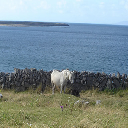

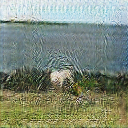

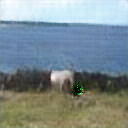

epoch: 75/5000, batch: 100/1067, GA2B_loss: 2.0098423957824707, GB2A_loss: 2.0161492824554443
                             DA_loss: 0.004738796502351761, DB_loss: 5.1117576731485315e-06, CYC_loss: 0.2032453864812851
epoch: 75/5000, batch: 200/1067, GA2B_loss: 2.0324225425720215, GB2A_loss: 2.034137010574341
                             DA_loss: 4.542738685220371e-10, DB_loss: 9.308286280429456e-06, CYC_loss: 0.20683874189853668
epoch: 75/5000, batch: 300/1067, GA2B_loss: 2.541203022003174, GB2A_loss: 2.5318899154663086
                             DA_loss: 0.0002055793156614527, DB_loss: 9.486577255302109e-06, CYC_loss: 0.309977650642395
epoch: 75/5000, batch: 400/1067, GA2B_loss: 2.119274139404297, GB2A_loss: 2.119239330291748
                             DA_loss: 2.1209094924756755e-08, DB_loss: 1.312423780763794e-10, CYC_loss: 0.22386132180690765
epoch: 75/5000, batch: 500/1067, GA2B_loss: 2.6871325969696045, GB2A_loss: 2.697108507156372
                             DA_loss: 2.46680

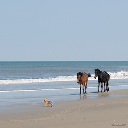

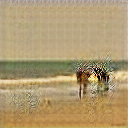

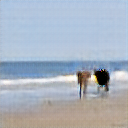

epoch: 76/5000, batch: 100/1067, GA2B_loss: 2.8074281215667725, GB2A_loss: 2.8038625717163086
                             DA_loss: 3.1889772799331695e-05, DB_loss: 3.507395762714083e-10, CYC_loss: 0.3614957332611084
epoch: 76/5000, batch: 200/1067, GA2B_loss: 2.2676193714141846, GB2A_loss: 2.269360065460205
                             DA_loss: 1.56441474246094e-05, DB_loss: 4.890154059467022e-07, CYC_loss: 0.2539192736148834
epoch: 76/5000, batch: 300/1067, GA2B_loss: 2.707141399383545, GB2A_loss: 2.7072391510009766
                             DA_loss: 3.1807114282855764e-05, DB_loss: 4.875237991086578e-09, CYC_loss: 0.3414677679538727
epoch: 76/5000, batch: 400/1067, GA2B_loss: 2.218461513519287, GB2A_loss: 2.2242186069488525
                             DA_loss: 4.642807311938668e-07, DB_loss: 4.3974573600280564e-06, CYC_loss: 0.24487456679344177
epoch: 76/5000, batch: 500/1067, GA2B_loss: 2.4829189777374268, GB2A_loss: 2.5214805603027344
                             DA_loss: 0.00

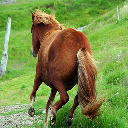

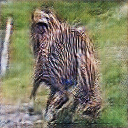

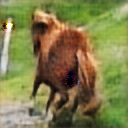

epoch: 77/5000, batch: 100/1067, GA2B_loss: 1.6446101665496826, GB2A_loss: 2.2807083129882812
                             DA_loss: 1.8439955965732224e-05, DB_loss: 0.0787336528301239, CYC_loss: 0.25615718960762024
epoch: 77/5000, batch: 200/1067, GA2B_loss: 2.373117446899414, GB2A_loss: 2.3740639686584473
                             DA_loss: 9.979365813705954e-07, DB_loss: 1.140645125019546e-07, CYC_loss: 0.2748142182826996
epoch: 77/5000, batch: 300/1067, GA2B_loss: 2.465303421020508, GB2A_loss: 2.465365409851074
                             DA_loss: 0.00020190193026792258, DB_loss: 4.778109541803133e-06, CYC_loss: 0.2930731773376465
epoch: 77/5000, batch: 400/1067, GA2B_loss: 2.515881061553955, GB2A_loss: 2.5158731937408447
                             DA_loss: 1.0249121863703525e-11, DB_loss: 1.2082320921535938e-08, CYC_loss: 0.3031764626502991
epoch: 77/5000, batch: 500/1067, GA2B_loss: 2.2268829345703125, GB2A_loss: 2.2235500812530518
                             DA_loss: 1.3946

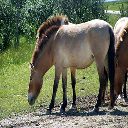

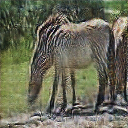

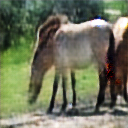

epoch: 78/5000, batch: 100/1067, GA2B_loss: 2.6106650829315186, GB2A_loss: 2.528836727142334
                             DA_loss: 0.0008734400034882128, DB_loss: 3.756389865827714e-09, CYC_loss: 0.3221362233161926
epoch: 78/5000, batch: 200/1067, GA2B_loss: 1.9540174007415771, GB2A_loss: 1.9587140083312988
                             DA_loss: 2.4474749338310176e-08, DB_loss: 2.965434305224335e-06, CYC_loss: 0.1917763501405716
epoch: 78/5000, batch: 300/1067, GA2B_loss: 2.955585479736328, GB2A_loss: 2.9558143615722656
                             DA_loss: 8.961179021049759e-10, DB_loss: 2.7910604330827482e-05, CYC_loss: 0.39117980003356934
epoch: 78/5000, batch: 400/1067, GA2B_loss: 2.2063374519348145, GB2A_loss: 2.192152738571167
                             DA_loss: 4.477971378946677e-05, DB_loss: 2.7462278922030237e-06, CYC_loss: 0.2421918511390686
epoch: 78/5000, batch: 500/1067, GA2B_loss: 2.685262680053711, GB2A_loss: 2.6949620246887207
                             DA_loss: 4.92

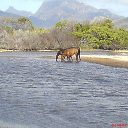

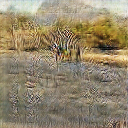

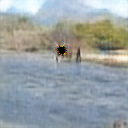

epoch: 79/5000, batch: 100/1067, GA2B_loss: 2.2802131175994873, GB2A_loss: 2.279911756515503
                             DA_loss: 2.724900014072773e-06, DB_loss: 0.00044887152034789324, CYC_loss: 0.25604456663131714
epoch: 79/5000, batch: 200/1067, GA2B_loss: 2.2695412635803223, GB2A_loss: 2.2688231468200684
                             DA_loss: 4.208190205190476e-07, DB_loss: 2.77950306326602e-07, CYC_loss: 0.25391340255737305
epoch: 79/5000, batch: 300/1067, GA2B_loss: 2.3427696228027344, GB2A_loss: 2.337536096572876
                             DA_loss: 3.446351911406964e-06, DB_loss: 0.00044135606731288135, CYC_loss: 0.2685539126396179
epoch: 79/5000, batch: 400/1067, GA2B_loss: 2.4158742427825928, GB2A_loss: 2.3865416049957275
                             DA_loss: 0.0001091790254577063, DB_loss: 1.0259515676250275e-12, CYC_loss: 0.28317540884017944
epoch: 79/5000, batch: 500/1067, GA2B_loss: 2.3549206256866455, GB2A_loss: 2.3430886268615723
                             DA_loss: 0

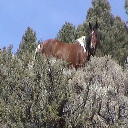

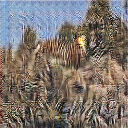

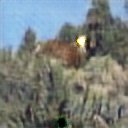

epoch: 80/5000, batch: 100/1067, GA2B_loss: 2.1702723503112793, GB2A_loss: 2.2041730880737305
                             DA_loss: 0.00021663990628439933, DB_loss: 0.0001463162334403023, CYC_loss: 0.24083854258060455
epoch: 80/5000, batch: 200/1067, GA2B_loss: 2.4851977825164795, GB2A_loss: 2.484790563583374
                             DA_loss: 2.9148729652206384e-08, DB_loss: 9.28296586266697e-08, CYC_loss: 0.297039657831192
epoch: 80/5000, batch: 300/1067, GA2B_loss: 2.4035255908966064, GB2A_loss: 2.4098124504089355
                             DA_loss: 9.952344043995254e-06, DB_loss: 5.663006504619261e-06, CYC_loss: 0.2820489704608917
epoch: 80/5000, batch: 400/1067, GA2B_loss: 2.5072436332702637, GB2A_loss: 2.509225368499756
                             DA_loss: 6.792077567041588e-09, DB_loss: 5.940524943071068e-07, CYC_loss: 0.30188435316085815
epoch: 80/5000, batch: 500/1067, GA2B_loss: 2.5237488746643066, GB2A_loss: 2.5547754764556885
                             DA_loss: 1.36

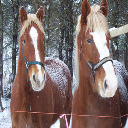

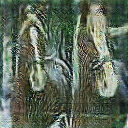

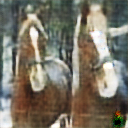

epoch: 81/5000, batch: 100/1067, GA2B_loss: 2.5887932777404785, GB2A_loss: 2.588841438293457
                             DA_loss: 4.305985082386776e-11, DB_loss: 1.0012971074502275e-07, CYC_loss: 0.3177720010280609
epoch: 81/5000, batch: 200/1067, GA2B_loss: 1.968300223350525, GB2A_loss: 0.9685034155845642
                             DA_loss: 0.4862140119075775, DB_loss: 0.06426219642162323, CYC_loss: 0.1936621367931366
epoch: 81/5000, batch: 300/1067, GA2B_loss: 2.08328914642334, GB2A_loss: 2.0802576541900635
                             DA_loss: 3.19446644425625e-06, DB_loss: 3.152504746140039e-07, CYC_loss: 0.21697118878364563
epoch: 81/5000, batch: 400/1067, GA2B_loss: 2.4371590614318848, GB2A_loss: 1.4631342887878418
                             DA_loss: 0.351876437664032, DB_loss: 6.060329321710967e-11, CYC_loss: 0.28743618726730347
epoch: 81/5000, batch: 500/1067, GA2B_loss: 1.9674551486968994, GB2A_loss: 1.9674365520477295
                             DA_loss: 1.6732695939936

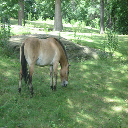

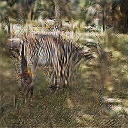

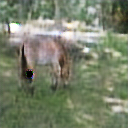

epoch: 82/5000, batch: 100/1067, GA2B_loss: 2.2436368465423584, GB2A_loss: 2.2444465160369873
                             DA_loss: 9.57744923653081e-05, DB_loss: 6.205397085068398e-07, CYC_loss: 0.24917274713516235
epoch: 82/5000, batch: 200/1067, GA2B_loss: 2.38987398147583, GB2A_loss: 2.3899714946746826
                             DA_loss: 0.09072789549827576, DB_loss: 0.0002286009257659316, CYC_loss: 0.2779959738254547
epoch: 82/5000, batch: 300/1067, GA2B_loss: 2.816009283065796, GB2A_loss: 2.816011667251587
                             DA_loss: 2.47192954994091e-09, DB_loss: 1.1101462860096944e-06, CYC_loss: 0.36320382356643677
epoch: 82/5000, batch: 400/1067, GA2B_loss: 2.2867636680603027, GB2A_loss: 2.283271312713623
                             DA_loss: 2.8718097837554524e-06, DB_loss: 2.1134081862328458e-07, CYC_loss: 0.25761178135871887
epoch: 82/5000, batch: 500/1067, GA2B_loss: 2.3833351135253906, GB2A_loss: 2.381572723388672
                             DA_loss: 6.102807

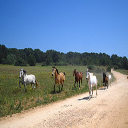

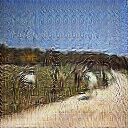

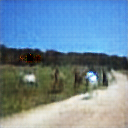

epoch: 83/5000, batch: 100/1067, GA2B_loss: 1.9798592329025269, GB2A_loss: 1.2771294116973877
                             DA_loss: 0.10345332324504852, DB_loss: 0.00013003831554669887, CYC_loss: 0.19599220156669617
epoch: 83/5000, batch: 200/1067, GA2B_loss: 2.254037380218506, GB2A_loss: 2.0008814334869385
                             DA_loss: 0.391457736492157, DB_loss: 6.060597357304687e-09, CYC_loss: 0.2508090138435364
epoch: 83/5000, batch: 300/1067, GA2B_loss: 2.3573715686798096, GB2A_loss: 2.358870029449463
                             DA_loss: 2.1634389835156753e-09, DB_loss: 2.836157477759116e-07, CYC_loss: 0.27177542448043823
epoch: 83/5000, batch: 400/1067, GA2B_loss: 2.4093384742736816, GB2A_loss: 2.409304618835449
                             DA_loss: 7.553842351626372e-06, DB_loss: 4.949827006606178e-11, CYC_loss: 0.2818681299686432
epoch: 83/5000, batch: 500/1067, GA2B_loss: 1.799100637435913, GB2A_loss: 1.7999882698059082
                             DA_loss: 1.13256544

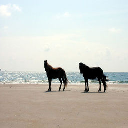

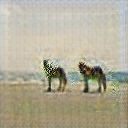

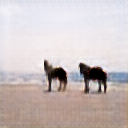

epoch: 84/5000, batch: 100/1067, GA2B_loss: 2.406731128692627, GB2A_loss: 2.4070215225219727
                             DA_loss: 0.08178821206092834, DB_loss: 0.002864086301997304, CYC_loss: 0.2814052700996399
epoch: 84/5000, batch: 200/1067, GA2B_loss: 2.157071590423584, GB2A_loss: 2.1567816734313965
                             DA_loss: 0.0009637704351916909, DB_loss: 1.7765782876939806e-13, CYC_loss: 0.2314143180847168
epoch: 84/5000, batch: 300/1067, GA2B_loss: 2.3668270111083984, GB2A_loss: 2.366389513015747
                             DA_loss: 5.744189820688916e-06, DB_loss: 1.4244333490509575e-09, CYC_loss: 0.27338674664497375
epoch: 84/5000, batch: 400/1067, GA2B_loss: 2.59928822517395, GB2A_loss: 2.5998287200927734
                             DA_loss: 1.9751701074710581e-07, DB_loss: 1.3572991974797333e-07, CYC_loss: 0.3200658857822418
epoch: 84/5000, batch: 500/1067, GA2B_loss: 2.8873023986816406, GB2A_loss: 2.887392520904541
                             DA_loss: 3.204356

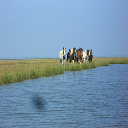

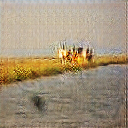

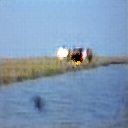

epoch: 85/5000, batch: 100/1067, GA2B_loss: 2.248678684234619, GB2A_loss: 2.2494449615478516
                             DA_loss: 1.9131144654238597e-05, DB_loss: 9.06705963643617e-08, CYC_loss: 0.2498904913663864
epoch: 85/5000, batch: 200/1067, GA2B_loss: 2.497100353240967, GB2A_loss: 2.49702787399292
                             DA_loss: 0.007232604082673788, DB_loss: 3.509808976787099e-08, CYC_loss: 0.2994205355644226
epoch: 85/5000, batch: 300/1067, GA2B_loss: 2.669159173965454, GB2A_loss: 2.669102668762207
                             DA_loss: 8.128286572173238e-05, DB_loss: 3.962760952713751e-10, CYC_loss: 0.3338329493999481
epoch: 85/5000, batch: 400/1067, GA2B_loss: 2.440603733062744, GB2A_loss: 2.440603733062744
                             DA_loss: 6.715027848258615e-05, DB_loss: 2.8206105853745278e-11, CYC_loss: 0.2881208062171936
epoch: 85/5000, batch: 500/1067, GA2B_loss: 2.3688173294067383, GB2A_loss: 2.369019031524658
                             DA_loss: 0.00034965903

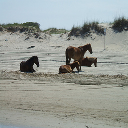

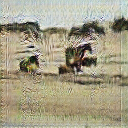

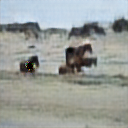

epoch: 86/5000, batch: 100/1067, GA2B_loss: 2.4810338020324707, GB2A_loss: 2.4615485668182373
                             DA_loss: 4.814946441911161e-05, DB_loss: 8.058083949435968e-06, CYC_loss: 0.296215683221817
epoch: 86/5000, batch: 200/1067, GA2B_loss: 1.9281927347183228, GB2A_loss: 1.9281485080718994
                             DA_loss: 4.396056283439975e-07, DB_loss: 0.30898886919021606, CYC_loss: 0.18563854694366455
epoch: 86/5000, batch: 300/1067, GA2B_loss: 2.1236138343811035, GB2A_loss: 2.1248703002929688
                             DA_loss: 4.718846867035609e-06, DB_loss: 1.9750716262478818e-07, CYC_loss: 0.22497408092021942
epoch: 86/5000, batch: 400/1067, GA2B_loss: 2.515657424926758, GB2A_loss: 2.5165557861328125
                             DA_loss: 2.564158307905018e-07, DB_loss: 1.8354569419898326e-07, CYC_loss: 0.3033730983734131
epoch: 86/5000, batch: 500/1067, GA2B_loss: 2.229307174682617, GB2A_loss: 2.2294530868530273
                             DA_loss: 0.000

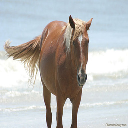

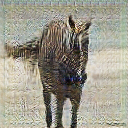

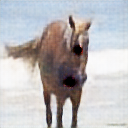

epoch: 87/5000, batch: 100/1067, GA2B_loss: 2.2958366870880127, GB2A_loss: 2.0773496627807617
                             DA_loss: 0.007318468764424324, DB_loss: 9.817248610488605e-06, CYC_loss: 0.26093584299087524
epoch: 87/5000, batch: 200/1067, GA2B_loss: 2.6596732139587402, GB2A_loss: 2.665757656097412
                             DA_loss: 0.1657312661409378, DB_loss: 4.702530986833153e-06, CYC_loss: 0.333159476518631
epoch: 87/5000, batch: 300/1067, GA2B_loss: 2.4032416343688965, GB2A_loss: 2.4113175868988037
                             DA_loss: 1.0289805629781767e-07, DB_loss: 1.0710549759096466e-05, CYC_loss: 0.28244489431381226
epoch: 87/5000, batch: 400/1067, GA2B_loss: 2.1651840209960938, GB2A_loss: 2.1668314933776855
                             DA_loss: 4.742865544749009e-10, DB_loss: 3.4082725619555276e-07, CYC_loss: 0.2333669364452362
epoch: 87/5000, batch: 500/1067, GA2B_loss: 1.849259853363037, GB2A_loss: 1.873661994934082
                             DA_loss: 6.45733

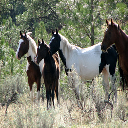

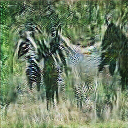

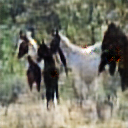

epoch: 88/5000, batch: 100/1067, GA2B_loss: 2.2948474884033203, GB2A_loss: 2.548220634460449
                             DA_loss: 9.659161150921136e-06, DB_loss: 0.009271318092942238, CYC_loss: 0.3097213804721832
epoch: 88/5000, batch: 200/1067, GA2B_loss: 2.344999313354492, GB2A_loss: 2.3451433181762695
                             DA_loss: 2.238027541068277e-08, DB_loss: 8.504612765136699e-07, CYC_loss: 0.26903006434440613
epoch: 88/5000, batch: 300/1067, GA2B_loss: 2.0916476249694824, GB2A_loss: 2.0917277336120605
                             DA_loss: 3.687144101149897e-08, DB_loss: 4.898632255390112e-08, CYC_loss: 0.21845418214797974
epoch: 88/5000, batch: 400/1067, GA2B_loss: 2.470033884048462, GB2A_loss: 1.612179160118103
                             DA_loss: 0.19409538805484772, DB_loss: 8.352163405334068e-08, CYC_loss: 0.29400694370269775
epoch: 88/5000, batch: 500/1067, GA2B_loss: 1.9183285236358643, GB2A_loss: 2.2123780250549316
                             DA_loss: 1.819318

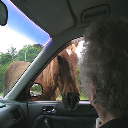

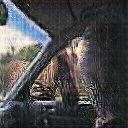

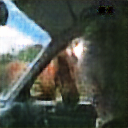

epoch: 89/5000, batch: 100/1067, GA2B_loss: 2.404228925704956, GB2A_loss: 2.4045333862304688
                             DA_loss: 9.182394933304749e-07, DB_loss: 0.0007287594489753246, CYC_loss: 0.2809249460697174
epoch: 89/5000, batch: 200/1067, GA2B_loss: 2.5539660453796387, GB2A_loss: 2.5539660453796387
                             DA_loss: 3.34340802510269e-06, DB_loss: 3.1991547189136327e-09, CYC_loss: 0.3107932209968567
epoch: 89/5000, batch: 300/1067, GA2B_loss: 2.2190043926239014, GB2A_loss: 2.21755051612854
                             DA_loss: 2.911625074375479e-07, DB_loss: 6.430174170901637e-10, CYC_loss: 0.24381524324417114
epoch: 89/5000, batch: 400/1067, GA2B_loss: 2.335181713104248, GB2A_loss: 2.3335213661193848
                             DA_loss: 3.4797136549968855e-07, DB_loss: 0.08936777710914612, CYC_loss: 0.2670366168022156
epoch: 89/5000, batch: 500/1067, GA2B_loss: 2.1391048431396484, GB2A_loss: 2.1391005516052246
                             DA_loss: 4.773844

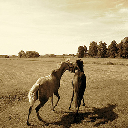

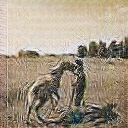

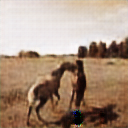

epoch: 90/5000, batch: 100/1067, GA2B_loss: 2.1913304328918457, GB2A_loss: 2.28452730178833
                             DA_loss: 6.129467777782338e-08, DB_loss: 0.001157072139903903, CYC_loss: 0.2570454478263855
epoch: 90/5000, batch: 200/1067, GA2B_loss: 2.3131628036499023, GB2A_loss: 2.312643527984619
                             DA_loss: 1.6741687431931496e-06, DB_loss: 6.051925083738752e-06, CYC_loss: 0.2631734311580658
epoch: 90/5000, batch: 300/1067, GA2B_loss: 2.7695493698120117, GB2A_loss: 2.769547939300537
                             DA_loss: 6.18824633420445e-05, DB_loss: 2.54303089003427e-13, CYC_loss: 0.3539101481437683
epoch: 90/5000, batch: 400/1067, GA2B_loss: 2.260507583618164, GB2A_loss: 2.2514986991882324
                             DA_loss: 1.0322123671357986e-05, DB_loss: 3.7023680761194555e-06, CYC_loss: 0.2521130442619324
epoch: 90/5000, batch: 500/1067, GA2B_loss: 2.478313446044922, GB2A_loss: 2.478313446044922
                             DA_loss: 0.110808886

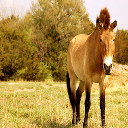

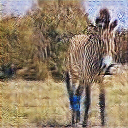

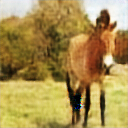

epoch: 91/5000, batch: 100/1067, GA2B_loss: 2.041285514831543, GB2A_loss: 1.9732789993286133
                             DA_loss: 0.0007651951746083796, DB_loss: 3.819775329372277e-10, CYC_loss: 0.2082681953907013
epoch: 91/5000, batch: 200/1067, GA2B_loss: 2.2651562690734863, GB2A_loss: 2.2603530883789062
                             DA_loss: 3.191825044268626e-06, DB_loss: 3.772472556562434e-09, CYC_loss: 0.25306493043899536
epoch: 91/5000, batch: 300/1067, GA2B_loss: 2.6318717002868652, GB2A_loss: 2.525156259536743
                             DA_loss: 0.0015255046309903264, DB_loss: 0.0003680032677948475, CYC_loss: 0.32651543617248535
epoch: 91/5000, batch: 400/1067, GA2B_loss: 2.4310333728790283, GB2A_loss: 2.401338577270508
                             DA_loss: 0.0001119007429224439, DB_loss: 1.340342919320392e-06, CYC_loss: 0.2862066626548767
epoch: 91/5000, batch: 500/1067, GA2B_loss: 2.150930881500244, GB2A_loss: 2.159425735473633
                             DA_loss: 1.87230

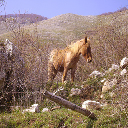

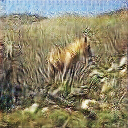

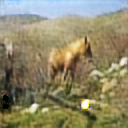

epoch: 92/5000, batch: 100/1067, GA2B_loss: 1.9260191917419434, GB2A_loss: 2.0884199142456055
                             DA_loss: 0.4733971953392029, DB_loss: 0.019854547455906868, CYC_loss: 0.21768775582313538
epoch: 92/5000, batch: 200/1067, GA2B_loss: 2.251328945159912, GB2A_loss: 2.2529232501983643
                             DA_loss: 1.5276262956831488e-06, DB_loss: 3.474283687410207e-07, CYC_loss: 0.25058814883232117
epoch: 92/5000, batch: 300/1067, GA2B_loss: 2.2972354888916016, GB2A_loss: 2.297234535217285
                             DA_loss: 0.003595485119149089, DB_loss: 1.9113564897477175e-12, CYC_loss: 0.2594473958015442
epoch: 92/5000, batch: 400/1067, GA2B_loss: 2.047222137451172, GB2A_loss: 2.046487808227539
                             DA_loss: 1.4521558000524237e-07, DB_loss: 2.4874562853938187e-08, CYC_loss: 0.20951306819915771
epoch: 92/5000, batch: 500/1067, GA2B_loss: 2.2555360794067383, GB2A_loss: 2.2558834552764893
                             DA_loss: 1.7212

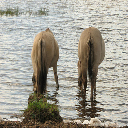

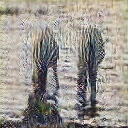

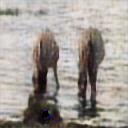

epoch: 93/5000, batch: 100/1067, GA2B_loss: 2.7020418643951416, GB2A_loss: 2.7021923065185547
                             DA_loss: 0.0010762454476207495, DB_loss: 3.0878224421826417e-09, CYC_loss: 0.34043848514556885
epoch: 93/5000, batch: 200/1067, GA2B_loss: 2.217895030975342, GB2A_loss: 2.2178494930267334
                             DA_loss: 0.0013379307929426432, DB_loss: 0.0003881292650476098, CYC_loss: 0.24357905983924866
epoch: 93/5000, batch: 300/1067, GA2B_loss: 2.0275869369506836, GB2A_loss: 2.0275139808654785
                             DA_loss: 1.5505225992029636e-09, DB_loss: 1.8255179312642866e-10, CYC_loss: 0.20552504062652588
epoch: 93/5000, batch: 400/1067, GA2B_loss: 2.310046911239624, GB2A_loss: 2.310703992843628
                             DA_loss: 9.902090258862017e-10, DB_loss: 6.96311133197014e-08, CYC_loss: 0.26215842366218567
epoch: 93/5000, batch: 500/1067, GA2B_loss: 2.3116462230682373, GB2A_loss: 2.311650276184082
                             DA_loss: 1.

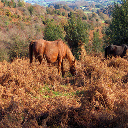

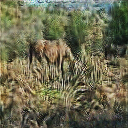

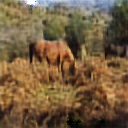

epoch: 94/5000, batch: 100/1067, GA2B_loss: 2.1441705226898193, GB2A_loss: 2.1441895961761475
                             DA_loss: 0.0008398974896408617, DB_loss: 9.224919631378725e-05, CYC_loss: 0.2288520485162735
epoch: 94/5000, batch: 200/1067, GA2B_loss: 2.534454822540283, GB2A_loss: 2.534123420715332
                             DA_loss: 1.3870455006781413e-08, DB_loss: 2.5996338762213078e-11, CYC_loss: 0.3068913221359253
epoch: 94/5000, batch: 300/1067, GA2B_loss: 2.4288063049316406, GB2A_loss: 2.428042411804199
                             DA_loss: 8.458538758304712e-08, DB_loss: 5.9722791775129735e-05, CYC_loss: 0.2857667803764343
epoch: 94/5000, batch: 400/1067, GA2B_loss: 1.6361055374145508, GB2A_loss: 2.4680421352386475
                             DA_loss: 0.0009068615618161857, DB_loss: 0.17483998835086823, CYC_loss: 0.2938200831413269
epoch: 94/5000, batch: 500/1067, GA2B_loss: 1.9217618703842163, GB2A_loss: 1.921180248260498
                             DA_loss: 5.80336

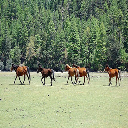

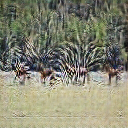

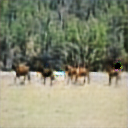

epoch: 95/5000, batch: 100/1067, GA2B_loss: 2.406062602996826, GB2A_loss: 2.4051718711853027
                             DA_loss: 9.92131816701658e-08, DB_loss: 8.637131543309806e-08, CYC_loss: 0.2812125086784363
epoch: 95/5000, batch: 200/1067, GA2B_loss: 1.9835205078125, GB2A_loss: 1.9835333824157715
                             DA_loss: 6.083582348992422e-08, DB_loss: 3.98483572527919e-11, CYC_loss: 0.19670763611793518
epoch: 95/5000, batch: 300/1067, GA2B_loss: 2.4245142936706543, GB2A_loss: 2.42410945892334
                             DA_loss: 2.059464598858085e-08, DB_loss: 1.0697593033626163e-08, CYC_loss: 0.28490307927131653
epoch: 95/5000, batch: 400/1067, GA2B_loss: 2.196974515914917, GB2A_loss: 1.303203821182251
                             DA_loss: 0.2613585889339447, DB_loss: 0.00011038465891033411, CYC_loss: 0.24529406428337097
epoch: 95/5000, batch: 500/1067, GA2B_loss: 2.357177734375, GB2A_loss: 2.3432912826538086
                             DA_loss: 2.43168342421995

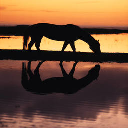

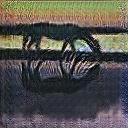

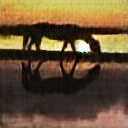

epoch: 96/5000, batch: 100/1067, GA2B_loss: 2.2065305709838867, GB2A_loss: 2.186159133911133
                             DA_loss: 5.241564940661192e-05, DB_loss: 0.009071964770555496, CYC_loss: 0.2413061261177063
epoch: 96/5000, batch: 200/1067, GA2B_loss: 2.5569510459899902, GB2A_loss: 2.5567312240600586
                             DA_loss: 6.071330549417553e-09, DB_loss: 0.04670735448598862, CYC_loss: 0.3113902807235718
epoch: 96/5000, batch: 300/1067, GA2B_loss: 1.1928966045379639, GB2A_loss: 2.1928482055664062
                             DA_loss: 1.095923685134892e-09, DB_loss: 0.498664915561676, CYC_loss: 0.23857896029949188
epoch: 96/5000, batch: 400/1067, GA2B_loss: 2.0827789306640625, GB2A_loss: 2.0778615474700928
                             DA_loss: 3.0324156341521302e-06, DB_loss: 2.5155358351902635e-10, CYC_loss: 0.21655616164207458
epoch: 96/5000, batch: 500/1067, GA2B_loss: 2.0487077236175537, GB2A_loss: 2.0487077236175537
                             DA_loss: 1.804892

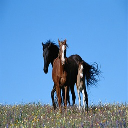

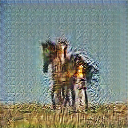

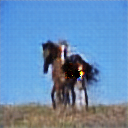

epoch: 97/5000, batch: 100/1067, GA2B_loss: 2.51973557472229, GB2A_loss: 2.5192811489105225
                             DA_loss: 8.767978556534217e-07, DB_loss: 1.9111356941436952e-10, CYC_loss: 0.3039471507072449
epoch: 97/5000, batch: 200/1067, GA2B_loss: 2.415996551513672, GB2A_loss: 2.418174982070923
                             DA_loss: 4.435116807144368e-08, DB_loss: 9.475562592342612e-07, CYC_loss: 0.2837495803833008
epoch: 97/5000, batch: 300/1067, GA2B_loss: 2.7814855575561523, GB2A_loss: 2.781461238861084
                             DA_loss: 0.020772460848093033, DB_loss: 2.594891246321396e-10, CYC_loss: 0.35630056262016296
epoch: 97/5000, batch: 400/1067, GA2B_loss: 2.2733240127563477, GB2A_loss: 2.273343324661255
                             DA_loss: 2.868713977477455e-08, DB_loss: 2.0228903274688292e-10, CYC_loss: 0.25467273592948914
epoch: 97/5000, batch: 500/1067, GA2B_loss: 2.0282199382781982, GB2A_loss: 1.6540946960449219
                             DA_loss: 0.04302

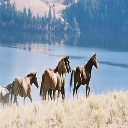

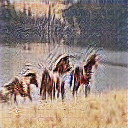

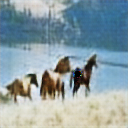

epoch: 98/5000, batch: 100/1067, GA2B_loss: 2.3856444358825684, GB2A_loss: 2.385468006134033
                             DA_loss: 0.00024554054834879935, DB_loss: 5.3620373364537954e-05, CYC_loss: 0.27712905406951904
epoch: 98/5000, batch: 200/1067, GA2B_loss: 2.1493706703186035, GB2A_loss: 2.148500919342041
                             DA_loss: 9.786475629880442e-08, DB_loss: 2.2033313840097435e-08, CYC_loss: 0.22987602651119232
epoch: 98/5000, batch: 300/1067, GA2B_loss: 2.0753750801086426, GB2A_loss: 2.0753469467163086
                             DA_loss: 1.614974462427199e-05, DB_loss: 1.944403971165798e-09, CYC_loss: 0.2150755375623703
epoch: 98/5000, batch: 400/1067, GA2B_loss: 2.452078342437744, GB2A_loss: 2.4515295028686523
                             DA_loss: 4.1945700246515116e-08, DB_loss: 3.1035403935675276e-06, CYC_loss: 0.290421724319458
epoch: 98/5000, batch: 500/1067, GA2B_loss: 1.8114168643951416, GB2A_loss: 1.8103184700012207
                             DA_loss: 1

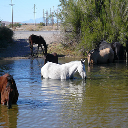

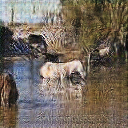

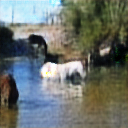

epoch: 99/5000, batch: 100/1067, GA2B_loss: 2.4321703910827637, GB2A_loss: 2.4326395988464355
                             DA_loss: 6.271050369832665e-05, DB_loss: 3.446514895699693e-08, CYC_loss: 0.28653910756111145
epoch: 99/5000, batch: 200/1067, GA2B_loss: 2.9774913787841797, GB2A_loss: 2.9743266105651855
                             DA_loss: 1.2728669389616698e-06, DB_loss: 0.00016295963723678142, CYC_loss: 0.3954998552799225
epoch: 99/5000, batch: 300/1067, GA2B_loss: 2.32804012298584, GB2A_loss: 2.321481466293335
                             DA_loss: 1.580664684297517e-05, DB_loss: 2.7176024559594225e-06, CYC_loss: 0.26653289794921875
epoch: 99/5000, batch: 400/1067, GA2B_loss: 2.2671051025390625, GB2A_loss: 2.1168675422668457
                             DA_loss: 0.003144635120406747, DB_loss: 5.430994178823312e-07, CYC_loss: 0.2538376450538635
epoch: 99/5000, batch: 500/1067, GA2B_loss: 2.238309621810913, GB2A_loss: 2.2382826805114746
                             DA_loss: 0.00

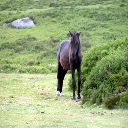

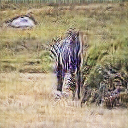

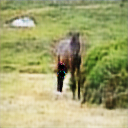

epoch: 100/5000, batch: 100/1067, GA2B_loss: 1.86585533618927, GB2A_loss: 1.8658431768417358
                             DA_loss: 3.5623973215770377e-10, DB_loss: 1.279163461731514e-05, CYC_loss: 0.17317107319831848
epoch: 100/5000, batch: 200/1067, GA2B_loss: 2.4991750717163086, GB2A_loss: 2.499175786972046
                             DA_loss: 1.5301634959108412e-11, DB_loss: 6.006270041325479e-07, CYC_loss: 0.2998366057872772
epoch: 100/5000, batch: 300/1067, GA2B_loss: 1.9310497045516968, GB2A_loss: 1.9282605648040771
                             DA_loss: 0.0033900137059390545, DB_loss: 9.403805961483158e-06, CYC_loss: 0.18620994687080383
epoch: 100/5000, batch: 400/1067, GA2B_loss: 2.124302864074707, GB2A_loss: 2.124208927154541
                             DA_loss: 8.074382051859175e-09, DB_loss: 0.0017818642081692815, CYC_loss: 0.22486065328121185
epoch: 100/5000, batch: 500/1067, GA2B_loss: 2.2929489612579346, GB2A_loss: 2.2928426265716553
                             DA_loss:

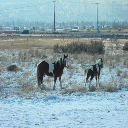

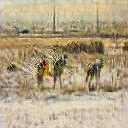

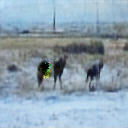

epoch: 101/5000, batch: 100/1067, GA2B_loss: 2.571650505065918, GB2A_loss: 2.5716373920440674
                             DA_loss: 5.746929673478007e-06, DB_loss: 1.1654893716794845e-09, CYC_loss: 0.31433019042015076
epoch: 101/5000, batch: 200/1067, GA2B_loss: 1.9805996417999268, GB2A_loss: 1.9805998802185059
                             DA_loss: 5.350342226011738e-14, DB_loss: 2.0747208747014245e-13, CYC_loss: 0.19612008333206177
epoch: 101/5000, batch: 300/1067, GA2B_loss: 2.239044189453125, GB2A_loss: 2.2280259132385254
                             DA_loss: 2.3686130589339882e-05, DB_loss: 7.524311408039618e-15, CYC_loss: 0.2478088140487671
epoch: 101/5000, batch: 400/1067, GA2B_loss: 2.0859618186950684, GB2A_loss: 2.0859618186950684
                             DA_loss: 5.578361879088334e-07, DB_loss: 3.335090070777369e-08, CYC_loss: 0.2171923965215683
epoch: 101/5000, batch: 500/1067, GA2B_loss: 2.3811864852905273, GB2A_loss: 2.3811910152435303
                             DA_lo

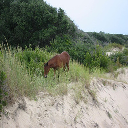

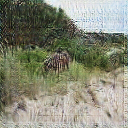

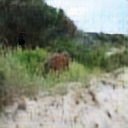

epoch: 102/5000, batch: 100/1067, GA2B_loss: 2.2149388790130615, GB2A_loss: 2.214944362640381
                             DA_loss: 4.126620486294419e-12, DB_loss: 1.2426485227479134e-05, CYC_loss: 0.24298983812332153
epoch: 102/5000, batch: 200/1067, GA2B_loss: 2.1247403621673584, GB2A_loss: 2.1247410774230957
                             DA_loss: 6.29805163043784e-06, DB_loss: 4.4458756676135636e-09, CYC_loss: 0.22494828701019287
epoch: 102/5000, batch: 300/1067, GA2B_loss: 2.211656093597412, GB2A_loss: 2.211653232574463
                             DA_loss: 3.518580342642963e-06, DB_loss: 2.1512443215687682e-10, CYC_loss: 0.24233126640319824
epoch: 102/5000, batch: 400/1067, GA2B_loss: 2.396822214126587, GB2A_loss: 2.3923540115356445
                             DA_loss: 1.7893233234644867e-05, DB_loss: 1.1598662297274132e-07, CYC_loss: 0.27937087416648865
epoch: 102/5000, batch: 500/1067, GA2B_loss: 2.168440818786621, GB2A_loss: 2.1683573722839355
                             DA_lo

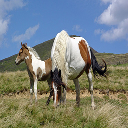

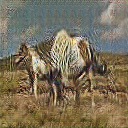

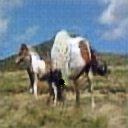

epoch: 103/5000, batch: 100/1067, GA2B_loss: 2.007572650909424, GB2A_loss: 2.0109703540802
                             DA_loss: 3.396532832766752e-08, DB_loss: 7.957689376780763e-05, CYC_loss: 0.20229804515838623
epoch: 103/5000, batch: 200/1067, GA2B_loss: 2.4267053604125977, GB2A_loss: 2.429720878601074
                             DA_loss: 1.1824152768014073e-10, DB_loss: 5.921796400798485e-05, CYC_loss: 0.2859441936016083
epoch: 103/5000, batch: 300/1067, GA2B_loss: 2.569032669067383, GB2A_loss: 2.568666696548462
                             DA_loss: 1.7297912435765284e-08, DB_loss: 4.642775053298465e-09, CYC_loss: 0.3138076663017273
epoch: 103/5000, batch: 400/1067, GA2B_loss: 1.9231581687927246, GB2A_loss: 1.9225428104400635
                             DA_loss: 4.746503634578403e-08, DB_loss: 0.2543916404247284, CYC_loss: 0.18463177978992462
epoch: 103/5000, batch: 500/1067, GA2B_loss: 2.202324867248535, GB2A_loss: 2.2021484375
                             DA_loss: 3.9269685281

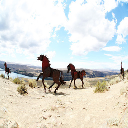

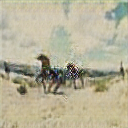

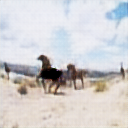

epoch: 104/5000, batch: 100/1067, GA2B_loss: 0.857825517654419, GB2A_loss: 1.8573215007781982
                             DA_loss: 1.94541982523333e-09, DB_loss: 0.47789034247398376, CYC_loss: 0.17146509885787964
epoch: 104/5000, batch: 200/1067, GA2B_loss: 2.4248251914978027, GB2A_loss: 2.4208245277404785
                             DA_loss: 2.0056261291756527e-06, DB_loss: 3.859597530464498e-09, CYC_loss: 0.2849652171134949
epoch: 104/5000, batch: 300/1067, GA2B_loss: 2.363083600997925, GB2A_loss: 2.362802028656006
                             DA_loss: 1.0543931949769103e-08, DB_loss: 2.394478713085846e-07, CYC_loss: 0.2726184129714966
epoch: 104/5000, batch: 400/1067, GA2B_loss: 2.5928232669830322, GB2A_loss: 2.5928637981414795
                             DA_loss: 1.441286467951386e-08, DB_loss: 1.7890920389618259e-06, CYC_loss: 0.31857654452323914
epoch: 104/5000, batch: 500/1067, GA2B_loss: 2.0213959217071533, GB2A_loss: 2.026298999786377
                             DA_loss: 1

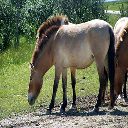

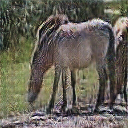

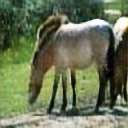

epoch: 105/5000, batch: 100/1067, GA2B_loss: 2.113265037536621, GB2A_loss: 2.114192008972168
                             DA_loss: 4.8020272203075365e-09, DB_loss: 1.110260328118784e-07, CYC_loss: 0.22284039855003357
epoch: 105/5000, batch: 200/1067, GA2B_loss: 1.9450287818908691, GB2A_loss: 1.9452087879180908
                             DA_loss: 0.005353222135454416, DB_loss: 1.0369612724048238e-08, CYC_loss: 0.18906335532665253
epoch: 105/5000, batch: 300/1067, GA2B_loss: 2.049311637878418, GB2A_loss: 2.0491886138916016
                             DA_loss: 3.06959955196362e-05, DB_loss: 2.5526621811877703e-06, CYC_loss: 0.20986393094062805
epoch: 105/5000, batch: 400/1067, GA2B_loss: 1.9119651317596436, GB2A_loss: 1.995031476020813
                             DA_loss: 4.368128081466693e-09, DB_loss: 0.0009035954717546701, CYC_loss: 0.19900676608085632
epoch: 105/5000, batch: 500/1067, GA2B_loss: 2.306820869445801, GB2A_loss: 2.306300163269043
                             DA_loss: 

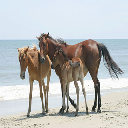

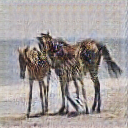

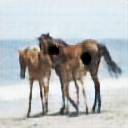

epoch: 106/5000, batch: 100/1067, GA2B_loss: 2.1984353065490723, GB2A_loss: 2.1956796646118164
                             DA_loss: 9.606646926840767e-07, DB_loss: 9.680414456147979e-12, CYC_loss: 0.2396881878376007
epoch: 106/5000, batch: 200/1067, GA2B_loss: 1.9506181478500366, GB2A_loss: 1.9567687511444092
                             DA_loss: 2.3419978845140577e-08, DB_loss: 5.2608957048505545e-06, CYC_loss: 0.19141902029514313
epoch: 106/5000, batch: 300/1067, GA2B_loss: 2.1754274368286133, GB2A_loss: 1.6244080066680908
                             DA_loss: 0.05447860807180405, DB_loss: 3.2454039455842576e-08, CYC_loss: 0.23512482643127441
epoch: 106/5000, batch: 400/1067, GA2B_loss: 2.109103202819824, GB2A_loss: 2.109011650085449
                             DA_loss: 1.2836186158438068e-07, DB_loss: 1.1531433447009576e-10, CYC_loss: 0.2218211144208908
epoch: 106/5000, batch: 500/1067, GA2B_loss: 1.9010753631591797, GB2A_loss: 1.8985049724578857
                             DA_lo

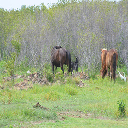

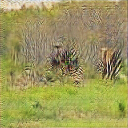

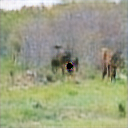

epoch: 107/5000, batch: 100/1067, GA2B_loss: 2.6282854080200195, GB2A_loss: 2.6444404125213623
                             DA_loss: 2.840683373506181e-05, DB_loss: 3.2899348298087716e-05, CYC_loss: 0.3288884162902832
epoch: 107/5000, batch: 200/1067, GA2B_loss: 2.1317598819732666, GB2A_loss: 2.1311187744140625
                             DA_loss: 1.4235455410016584e-06, DB_loss: 1.0423514273938395e-09, CYC_loss: 0.22635212540626526
epoch: 107/5000, batch: 300/1067, GA2B_loss: 1.869275689125061, GB2A_loss: 1.8694701194763184
                             DA_loss: 2.001260099859792e-06, DB_loss: 1.0865808519611164e-07, CYC_loss: 0.17389404773712158
epoch: 107/5000, batch: 400/1067, GA2B_loss: 2.3633713722229004, GB2A_loss: 2.3633697032928467
                             DA_loss: 4.1157152013727993e-13, DB_loss: 0.004742521792650223, CYC_loss: 0.2726742923259735
epoch: 107/5000, batch: 500/1067, GA2B_loss: 2.3988215923309326, GB2A_loss: 2.3914499282836914
                             DA_

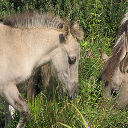

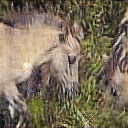

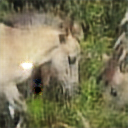

epoch: 108/5000, batch: 100/1067, GA2B_loss: 2.186756134033203, GB2A_loss: 2.1867613792419434
                             DA_loss: 1.1856990767000752e-07, DB_loss: 9.457084004793614e-10, CYC_loss: 0.2373524159193039
epoch: 108/5000, batch: 200/1067, GA2B_loss: 2.019350528717041, GB2A_loss: 2.018220901489258
                             DA_loss: 1.914253715540326e-07, DB_loss: 3.0431351660809014e-08, CYC_loss: 0.20387014746665955
epoch: 108/5000, batch: 300/1067, GA2B_loss: 2.2304744720458984, GB2A_loss: 2.2305374145507812
                             DA_loss: 2.1232879987564957e-07, DB_loss: 3.793448222211282e-09, CYC_loss: 0.24610751867294312
epoch: 108/5000, batch: 400/1067, GA2B_loss: 2.224618434906006, GB2A_loss: 2.2245771884918213
                             DA_loss: 2.1714388620530656e-10, DB_loss: 3.8705028223250115e-14, CYC_loss: 0.24492377042770386
epoch: 108/5000, batch: 500/1067, GA2B_loss: 2.25175142288208, GB2A_loss: 2.2514233589172363
                             DA_los

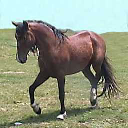

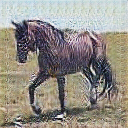

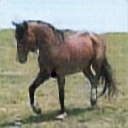

epoch: 109/5000, batch: 100/1067, GA2B_loss: 2.5746283531188965, GB2A_loss: 2.5735623836517334
                             DA_loss: 1.712660804287225e-07, DB_loss: 1.4147270022135672e-08, CYC_loss: 0.3149262070655823
epoch: 109/5000, batch: 200/1067, GA2B_loss: 2.7270736694335938, GB2A_loss: 2.7298316955566406
                             DA_loss: 1.0874233371399589e-12, DB_loss: 9.804838327909238e-07, CYC_loss: 0.3459668755531311
epoch: 109/5000, batch: 300/1067, GA2B_loss: 2.115434169769287, GB2A_loss: 2.109802484512329
                             DA_loss: 0.00024721151567064226, DB_loss: 9.830013229255208e-16, CYC_loss: 0.2230868637561798
epoch: 109/5000, batch: 400/1067, GA2B_loss: 1.9791312217712402, GB2A_loss: 1.9788627624511719
                             DA_loss: 1.3532701181873108e-08, DB_loss: 2.5502624456663625e-09, CYC_loss: 0.1958383172750473
epoch: 109/5000, batch: 500/1067, GA2B_loss: 1.9576616287231445, GB2A_loss: 1.9576630592346191
                             DA_lo

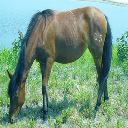

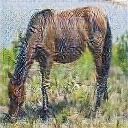

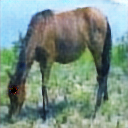

epoch: 110/5000, batch: 100/1067, GA2B_loss: 2.3039519786834717, GB2A_loss: 2.305638313293457
                             DA_loss: 8.263457829116305e-08, DB_loss: 4.419540289291035e-07, CYC_loss: 0.2611662745475769
epoch: 110/5000, batch: 200/1067, GA2B_loss: 1.6009966135025024, GB2A_loss: 2.412370443344116
                             DA_loss: 2.885880405756325e-07, DB_loss: 0.1600027233362198, CYC_loss: 0.2824743390083313
epoch: 110/5000, batch: 300/1067, GA2B_loss: 2.1546993255615234, GB2A_loss: 2.1546995639801025
                             DA_loss: 2.9328402888495475e-06, DB_loss: 3.3570032087482105e-08, CYC_loss: 0.23094092309474945
epoch: 110/5000, batch: 400/1067, GA2B_loss: 2.7621610164642334, GB2A_loss: 2.7621679306030273
                             DA_loss: 1.3569175782990328e-09, DB_loss: 4.067778647254272e-08, CYC_loss: 0.35243359208106995
epoch: 110/5000, batch: 500/1067, GA2B_loss: 2.154674768447876, GB2A_loss: 2.1545164585113525
                             DA_loss: 

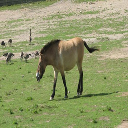

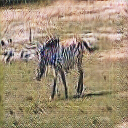

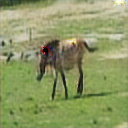

epoch: 111/5000, batch: 100/1067, GA2B_loss: 2.121624231338501, GB2A_loss: 2.121623992919922
                             DA_loss: 1.0231830493978578e-08, DB_loss: 7.943151558720274e-08, CYC_loss: 0.22432486712932587
epoch: 111/5000, batch: 200/1067, GA2B_loss: 1.9019267559051514, GB2A_loss: 1.9952442646026611
                             DA_loss: 5.161736282843776e-08, DB_loss: 0.001144551089964807, CYC_loss: 0.19906535744667053
epoch: 111/5000, batch: 300/1067, GA2B_loss: 2.614406108856201, GB2A_loss: 2.614412784576416
                             DA_loss: 8.922897087870751e-09, DB_loss: 8.441646492940436e-09, CYC_loss: 0.32288432121276855
epoch: 111/5000, batch: 400/1067, GA2B_loss: 2.235478401184082, GB2A_loss: 2.2368104457855225
                             DA_loss: 3.6597351815714774e-09, DB_loss: 2.779867429580918e-07, CYC_loss: 0.24739384651184082
epoch: 111/5000, batch: 500/1067, GA2B_loss: 2.6382689476013184, GB2A_loss: 2.6381468772888184
                             DA_loss:

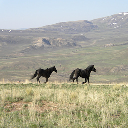

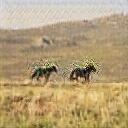

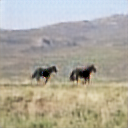

epoch: 112/5000, batch: 100/1067, GA2B_loss: 2.5065760612487793, GB2A_loss: 2.506535291671753
                             DA_loss: 6.393182047759183e-06, DB_loss: 2.395249526065263e-13, CYC_loss: 0.3013153672218323
epoch: 112/5000, batch: 200/1067, GA2B_loss: 2.1244311332702637, GB2A_loss: 2.12441349029541
                             DA_loss: 3.8668415691667235e-11, DB_loss: 5.765183252667838e-13, CYC_loss: 0.22488625347614288
epoch: 112/5000, batch: 300/1067, GA2B_loss: 2.3374669551849365, GB2A_loss: 2.3374404907226562
                             DA_loss: 9.649705340342152e-11, DB_loss: 0.003929616417735815, CYC_loss: 0.2674936354160309
epoch: 112/5000, batch: 400/1067, GA2B_loss: 1.9688432216644287, GB2A_loss: 1.9686726331710815
                             DA_loss: 1.7808060803758963e-08, DB_loss: 1.0236424338380679e-12, CYC_loss: 0.1937686651945114
epoch: 112/5000, batch: 500/1067, GA2B_loss: 2.6171188354492188, GB2A_loss: 2.6171205043792725
                             DA_loss:

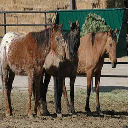

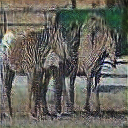

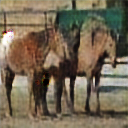

epoch: 113/5000, batch: 100/1067, GA2B_loss: 2.0632247924804688, GB2A_loss: 2.0321500301361084
                             DA_loss: 0.00012266701378393918, DB_loss: 0.002514154650270939, CYC_loss: 0.21264521777629852
epoch: 113/5000, batch: 200/1067, GA2B_loss: 2.568258762359619, GB2A_loss: 2.566274881362915
                             DA_loss: 5.004521881346591e-07, DB_loss: 3.044623719805628e-10, CYC_loss: 0.3136517405509949
epoch: 113/5000, batch: 300/1067, GA2B_loss: 1.838620662689209, GB2A_loss: 1.8377554416656494
                             DA_loss: 0.00017603840387891978, DB_loss: 3.8462833612529224e-11, CYC_loss: 0.1677263081073761
epoch: 113/5000, batch: 400/1067, GA2B_loss: 2.4280717372894287, GB2A_loss: 2.428065061569214
                             DA_loss: 1.3239515794793988e-07, DB_loss: 1.356743970643004e-11, CYC_loss: 0.2856164276599884
epoch: 113/5000, batch: 500/1067, GA2B_loss: 1.9387640953063965, GB2A_loss: 1.9378324747085571
                             DA_loss:

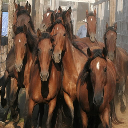

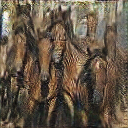

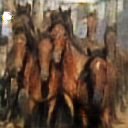

epoch: 114/5000, batch: 100/1067, GA2B_loss: 2.058621644973755, GB2A_loss: 2.058621406555176
                             DA_loss: 1.62118176660897e-08, DB_loss: 1.1377784294146903e-13, CYC_loss: 0.21172434091567993
epoch: 114/5000, batch: 200/1067, GA2B_loss: 1.8147926330566406, GB2A_loss: 1.814767599105835
                             DA_loss: 1.7219075232333125e-07, DB_loss: 1.0511731041162875e-08, CYC_loss: 0.16295981407165527
epoch: 114/5000, batch: 300/1067, GA2B_loss: 1.999700903892517, GB2A_loss: 1.9996992349624634
                             DA_loss: 8.257416993728839e-06, DB_loss: 5.756731354632227e-13, CYC_loss: 0.19994017481803894
epoch: 114/5000, batch: 400/1067, GA2B_loss: 2.2472071647644043, GB2A_loss: 2.2472524642944336
                             DA_loss: 2.986056124587577e-10, DB_loss: 4.004852560690608e-10, CYC_loss: 0.2494504749774933
epoch: 114/5000, batch: 500/1067, GA2B_loss: 2.1265623569488525, GB2A_loss: 2.126509189605713
                             DA_loss:

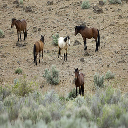

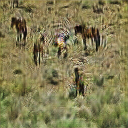

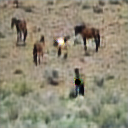

epoch: 115/5000, batch: 100/1067, GA2B_loss: 2.058567523956299, GB2A_loss: 2.0585713386535645
                             DA_loss: 7.785468936205575e-10, DB_loss: 2.5445643855870337e-12, CYC_loss: 0.21171438694000244
epoch: 115/5000, batch: 200/1067, GA2B_loss: 2.3515374660491943, GB2A_loss: 2.351541042327881
                             DA_loss: 8.701955778178672e-08, DB_loss: 1.5626756066922098e-07, CYC_loss: 0.2703092098236084
epoch: 115/5000, batch: 300/1067, GA2B_loss: 2.4417595863342285, GB2A_loss: 2.4410104751586914
                             DA_loss: 0.00181336619425565, DB_loss: 1.439678792847232e-10, CYC_loss: 0.2883555293083191
epoch: 115/5000, batch: 400/1067, GA2B_loss: 2.6883578300476074, GB2A_loss: 2.688471794128418
                             DA_loss: 4.946371632286173e-07, DB_loss: 0.0009431708022020757, CYC_loss: 0.3376944661140442
epoch: 115/5000, batch: 500/1067, GA2B_loss: 2.2612085342407227, GB2A_loss: 2.2328908443450928
                             DA_loss: 0

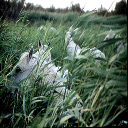

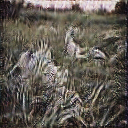

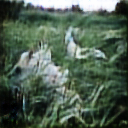

epoch: 116/5000, batch: 100/1067, GA2B_loss: 2.4318013191223145, GB2A_loss: 2.431809425354004
                             DA_loss: 3.73942810938388e-07, DB_loss: 3.27284588319543e-10, CYC_loss: 0.2863618731498718
epoch: 116/5000, batch: 200/1067, GA2B_loss: 2.3945555686950684, GB2A_loss: 2.3945794105529785
                             DA_loss: 1.8631511611300056e-10, DB_loss: 4.579382983926905e-10, CYC_loss: 0.2789231538772583
epoch: 116/5000, batch: 300/1067, GA2B_loss: 2.063870429992676, GB2A_loss: 2.0638694763183594
                             DA_loss: 1.3846814862251977e-13, DB_loss: 2.981181246959272e-14, CYC_loss: 0.2127740979194641
epoch: 116/5000, batch: 400/1067, GA2B_loss: 2.1282758712768555, GB2A_loss: 2.1282663345336914
                             DA_loss: 1.1434357800876871e-11, DB_loss: 5.6282090099557536e-11, CYC_loss: 0.22565516829490662
epoch: 116/5000, batch: 500/1067, GA2B_loss: 2.548224687576294, GB2A_loss: 2.5482177734375
                             DA_loss: 1.

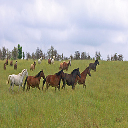

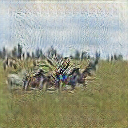

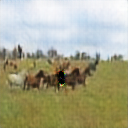

epoch: 117/5000, batch: 100/1067, GA2B_loss: 2.2757391929626465, GB2A_loss: 2.2166004180908203
                             DA_loss: 0.0004506293043959886, DB_loss: 0.00010969580034725368, CYC_loss: 0.25514787435531616
epoch: 117/5000, batch: 200/1067, GA2B_loss: 2.5168638229370117, GB2A_loss: 2.517029285430908
                             DA_loss: 3.3243168218177743e-09, DB_loss: 6.039206709829159e-06, CYC_loss: 0.30340588092803955
epoch: 117/5000, batch: 300/1067, GA2B_loss: 2.137345314025879, GB2A_loss: 2.1383309364318848
                             DA_loss: 2.4319060654143243e-10, DB_loss: 1.2157777007359982e-07, CYC_loss: 0.2276662290096283
epoch: 117/5000, batch: 400/1067, GA2B_loss: 2.016505718231201, GB2A_loss: 2.012606382369995
                             DA_loss: 1.9042223584619933e-06, DB_loss: 1.705427280285221e-06, CYC_loss: 0.20330111682415009
epoch: 117/5000, batch: 500/1067, GA2B_loss: 2.140941619873047, GB2A_loss: 2.1409385204315186
                             DA_lo

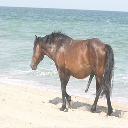

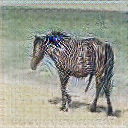

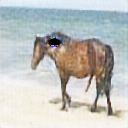

epoch: 118/5000, batch: 100/1067, GA2B_loss: 1.9569056034088135, GB2A_loss: 1.9558193683624268
                             DA_loss: 4.4801504373026546e-07, DB_loss: 7.888929332011685e-08, CYC_loss: 0.19153738021850586
epoch: 118/5000, batch: 200/1067, GA2B_loss: 2.3122811317443848, GB2A_loss: 2.31227970123291
                             DA_loss: 5.481516200234182e-05, DB_loss: 1.1370128796817092e-11, CYC_loss: 0.2624562382698059
epoch: 118/5000, batch: 300/1067, GA2B_loss: 2.106631278991699, GB2A_loss: 2.10663104057312
                             DA_loss: 1.6383998158175928e-08, DB_loss: 5.755397547435592e-11, CYC_loss: 0.22132623195648193
epoch: 118/5000, batch: 400/1067, GA2B_loss: 2.440371036529541, GB2A_loss: 1.440393090248108
                             DA_loss: 0.49563440680503845, DB_loss: 8.834653009159865e-09, CYC_loss: 0.288074791431427
epoch: 118/5000, batch: 500/1067, GA2B_loss: 1.8512400388717651, GB2A_loss: 1.851195216178894
                             DA_loss: 2.609

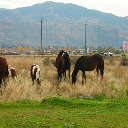

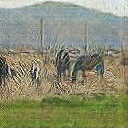

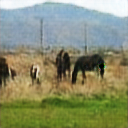

epoch: 119/5000, batch: 100/1067, GA2B_loss: 2.2652792930603027, GB2A_loss: 2.265244960784912
                             DA_loss: 5.006981496080698e-10, DB_loss: 3.946337017168844e-07, CYC_loss: 0.2530558407306671
epoch: 119/5000, batch: 200/1067, GA2B_loss: 2.237506866455078, GB2A_loss: 2.237454891204834
                             DA_loss: 5.759720478337726e-10, DB_loss: 3.1593234972593365e-11, CYC_loss: 0.24750453233718872
epoch: 119/5000, batch: 300/1067, GA2B_loss: 2.3002777099609375, GB2A_loss: 2.3002777099609375
                             DA_loss: 1.2640714430744993e-06, DB_loss: 0.07113956660032272, CYC_loss: 0.2600555419921875
epoch: 119/5000, batch: 400/1067, GA2B_loss: 2.7339701652526855, GB2A_loss: 2.7339675426483154
                             DA_loss: 5.145262207406631e-07, DB_loss: 1.5038987416504668e-11, CYC_loss: 0.34679538011550903
epoch: 119/5000, batch: 500/1067, GA2B_loss: 2.8360252380371094, GB2A_loss: 2.87801456451416
                             DA_loss: 1

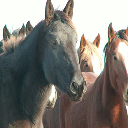

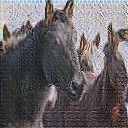

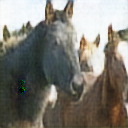

epoch: 120/5000, batch: 100/1067, GA2B_loss: 2.90512752532959, GB2A_loss: 2.90512752532959
                             DA_loss: 0.00034608994610607624, DB_loss: 7.2775986625917e-12, CYC_loss: 0.3810255229473114
epoch: 120/5000, batch: 200/1067, GA2B_loss: 2.042499542236328, GB2A_loss: 2.0427002906799316
                             DA_loss: 1.3199112913753197e-09, DB_loss: 5.042537498667343e-09, CYC_loss: 0.20854005217552185
epoch: 120/5000, batch: 300/1067, GA2B_loss: 2.2706570625305176, GB2A_loss: 2.2692458629608154
                             DA_loss: 2.4980104740279785e-07, DB_loss: 0.0016053970903158188, CYC_loss: 0.2541314363479614
epoch: 120/5000, batch: 400/1067, GA2B_loss: 2.261051893234253, GB2A_loss: 2.260782241821289
                             DA_loss: 1.2188385412059688e-08, DB_loss: 2.2339663452441982e-09, CYC_loss: 0.2522188127040863
epoch: 120/5000, batch: 500/1067, GA2B_loss: 2.101562023162842, GB2A_loss: 2.2264606952667236
                             DA_loss: 8.5

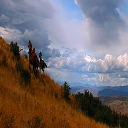

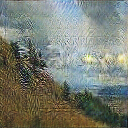

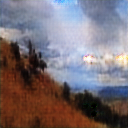

epoch: 121/5000, batch: 100/1067, GA2B_loss: 2.036299467086792, GB2A_loss: 2.036346912384033
                             DA_loss: 5.934693641738132e-19, DB_loss: 1.5047839641013638e-09, CYC_loss: 0.20726937055587769
epoch: 121/5000, batch: 200/1067, GA2B_loss: 1.893014907836914, GB2A_loss: 1.8924553394317627
                             DA_loss: 4.278001597413095e-08, DB_loss: 4.311512036281329e-09, CYC_loss: 0.17860756814479828
epoch: 121/5000, batch: 300/1067, GA2B_loss: 2.3923869132995605, GB2A_loss: 2.3923873901367188
                             DA_loss: 2.4936935005825944e-07, DB_loss: 4.705092565560065e-11, CYC_loss: 0.27847954630851746
epoch: 121/5000, batch: 400/1067, GA2B_loss: 2.329756736755371, GB2A_loss: 2.32975697517395
                             DA_loss: 4.818072696366471e-08, DB_loss: 1.9198996505011973e-13, CYC_loss: 0.26595160365104675
epoch: 121/5000, batch: 500/1067, GA2B_loss: 2.2231647968292236, GB2A_loss: 2.222243309020996
                             DA_loss:

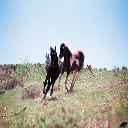

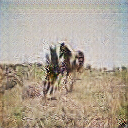

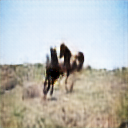

epoch: 122/5000, batch: 100/1067, GA2B_loss: 2.039534091949463, GB2A_loss: 2.039491653442383
                             DA_loss: 1.7230715343430347e-07, DB_loss: 1.4852314222935092e-07, CYC_loss: 0.20812468230724335
epoch: 122/5000, batch: 200/1067, GA2B_loss: 1.6392070055007935, GB2A_loss: 1.6388368606567383
                             DA_loss: 1.7165962873377794e-08, DB_loss: 1.1375525087869987e-13, CYC_loss: 0.12784139811992645
epoch: 122/5000, batch: 300/1067, GA2B_loss: 2.5468993186950684, GB2A_loss: 2.546808958053589
                             DA_loss: 3.2488560464116745e-07, DB_loss: 2.4073146960290615e-06, CYC_loss: 0.30938053131103516
epoch: 122/5000, batch: 400/1067, GA2B_loss: 1.7848711013793945, GB2A_loss: 1.7894296646118164
                             DA_loss: 1.695778983901164e-08, DB_loss: 2.6269965474057244e-06, CYC_loss: 0.15789002180099487
epoch: 122/5000, batch: 500/1067, GA2B_loss: 2.059277057647705, GB2A_loss: 2.0554697513580322
                             D

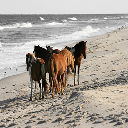

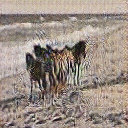

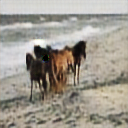

epoch: 123/5000, batch: 100/1067, GA2B_loss: 2.2822728157043457, GB2A_loss: 2.216278314590454
                             DA_loss: 0.0005631630774587393, DB_loss: 2.2294562995739398e-07, CYC_loss: 0.2564546465873718
epoch: 123/5000, batch: 200/1067, GA2B_loss: 2.220217227935791, GB2A_loss: 2.2196903228759766
                             DA_loss: 4.281908161374304e-08, DB_loss: 3.284100387190847e-07, CYC_loss: 0.2440434694290161
epoch: 123/5000, batch: 300/1067, GA2B_loss: 2.159433126449585, GB2A_loss: 2.156588077545166
                             DA_loss: 1.0133444448001683e-06, DB_loss: 4.193054780744017e-20, CYC_loss: 0.231886625289917
epoch: 123/5000, batch: 400/1067, GA2B_loss: 2.4396636486053467, GB2A_loss: 2.4396629333496094
                             DA_loss: 2.485635586246815e-10, DB_loss: 4.8950839909300825e-11, CYC_loss: 0.28793275356292725
epoch: 123/5000, batch: 500/1067, GA2B_loss: 1.9548654556274414, GB2A_loss: 1.962530255317688
                             DA_loss: 1

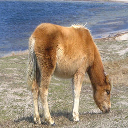

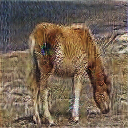

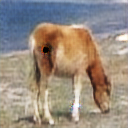

epoch: 124/5000, batch: 100/1067, GA2B_loss: 1.8367513418197632, GB2A_loss: 1.8367552757263184
                             DA_loss: 1.80005542915751e-06, DB_loss: 7.856860939625676e-09, CYC_loss: 0.1673518866300583
epoch: 124/5000, batch: 200/1067, GA2B_loss: 2.3075075149536133, GB2A_loss: 2.3075056076049805
                             DA_loss: 1.674776463345129e-11, DB_loss: 1.2416256391090119e-11, CYC_loss: 0.2615034580230713
epoch: 124/5000, batch: 300/1067, GA2B_loss: 2.1986560821533203, GB2A_loss: 1.3859597444534302
                             DA_loss: 0.1608850210905075, DB_loss: 9.89415993579712e-10, CYC_loss: 0.23973171412944794
epoch: 124/5000, batch: 400/1067, GA2B_loss: 1.9522230625152588, GB2A_loss: 1.952218770980835
                             DA_loss: 2.38314489670044e-12, DB_loss: 2.269836159030092e-07, CYC_loss: 0.19044463336467743
epoch: 124/5000, batch: 500/1067, GA2B_loss: 2.2961864471435547, GB2A_loss: 2.297691822052002
                             DA_loss: 8.18

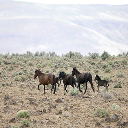

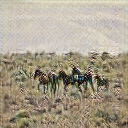

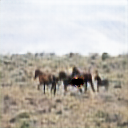

epoch: 125/5000, batch: 100/1067, GA2B_loss: 2.429945945739746, GB2A_loss: 2.4305787086486816
                             DA_loss: 5.1581579008086464e-09, DB_loss: 1.1494441309878312e-07, CYC_loss: 0.2861160337924957
epoch: 125/5000, batch: 200/1067, GA2B_loss: 2.031193971633911, GB2A_loss: 2.031249761581421
                             DA_loss: 5.111035861204982e-08, DB_loss: 4.248136065143626e-08, CYC_loss: 0.2062501758337021
epoch: 125/5000, batch: 300/1067, GA2B_loss: 1.9579946994781494, GB2A_loss: 1.9579824209213257
                             DA_loss: 6.294367249637389e-10, DB_loss: 3.728096373833978e-07, CYC_loss: 0.19159898161888123
epoch: 125/5000, batch: 400/1067, GA2B_loss: 2.0294134616851807, GB2A_loss: 2.0590310096740723
                             DA_loss: 1.0330285959980756e-08, DB_loss: 0.00011628275387920439, CYC_loss: 0.2118459939956665
epoch: 125/5000, batch: 500/1067, GA2B_loss: 2.089210033416748, GB2A_loss: 2.089099884033203
                             DA_loss:

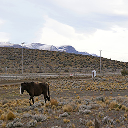

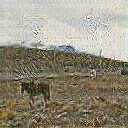

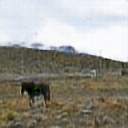

epoch: 126/5000, batch: 100/1067, GA2B_loss: 2.257798194885254, GB2A_loss: 2.2578177452087402
                             DA_loss: 2.0720413232422352e-11, DB_loss: 4.888872640052e-11, CYC_loss: 0.2515636086463928
epoch: 126/5000, batch: 200/1067, GA2B_loss: 1.8728852272033691, GB2A_loss: 1.8736522197723389
                             DA_loss: 9.299047087552026e-05, DB_loss: 7.376176114348709e-08, CYC_loss: 0.17473067343235016
epoch: 126/5000, batch: 300/1067, GA2B_loss: 2.309342384338379, GB2A_loss: 2.3091254234313965
                             DA_loss: 5.876325648301872e-09, DB_loss: 2.6033440008177422e-05, CYC_loss: 0.2618684768676758
epoch: 126/5000, batch: 400/1067, GA2B_loss: 2.063310146331787, GB2A_loss: 2.063368320465088
                             DA_loss: 0.04248373582959175, DB_loss: 6.015093978462005e-10, CYC_loss: 0.21267399191856384
epoch: 126/5000, batch: 500/1067, GA2B_loss: 2.2157795429229736, GB2A_loss: 2.2157809734344482
                             DA_loss: 4.57

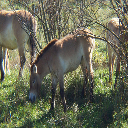

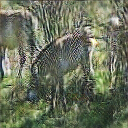

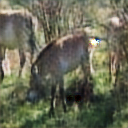

epoch: 127/5000, batch: 100/1067, GA2B_loss: 1.7378959655761719, GB2A_loss: 1.7380454540252686
                             DA_loss: 8.707303107702291e-12, DB_loss: 2.857207581641319e-09, CYC_loss: 0.14760909974575043
epoch: 127/5000, batch: 200/1067, GA2B_loss: 1.812997817993164, GB2A_loss: 1.8129936456680298
                             DA_loss: 3.731535046236356e-12, DB_loss: 1.7338364736623542e-16, CYC_loss: 0.1625995635986328
epoch: 127/5000, batch: 300/1067, GA2B_loss: 1.9570684432983398, GB2A_loss: 1.9586150646209717
                             DA_loss: 2.7197575788728834e-12, DB_loss: 3.0214394541872025e-07, CYC_loss: 0.19172392785549164
epoch: 127/5000, batch: 400/1067, GA2B_loss: 2.473557472229004, GB2A_loss: 2.4735255241394043
                             DA_loss: 2.9164009873738905e-08, DB_loss: 0.0004284151073079556, CYC_loss: 0.29471150040626526
epoch: 127/5000, batch: 500/1067, GA2B_loss: 1.8734822273254395, GB2A_loss: 1.8735325336456299
                             DA_

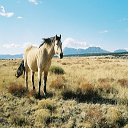

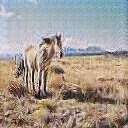

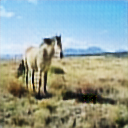

epoch: 128/5000, batch: 100/1067, GA2B_loss: 2.789053440093994, GB2A_loss: 2.7882015705108643
                             DA_loss: 1.1569277802436773e-07, DB_loss: 1.2726958402708988e-06, CYC_loss: 0.357832670211792
epoch: 128/5000, batch: 200/1067, GA2B_loss: 1.9886153936386108, GB2A_loss: 1.9886164665222168
                             DA_loss: 0.05891049653291702, DB_loss: 2.593504177639261e-05, CYC_loss: 0.19772329926490784
epoch: 128/5000, batch: 300/1067, GA2B_loss: 2.371201276779175, GB2A_loss: 2.3710525035858154
                             DA_loss: 2.6848979928217886e-08, DB_loss: 4.590819571603788e-06, CYC_loss: 0.27424103021621704
epoch: 128/5000, batch: 400/1067, GA2B_loss: 2.5784895420074463, GB2A_loss: 2.5784852504730225
                             DA_loss: 4.826710697791725e-10, DB_loss: 5.144206761157957e-19, CYC_loss: 0.31569790840148926
epoch: 128/5000, batch: 500/1067, GA2B_loss: 2.2544946670532227, GB2A_loss: 2.2538528442382812
                             DA_loss

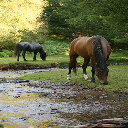

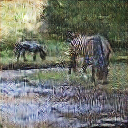

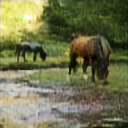

epoch: 129/5000, batch: 100/1067, GA2B_loss: 2.047496795654297, GB2A_loss: 2.0132358074188232
                             DA_loss: 0.00015064931358210742, DB_loss: 3.441982698859647e-09, CYC_loss: 0.20949935913085938
epoch: 129/5000, batch: 200/1067, GA2B_loss: 1.735611915588379, GB2A_loss: 1.7202215194702148
                             DA_loss: 2.9839664421160705e-05, DB_loss: 0.24948947131633759, CYC_loss: 0.14712244272232056
epoch: 129/5000, batch: 300/1067, GA2B_loss: 2.0623297691345215, GB2A_loss: 2.056687355041504
                             DA_loss: 3.991174253314966e-06, DB_loss: 1.4246779755922034e-08, CYC_loss: 0.21246597170829773
epoch: 129/5000, batch: 400/1067, GA2B_loss: 2.268521785736084, GB2A_loss: 2.2704591751098633
                             DA_loss: 6.268486840710352e-10, DB_loss: 4.6991698354759137e-07, CYC_loss: 0.2540919780731201
epoch: 129/5000, batch: 500/1067, GA2B_loss: 1.872403621673584, GB2A_loss: 1.872403621673584
                             DA_loss: 

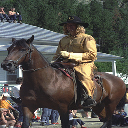

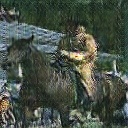

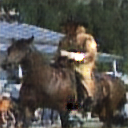

epoch: 130/5000, batch: 100/1067, GA2B_loss: 2.230389356613159, GB2A_loss: 2.2271175384521484
                             DA_loss: 1.3405750678430195e-06, DB_loss: 5.969664016447496e-07, CYC_loss: 0.24607792496681213
epoch: 130/5000, batch: 200/1067, GA2B_loss: 2.714566469192505, GB2A_loss: 2.714806079864502
                             DA_loss: 2.1076694167732057e-08, DB_loss: 3.6367141547088977e-06, CYC_loss: 0.34300506114959717
epoch: 130/5000, batch: 300/1067, GA2B_loss: 1.8591563701629639, GB2A_loss: 1.8587462902069092
                             DA_loss: 3.836288797742782e-08, DB_loss: 2.2864870885541677e-08, CYC_loss: 0.17186002433300018
epoch: 130/5000, batch: 400/1067, GA2B_loss: 2.2793056964874268, GB2A_loss: 2.2795026302337646
                             DA_loss: 0.0003578904434107244, DB_loss: 4.928992325403669e-09, CYC_loss: 0.25590085983276367
epoch: 130/5000, batch: 500/1067, GA2B_loss: 2.017693519592285, GB2A_loss: 2.017759323120117
                             DA_lo

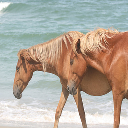

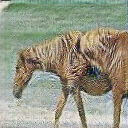

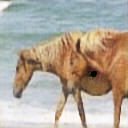

epoch: 131/5000, batch: 100/1067, GA2B_loss: 2.072035074234009, GB2A_loss: 2.0722179412841797
                             DA_loss: 5.614494532810675e-14, DB_loss: 4.209133042110125e-09, CYC_loss: 0.21444371342658997
epoch: 131/5000, batch: 200/1067, GA2B_loss: 2.065426826477051, GB2A_loss: 2.0645132064819336
                             DA_loss: 1.0468917110983966e-07, DB_loss: 1.1273886260320445e-19, CYC_loss: 0.2130853831768036
epoch: 131/5000, batch: 300/1067, GA2B_loss: 2.5001635551452637, GB2A_loss: 2.500161647796631
                             DA_loss: 6.924614419194508e-13, DB_loss: 7.461271319753396e-14, CYC_loss: 0.3000328242778778
epoch: 131/5000, batch: 400/1067, GA2B_loss: 1.8722736835479736, GB2A_loss: 1.8692567348480225
                             DA_loss: 1.1401108395148185e-06, DB_loss: 6.87686995022585e-13, CYC_loss: 0.17445491254329681
epoch: 131/5000, batch: 500/1067, GA2B_loss: 2.0597801208496094, GB2A_loss: 2.059781074523926
                             DA_loss:

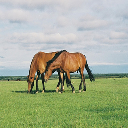

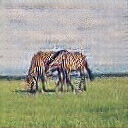

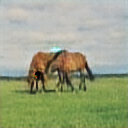

epoch: 132/5000, batch: 100/1067, GA2B_loss: 2.3834667205810547, GB2A_loss: 2.38346791267395
                             DA_loss: 6.376778401318006e-06, DB_loss: 2.2714261840774824e-13, CYC_loss: 0.27669358253479004
epoch: 132/5000, batch: 200/1067, GA2B_loss: 2.0419602394104004, GB2A_loss: 2.04189395904541
                             DA_loss: 5.451519236032709e-10, DB_loss: 5.650520051858621e-08, CYC_loss: 0.20839202404022217
epoch: 132/5000, batch: 300/1067, GA2B_loss: 1.691504955291748, GB2A_loss: 1.6915042400360107
                             DA_loss: 6.566587398992851e-05, DB_loss: 6.122026206867304e-06, CYC_loss: 0.1383010745048523
epoch: 132/5000, batch: 400/1067, GA2B_loss: 1.67230224609375, GB2A_loss: 1.5332224369049072
                             DA_loss: 0.002602245192974806, DB_loss: 5.3203373570516533e-17, CYC_loss: 0.13446044921875
epoch: 132/5000, batch: 500/1067, GA2B_loss: 2.7850661277770996, GB2A_loss: 2.7850637435913086
                             DA_loss: 7.414

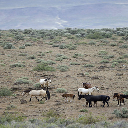

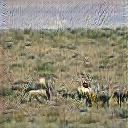

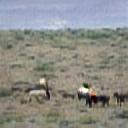

epoch: 133/5000, batch: 100/1067, GA2B_loss: 2.0011558532714844, GB2A_loss: 2.001481533050537
                             DA_loss: 0.0007067538099363446, DB_loss: 1.4346056786962436e-08, CYC_loss: 0.20029863715171814
epoch: 133/5000, batch: 200/1067, GA2B_loss: 2.3421220779418945, GB2A_loss: 2.341810703277588
                             DA_loss: 1.2117300940417408e-08, DB_loss: 1.9901442759878712e-17, CYC_loss: 0.268424391746521
epoch: 133/5000, batch: 300/1067, GA2B_loss: 2.2679481506347656, GB2A_loss: 2.2679429054260254
                             DA_loss: 3.2866589224495035e-12, DB_loss: 2.4846968926794943e-10, CYC_loss: 0.2535896301269531
epoch: 133/5000, batch: 400/1067, GA2B_loss: 1.786977767944336, GB2A_loss: 1.7867976427078247
                             DA_loss: 4.312855406141125e-09, DB_loss: 3.2667349728066064e-12, CYC_loss: 0.1573965847492218
epoch: 133/5000, batch: 500/1067, GA2B_loss: 2.2347841262817383, GB2A_loss: 2.194068670272827
                             DA_los

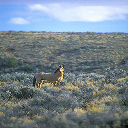

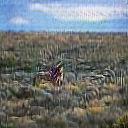

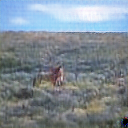

epoch: 134/5000, batch: 100/1067, GA2B_loss: 2.047135353088379, GB2A_loss: 2.010127544403076
                             DA_loss: 0.00017445064440835267, DB_loss: 2.11696748997868e-13, CYC_loss: 0.20942729711532593
epoch: 134/5000, batch: 200/1067, GA2B_loss: 2.068260669708252, GB2A_loss: 2.06742000579834
                             DA_loss: 1.188471969726379e-07, DB_loss: 2.865335226032162e-11, CYC_loss: 0.213655024766922
epoch: 134/5000, batch: 300/1067, GA2B_loss: 2.279301643371582, GB2A_loss: 2.279301643371582
                             DA_loss: 3.6834535421803594e-09, DB_loss: 1.1428786519593337e-13, CYC_loss: 0.2558603286743164
epoch: 134/5000, batch: 400/1067, GA2B_loss: 2.2826685905456543, GB2A_loss: 2.2826695442199707
                             DA_loss: 1.1674253983073868e-05, DB_loss: 4.5135278847752147e-10, CYC_loss: 0.2565339207649231
epoch: 134/5000, batch: 500/1067, GA2B_loss: 2.743039608001709, GB2A_loss: 2.7430379390716553
                             DA_loss: 5.9

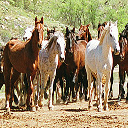

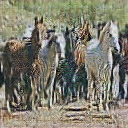

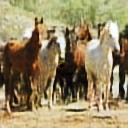

epoch: 135/5000, batch: 100/1067, GA2B_loss: 1.9871755838394165, GB2A_loss: 1.9871755838394165
                             DA_loss: 3.632980224210769e-05, DB_loss: 3.0577211873605847e-09, CYC_loss: 0.19743511080741882
epoch: 135/5000, batch: 200/1067, GA2B_loss: 2.0907199382781982, GB2A_loss: 2.090700149536133
                             DA_loss: 2.0655036223615753e-06, DB_loss: 5.322652041339637e-13, CYC_loss: 0.21814438700675964
epoch: 135/5000, batch: 300/1067, GA2B_loss: 1.8841179609298706, GB2A_loss: 1.8841313123703003
                             DA_loss: 2.6425881927139017e-08, DB_loss: 2.2299499052857996e-11, CYC_loss: 0.17682626843452454
epoch: 135/5000, batch: 400/1067, GA2B_loss: 1.8469470739364624, GB2A_loss: 1.8469464778900146
                             DA_loss: 6.978234434740216e-09, DB_loss: 1.6292115226357318e-12, CYC_loss: 0.1693895161151886
epoch: 135/5000, batch: 500/1067, GA2B_loss: 1.828768253326416, GB2A_loss: 1.8500897884368896
                             DA

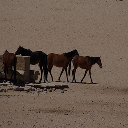

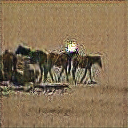

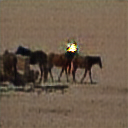

epoch: 136/5000, batch: 100/1067, GA2B_loss: 2.3664331436157227, GB2A_loss: 2.3664894104003906
                             DA_loss: 1.2606643728929612e-08, DB_loss: 4.038869516609367e-10, CYC_loss: 0.2732979953289032
epoch: 136/5000, batch: 200/1067, GA2B_loss: 1.953364610671997, GB2A_loss: 1.9533668756484985
                             DA_loss: 3.5224199858990834e-12, DB_loss: 2.2362673917086795e-05, CYC_loss: 0.19067399203777313
epoch: 136/5000, batch: 300/1067, GA2B_loss: 2.224496841430664, GB2A_loss: 2.2241783142089844
                             DA_loss: 2.5091429378676366e-08, DB_loss: 3.9366435089505103e-07, CYC_loss: 0.24492526054382324
epoch: 136/5000, batch: 400/1067, GA2B_loss: 2.0366740226745605, GB2A_loss: 2.036588191986084
                             DA_loss: 9.271285961176545e-10, DB_loss: 3.6468534858613566e-08, CYC_loss: 0.20733483135700226
epoch: 136/5000, batch: 500/1067, GA2B_loss: 2.606266498565674, GB2A_loss: 2.6056861877441406
                             DA_

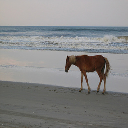

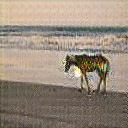

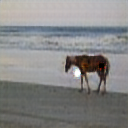

epoch: 137/5000, batch: 100/1067, GA2B_loss: 2.1038994789123535, GB2A_loss: 2.1069488525390625
                             DA_loss: 1.472819532999381e-09, DB_loss: 1.2331338439253159e-06, CYC_loss: 0.22140759229660034
epoch: 137/5000, batch: 200/1067, GA2B_loss: 1.8030190467834473, GB2A_loss: 1.802847146987915
                             DA_loss: 5.196261199102992e-09, DB_loss: 9.79669904227487e-12, CYC_loss: 0.16060394048690796
epoch: 137/5000, batch: 300/1067, GA2B_loss: 2.4443323612213135, GB2A_loss: 2.4444804191589355
                             DA_loss: 0.00134388473816216, DB_loss: 2.743964389040343e-09, CYC_loss: 0.2888961136341095
epoch: 137/5000, batch: 400/1067, GA2B_loss: 1.644620418548584, GB2A_loss: 1.6410417556762695
                             DA_loss: 2.3266484276973642e-06, DB_loss: 6.679172059875782e-08, CYC_loss: 0.12907026708126068
epoch: 137/5000, batch: 500/1067, GA2B_loss: 2.0625462532043457, GB2A_loss: 2.0625462532043457
                             DA_loss:

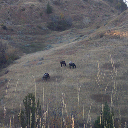

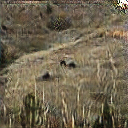

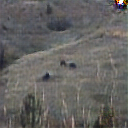

epoch: 138/5000, batch: 100/1067, GA2B_loss: 1.7565115690231323, GB2A_loss: 1.7245174646377563
                             DA_loss: 0.00013004835636820644, DB_loss: 1.4898058786627644e-08, CYC_loss: 0.1513024866580963
epoch: 138/5000, batch: 200/1067, GA2B_loss: 1.9512207508087158, GB2A_loss: 1.948762059211731
                             DA_loss: 7.575404197268654e-07, DB_loss: 2.447715153394009e-13, CYC_loss: 0.19024445116519928
epoch: 138/5000, batch: 300/1067, GA2B_loss: 2.0794970989227295, GB2A_loss: 2.073115348815918
                             DA_loss: 5.109144240122987e-06, DB_loss: 2.4945795429331952e-11, CYC_loss: 0.21589967608451843
epoch: 138/5000, batch: 400/1067, GA2B_loss: 2.1968605518341064, GB2A_loss: 2.1970739364624023
                             DA_loss: 7.533986945418292e-07, DB_loss: 8.882874453775003e-07, CYC_loss: 0.23990489542484283
epoch: 138/5000, batch: 500/1067, GA2B_loss: 2.0345592498779297, GB2A_loss: 2.03760027885437
                             DA_los

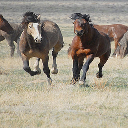

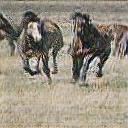

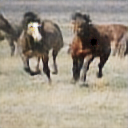

epoch: 139/5000, batch: 100/1067, GA2B_loss: 2.0042285919189453, GB2A_loss: 2.0041708946228027
                             DA_loss: 6.626499793327412e-09, DB_loss: 1.8878409946410102e-10, CYC_loss: 0.20084568858146667
epoch: 139/5000, batch: 200/1067, GA2B_loss: 2.0227715969085693, GB2A_loss: 2.022780418395996
                             DA_loss: 0.007561373058706522, DB_loss: 3.2924591941707604e-09, CYC_loss: 0.2045629918575287
epoch: 139/5000, batch: 300/1067, GA2B_loss: 2.0642900466918945, GB2A_loss: 2.0642900466918945
                             DA_loss: 0.00018063241441268474, DB_loss: 1.6907281974454236e-07, CYC_loss: 0.21285805106163025
epoch: 139/5000, batch: 400/1067, GA2B_loss: 2.4916012287139893, GB2A_loss: 2.4915876388549805
                             DA_loss: 1.808870564445897e-08, DB_loss: 1.0506482794880867e-08, CYC_loss: 0.2983202338218689
epoch: 139/5000, batch: 500/1067, GA2B_loss: 1.9550909996032715, GB2A_loss: 0.9651756286621094
                             DA_

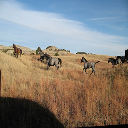

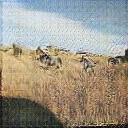

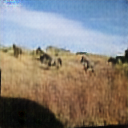

epoch: 140/5000, batch: 100/1067, GA2B_loss: 2.1846790313720703, GB2A_loss: 2.184718132019043
                             DA_loss: 1.0231815394945443e-06, DB_loss: 1.9667895090336174e-10, CYC_loss: 0.23694372177124023
epoch: 140/5000, batch: 200/1067, GA2B_loss: 1.8066688776016235, GB2A_loss: 1.8065699338912964
                             DA_loss: 1.5303980305247933e-09, DB_loss: 4.803268893738277e-12, CYC_loss: 0.16133376955986023
epoch: 140/5000, batch: 300/1067, GA2B_loss: 1.800206184387207, GB2A_loss: 1.0237915515899658
                             DA_loss: 0.13894452154636383, DB_loss: 1.2682448868872598e-08, CYC_loss: 0.1600412279367447
epoch: 140/5000, batch: 400/1067, GA2B_loss: 1.7730228900909424, GB2A_loss: 1.7729084491729736
                             DA_loss: 1.6362055044183421e-09, DB_loss: 6.075638339098077e-07, CYC_loss: 0.15460458397865295
epoch: 140/5000, batch: 500/1067, GA2B_loss: 1.9807037115097046, GB2A_loss: 1.9806816577911377
                             DA_l

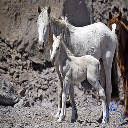

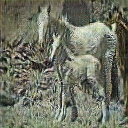

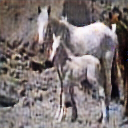

epoch: 141/5000, batch: 100/1067, GA2B_loss: 1.9725998640060425, GB2A_loss: 1.9725710153579712
                             DA_loss: 2.1595873533897247e-07, DB_loss: 1.2283210892860552e-08, CYC_loss: 0.1945221722126007
epoch: 141/5000, batch: 200/1067, GA2B_loss: 2.176102638244629, GB2A_loss: 2.0981130599975586
                             DA_loss: 0.0007914770976640284, DB_loss: 1.8481665850500484e-11, CYC_loss: 0.23522058129310608
epoch: 141/5000, batch: 300/1067, GA2B_loss: 1.7560607194900513, GB2A_loss: 1.7560604810714722
                             DA_loss: 0.00011685957724694163, DB_loss: 1.4452513630303088e-09, CYC_loss: 0.15121214091777802
epoch: 141/5000, batch: 400/1067, GA2B_loss: 2.7796154022216797, GB2A_loss: 2.779611349105835
                             DA_loss: 5.317544668481666e-11, DB_loss: 3.423478514563705e-11, CYC_loss: 0.35592639446258545
epoch: 141/5000, batch: 500/1067, GA2B_loss: 2.0698351860046387, GB2A_loss: 2.0698342323303223
                             DA

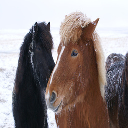

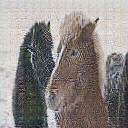

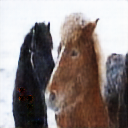

epoch: 142/5000, batch: 100/1067, GA2B_loss: 2.23439359664917, GB2A_loss: 2.2343931198120117
                             DA_loss: 4.962665478211448e-13, DB_loss: 5.5706554820400545e-12, CYC_loss: 0.2468787431716919
epoch: 142/5000, batch: 200/1067, GA2B_loss: 1.8904969692230225, GB2A_loss: 1.8906443119049072
                             DA_loss: 3.9389274775203376e-07, DB_loss: 3.9633564483665396e-06, CYC_loss: 0.17812895774841309
epoch: 142/5000, batch: 300/1067, GA2B_loss: 2.0880343914031982, GB2A_loss: 2.098565101623535
                             DA_loss: 2.1482102854150783e-16, DB_loss: 1.3935266906628385e-05, CYC_loss: 0.2197129875421524
epoch: 142/5000, batch: 400/1067, GA2B_loss: 2.258791446685791, GB2A_loss: 2.258791446685791
                             DA_loss: 9.6748209443831e-10, DB_loss: 6.293879141753691e-18, CYC_loss: 0.25175827741622925
epoch: 142/5000, batch: 500/1067, GA2B_loss: 1.9646296501159668, GB2A_loss: 1.964564323425293
                             DA_loss: 

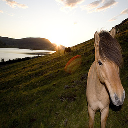

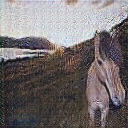

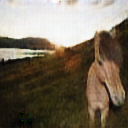

epoch: 143/5000, batch: 100/1067, GA2B_loss: 2.028412342071533, GB2A_loss: 2.0149054527282715
                             DA_loss: 2.2960213755141012e-05, DB_loss: 5.9756644077424426e-12, CYC_loss: 0.20568245649337769
epoch: 143/5000, batch: 200/1067, GA2B_loss: 1.8942973613739014, GB2A_loss: 1.894234538078308
                             DA_loss: 0.0005803042440675199, DB_loss: 1.7763568394002505e-13, CYC_loss: 0.17885947227478027
epoch: 143/5000, batch: 300/1067, GA2B_loss: 2.0049917697906494, GB2A_loss: 2.0049915313720703
                             DA_loss: 2.087329420419337e-09, DB_loss: 7.105428204633949e-15, CYC_loss: 0.20099836587905884
epoch: 143/5000, batch: 400/1067, GA2B_loss: 2.1909193992614746, GB2A_loss: 2.1909193992614746
                             DA_loss: 7.538154128683416e-11, DB_loss: 8.290977022225483e-15, CYC_loss: 0.2381838858127594
epoch: 143/5000, batch: 500/1067, GA2B_loss: 2.0195186138153076, GB2A_loss: 2.0194897651672363
                             DA_l

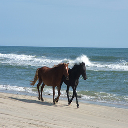

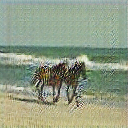

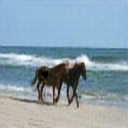

epoch: 144/5000, batch: 100/1067, GA2B_loss: 2.295985698699951, GB2A_loss: 2.293210506439209
                             DA_loss: 9.644630836191936e-07, DB_loss: 0.013383371755480766, CYC_loss: 0.2591972351074219
epoch: 144/5000, batch: 200/1067, GA2B_loss: 2.031250476837158, GB2A_loss: 2.031245231628418
                             DA_loss: 1.263662507966501e-10, DB_loss: 2.2017661305273606e-10, CYC_loss: 0.20625026524066925
epoch: 144/5000, batch: 300/1067, GA2B_loss: 1.99262535572052, GB2A_loss: 1.99262535572052
                             DA_loss: 4.547473508864641e-11, DB_loss: 2.3910578739408874e-17, CYC_loss: 0.198525071144104
epoch: 144/5000, batch: 400/1067, GA2B_loss: 2.347019672393799, GB2A_loss: 2.3470072746276855
                             DA_loss: 2.189453306156164e-11, DB_loss: 1.219362527615786e-10, CYC_loss: 0.26940393447875977
epoch: 144/5000, batch: 500/1067, GA2B_loss: 1.8821492195129395, GB2A_loss: 1.8821485042572021
                             DA_loss: 2.8749

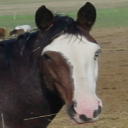

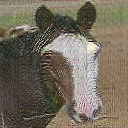

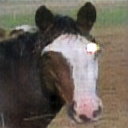

epoch: 145/5000, batch: 100/1067, GA2B_loss: 2.1189351081848145, GB2A_loss: 2.1186881065368652
                             DA_loss: 5.452045002130035e-07, DB_loss: 9.178544426238777e-13, CYC_loss: 0.22378748655319214
epoch: 145/5000, batch: 200/1067, GA2B_loss: 2.2197346687316895, GB2A_loss: 2.2202401161193848
                             DA_loss: 5.547057298826985e-06, DB_loss: 3.458311326198782e-08, CYC_loss: 0.24405212700366974
epoch: 145/5000, batch: 300/1067, GA2B_loss: 1.3274986743927002, GB2A_loss: 2.327305316925049
                             DA_loss: 1.2526811588031705e-07, DB_loss: 0.4891778826713562, CYC_loss: 0.2654760479927063
epoch: 145/5000, batch: 400/1067, GA2B_loss: 1.9930977821350098, GB2A_loss: 1.9990794658660889
                             DA_loss: 1.1603162007600698e-11, DB_loss: 4.752971108246129e-06, CYC_loss: 0.1998174786567688
epoch: 145/5000, batch: 500/1067, GA2B_loss: 2.4674487113952637, GB2A_loss: 2.4673709869384766
                             DA_loss:

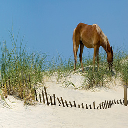

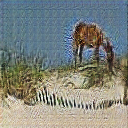

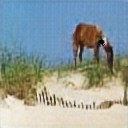

epoch: 146/5000, batch: 100/1067, GA2B_loss: 2.0723671913146973, GB2A_loss: 2.072324275970459
                             DA_loss: 2.2980822800278133e-10, DB_loss: 3.0020430585864233e-09, CYC_loss: 0.2144734114408493
epoch: 146/5000, batch: 200/1067, GA2B_loss: 2.172146797180176, GB2A_loss: 2.171567440032959
                             DA_loss: 4.195336344992029e-08, DB_loss: 1.4839613982076116e-09, CYC_loss: 0.23442932963371277
epoch: 146/5000, batch: 300/1067, GA2B_loss: 2.301480770111084, GB2A_loss: 2.2987818717956543
                             DA_loss: 9.244361649507482e-07, DB_loss: 3.5584046560038773e-12, CYC_loss: 0.2602972388267517
epoch: 146/5000, batch: 400/1067, GA2B_loss: 2.214371681213379, GB2A_loss: 2.16412353515625
                             DA_loss: 0.000323796906741336, DB_loss: 2.5239614842575975e-09, CYC_loss: 0.24287430942058563
epoch: 146/5000, batch: 500/1067, GA2B_loss: 2.437842845916748, GB2A_loss: 2.437680721282959
                             DA_loss: 4.

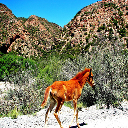

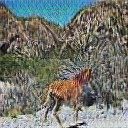

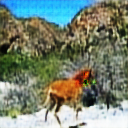

epoch: 147/5000, batch: 100/1067, GA2B_loss: 1.8314727544784546, GB2A_loss: 1.8314787149429321
                             DA_loss: 1.231826383255434e-16, DB_loss: 4.5136351253805e-12, CYC_loss: 0.16629573702812195
epoch: 147/5000, batch: 200/1067, GA2B_loss: 2.0001702308654785, GB2A_loss: 2.0000619888305664
                             DA_loss: 1.9868963363478542e-08, DB_loss: 7.813078889332459e-17, CYC_loss: 0.200034037232399
epoch: 147/5000, batch: 300/1067, GA2B_loss: 2.2677536010742188, GB2A_loss: 2.2677505016326904
                             DA_loss: 1.2877126665325478e-12, DB_loss: 3.4843699106557047e-13, CYC_loss: 0.2535507380962372
epoch: 147/5000, batch: 400/1067, GA2B_loss: 1.961341381072998, GB2A_loss: 1.9613412618637085
                             DA_loss: 1.3137945176211474e-09, DB_loss: 2.4846968926794943e-10, CYC_loss: 0.1922682821750641
epoch: 147/5000, batch: 500/1067, GA2B_loss: 1.7396349906921387, GB2A_loss: 1.7396175861358643
                             DA_los

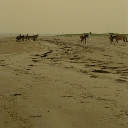

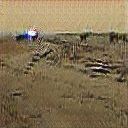

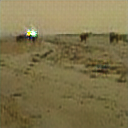

epoch: 148/5000, batch: 100/1067, GA2B_loss: 1.7914621829986572, GB2A_loss: 1.7914599180221558
                             DA_loss: 3.4232868276196093e-12, DB_loss: 1.5584766970277997e-06, CYC_loss: 0.1582925021648407
epoch: 148/5000, batch: 200/1067, GA2B_loss: 1.850369930267334, GB2A_loss: 1.8503682613372803
                             DA_loss: 2.8550829777630737e-13, DB_loss: 1.7621744063944789e-09, CYC_loss: 0.1700739711523056
epoch: 148/5000, batch: 300/1067, GA2B_loss: 1.9516668319702148, GB2A_loss: 1.9515764713287354
                             DA_loss: 1.019641593380527e-09, DB_loss: 2.6439295197633328e-11, CYC_loss: 0.19033335149288177
epoch: 148/5000, batch: 400/1067, GA2B_loss: 2.0903725624084473, GB2A_loss: 2.0903725624084473
                             DA_loss: 7.068277341204521e-08, DB_loss: 3.439251487769024e-12, CYC_loss: 0.2180745005607605
epoch: 148/5000, batch: 500/1067, GA2B_loss: 1.8025387525558472, GB2A_loss: 1.802538514137268
                             DA_l

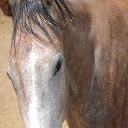

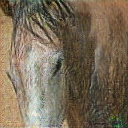

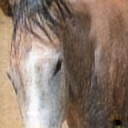

epoch: 149/5000, batch: 100/1067, GA2B_loss: 2.0373408794403076, GB2A_loss: 2.0373406410217285
                             DA_loss: 0.0005772477015852928, DB_loss: 3.541384785421542e-08, CYC_loss: 0.207468181848526
epoch: 149/5000, batch: 200/1067, GA2B_loss: 2.0963966846466064, GB2A_loss: 2.085216522216797
                             DA_loss: 1.8835899027180858e-05, DB_loss: 3.9968028886505635e-11, CYC_loss: 0.21927934885025024
epoch: 149/5000, batch: 300/1067, GA2B_loss: 2.148146152496338, GB2A_loss: 2.148146152496338
                             DA_loss: 1.0007953505919431e-06, DB_loss: 8.598142814050802e-13, CYC_loss: 0.22962921857833862
epoch: 149/5000, batch: 400/1067, GA2B_loss: 2.266406536102295, GB2A_loss: 2.2653894424438477
                             DA_loss: 1.2933729465203214e-07, DB_loss: 2.0713575302728175e-17, CYC_loss: 0.25328129529953003
epoch: 149/5000, batch: 500/1067, GA2B_loss: 1.7823119163513184, GB2A_loss: 1.7823114395141602
                             DA_lo

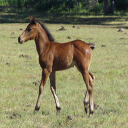

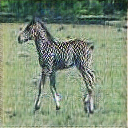

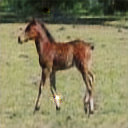

epoch: 150/5000, batch: 100/1067, GA2B_loss: 1.8950788974761963, GB2A_loss: 1.8950788974761963
                             DA_loss: 3.1467387727831484e-19, DB_loss: 5.610516495835327e-10, CYC_loss: 0.17901578545570374
epoch: 150/5000, batch: 200/1067, GA2B_loss: 1.8133434057235718, GB2A_loss: 1.8133149147033691
                             DA_loss: 1.0827201635255079e-10, DB_loss: 1.192930845252127e-13, CYC_loss: 0.1626688688993454
epoch: 150/5000, batch: 300/1067, GA2B_loss: 2.1260673999786377, GB2A_loss: 2.126067876815796
                             DA_loss: 6.394884621840902e-12, DB_loss: 1.0234978142786844e-10, CYC_loss: 0.22521358728408813
epoch: 150/5000, batch: 400/1067, GA2B_loss: 2.1980326175689697, GB2A_loss: 2.198054075241089
                             DA_loss: 1.8190061002593128e-12, DB_loss: 5.7720491580814937e-11, CYC_loss: 0.23961082100868225
epoch: 150/5000, batch: 500/1067, GA2B_loss: 2.0514161586761475, GB2A_loss: 2.051851511001587
                             DA_

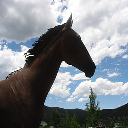

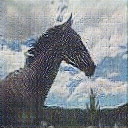

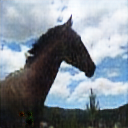

epoch: 151/5000, batch: 100/1067, GA2B_loss: 2.089299440383911, GB2A_loss: 2.089299201965332
                             DA_loss: 2.0942811270314955e-15, DB_loss: 2.565059926615265e-12, CYC_loss: 0.2178598940372467
epoch: 151/5000, batch: 200/1067, GA2B_loss: 2.007230281829834, GB2A_loss: 2.007227659225464
                             DA_loss: 2.752690436702565e-12, DB_loss: 0.0048549845814704895, CYC_loss: 0.20144641399383545
epoch: 151/5000, batch: 300/1067, GA2B_loss: 2.5382161140441895, GB2A_loss: 2.5382161140441895
                             DA_loss: 1.333617660748132e-10, DB_loss: 8.600472764519473e-13, CYC_loss: 0.30764323472976685
epoch: 151/5000, batch: 400/1067, GA2B_loss: 1.7834084033966064, GB2A_loss: 1.7834081649780273
                             DA_loss: 1.004546223981606e-09, DB_loss: 4.547473508864641e-13, CYC_loss: 0.15668168663978577
epoch: 151/5000, batch: 500/1067, GA2B_loss: 1.88105309009552, GB2A_loss: 1.88105309009552
                             DA_loss: 5.1

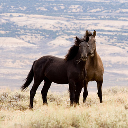

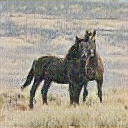

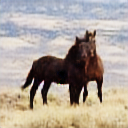

epoch: 152/5000, batch: 100/1067, GA2B_loss: 1.955688238143921, GB2A_loss: 1.955688238143921
                             DA_loss: 3.6291680771682877e-10, DB_loss: 1.1038655286780643e-23, CYC_loss: 0.1911376416683197
epoch: 152/5000, batch: 200/1067, GA2B_loss: 2.1460764408111572, GB2A_loss: 2.146024227142334
                             DA_loss: 3.5894351380072465e-10, DB_loss: 2.276649979648937e-10, CYC_loss: 0.22921527922153473
epoch: 152/5000, batch: 300/1067, GA2B_loss: 1.9526755809783936, GB2A_loss: 1.9526729583740234
                             DA_loss: 9.105930232067294e-09, DB_loss: 2.442474169583875e-07, CYC_loss: 0.19053512811660767
epoch: 152/5000, batch: 400/1067, GA2B_loss: 1.7135156393051147, GB2A_loss: 1.7135083675384521
                             DA_loss: 6.777070224450732e-12, DB_loss: 4.895130828463934e-11, CYC_loss: 0.14270314574241638
epoch: 152/5000, batch: 500/1067, GA2B_loss: 2.0669727325439453, GB2A_loss: 2.0669727325439453
                             DA_lo

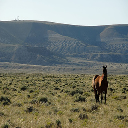

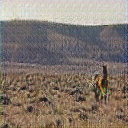

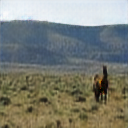

epoch: 153/5000, batch: 100/1067, GA2B_loss: 2.3094916343688965, GB2A_loss: 2.3099522590637207
                             DA_loss: 1.3467704729208663e-10, DB_loss: 3.040147689148398e-08, CYC_loss: 0.26199692487716675
epoch: 153/5000, batch: 200/1067, GA2B_loss: 1.9782192707061768, GB2A_loss: 1.9750105142593384
                             DA_loss: 1.2892159020339022e-06, DB_loss: 5.341072917275369e-09, CYC_loss: 0.19564388692378998
epoch: 153/5000, batch: 300/1067, GA2B_loss: 2.015779495239258, GB2A_loss: 2.0162315368652344
                             DA_loss: 1.8546031377297822e-10, DB_loss: 3.116917568490862e-08, CYC_loss: 0.20325401425361633
epoch: 153/5000, batch: 400/1067, GA2B_loss: 2.642012119293213, GB2A_loss: 2.6420130729675293
                             DA_loss: 6.231316990484468e-16, DB_loss: 7.876104689231653e-14, CYC_loss: 0.3284026086330414
epoch: 153/5000, batch: 500/1067, GA2B_loss: 2.051164150238037, GB2A_loss: 2.050680160522461
                             DA_los

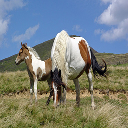

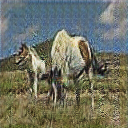

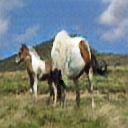

epoch: 154/5000, batch: 100/1067, GA2B_loss: 1.9824987649917603, GB2A_loss: 1.9824488162994385
                             DA_loss: 3.139718762756871e-10, DB_loss: 5.704351213609016e-09, CYC_loss: 0.1964997798204422
epoch: 154/5000, batch: 200/1067, GA2B_loss: 2.6206750869750977, GB2A_loss: 2.6206741333007812
                             DA_loss: 7.186251038682201e-10, DB_loss: 5.179909452757148e-12, CYC_loss: 0.3241350054740906
epoch: 154/5000, batch: 300/1067, GA2B_loss: 1.9969240427017212, GB2A_loss: 1.9969459772109985
                             DA_loss: 9.080605711808687e-11, DB_loss: 3.184041363901713e-10, CYC_loss: 0.19938936829566956
epoch: 154/5000, batch: 400/1067, GA2B_loss: 1.8957273960113525, GB2A_loss: 1.895724892616272
                             DA_loss: 1.487546305752041e-12, DB_loss: 9.133238449976488e-07, CYC_loss: 0.17914548516273499
epoch: 154/5000, batch: 500/1067, GA2B_loss: 2.2183008193969727, GB2A_loss: 2.218283176422119
                             DA_loss:

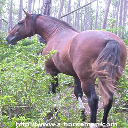

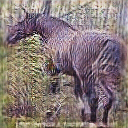

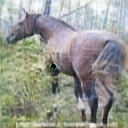

epoch: 155/5000, batch: 100/1067, GA2B_loss: 1.937111258506775, GB2A_loss: 1.9128427505493164
                             DA_loss: 7.452760473825037e-05, DB_loss: 6.309912592428191e-10, CYC_loss: 0.1874222755432129
epoch: 155/5000, batch: 200/1067, GA2B_loss: 2.30886173248291, GB2A_loss: 2.3087310791015625
                             DA_loss: 2.5047979246295426e-09, DB_loss: 1.8643837061222492e-16, CYC_loss: 0.26177236437797546
epoch: 155/5000, batch: 300/1067, GA2B_loss: 2.033390522003174, GB2A_loss: 2.0333805084228516
                             DA_loss: 1.2479598951453674e-11, DB_loss: 6.395232867578704e-12, CYC_loss: 0.2066780924797058
epoch: 155/5000, batch: 400/1067, GA2B_loss: 2.2450852394104004, GB2A_loss: 2.244610548019409
                             DA_loss: 0.00013422449410427362, DB_loss: 0.00017857302736956626, CYC_loss: 0.24901703000068665
epoch: 155/5000, batch: 500/1067, GA2B_loss: 2.4627485275268555, GB2A_loss: 2.4627485275268555
                             DA_los

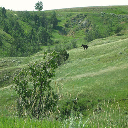

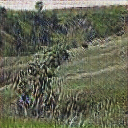

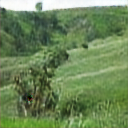

epoch: 156/5000, batch: 100/1067, GA2B_loss: 2.1043291091918945, GB2A_loss: 2.1043286323547363
                             DA_loss: 6.046323787782179e-14, DB_loss: 7.716721484030131e-08, CYC_loss: 0.22086584568023682
epoch: 156/5000, batch: 200/1067, GA2B_loss: 1.8848795890808105, GB2A_loss: 1.8848798274993896
                             DA_loss: 9.329228873866668e-07, DB_loss: 4.70833089313491e-14, CYC_loss: 0.17697598040103912
epoch: 156/5000, batch: 300/1067, GA2B_loss: 1.8336961269378662, GB2A_loss: 1.8336955308914185
                             DA_loss: 8.748434268679439e-12, DB_loss: 3.0280681059188595e-21, CYC_loss: 0.16673922538757324
epoch: 156/5000, batch: 400/1067, GA2B_loss: 1.6752607822418213, GB2A_loss: 1.675279974937439
                             DA_loss: 6.395975600276965e-14, DB_loss: 4.739602113557062e-11, CYC_loss: 0.13505598902702332
epoch: 156/5000, batch: 500/1067, GA2B_loss: 2.3473153114318848, GB2A_loss: 2.3473188877105713
                             DA_lo

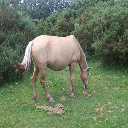

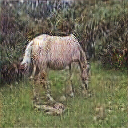

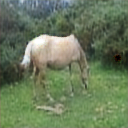

epoch: 157/5000, batch: 100/1067, GA2B_loss: 1.8282274007797241, GB2A_loss: 1.8282278776168823
                             DA_loss: 1.0450195659288891e-22, DB_loss: 5.380420414757836e-11, CYC_loss: 0.165645569562912
epoch: 157/5000, batch: 200/1067, GA2B_loss: 2.3379228115081787, GB2A_loss: 2.337728500366211
                             DA_loss: 1.7592955146028544e-06, DB_loss: 9.778242451852215e-12, CYC_loss: 0.2675860822200775
epoch: 157/5000, batch: 300/1067, GA2B_loss: 2.3143744468688965, GB2A_loss: 2.314380168914795
                             DA_loss: 1.839546570625572e-11, DB_loss: 1.6557180973486574e-11, CYC_loss: 0.2628772258758545
epoch: 157/5000, batch: 400/1067, GA2B_loss: 1.8639267683029175, GB2A_loss: 1.8639192581176758
                             DA_loss: 2.3016143657628163e-08, DB_loss: 6.711854133934002e-16, CYC_loss: 0.17278537154197693
epoch: 157/5000, batch: 500/1067, GA2B_loss: 2.130789279937744, GB2A_loss: 2.1307735443115234
                             DA_loss

In [0]:
for epoch in range(num_epochs):
  
    # Train epoch
    for n_batch, (real_samplesA, real_samplesB) in enumerate(data_loader_train):

        # Prepare batch data
        real_samplesA = Variable(real_samplesA).cuda()
        real_samplesB = Variable(real_samplesB).cuda()

        # Update model weights
        loss_gA2B, loss_gB2A, loss_dA, loss_dB, loss_cyc = model.step_optimization(real_samplesA, real_samplesB, lambda_cyc)
        
        # Show current loss
        if (n_batch) % 100 == 0:
            print(f"epoch: {epoch+1}/{num_epochs}, batch: {n_batch}/{len(data_loader_train)}, GA2B_loss: {loss_gA2B}, GB2A_loss: {loss_gB2A}")
            print(f"                             DA_loss: {loss_dA}, DB_loss: {loss_dB}, CYC_loss: {loss_cyc}")    
          
        # Show fake samples
        if n_batch == 10:
            fake_samplesA = model._generatorA2B(real_samplesA)
            fake_samplesB = model._generatorB2A(fake_samplesA)
            display_batch_images(real_samplesA)
            display_batch_images(fake_samplesA.detach())
            display_batch_images(fake_samplesB.detach())
